<a href="https://colab.research.google.com/github/steliosg23/PDS-A3/blob/main/PDS_A3_f3352410_Giagkos_Stylianos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

---
#MSc Practical Data Science
#Assignment 3
##Giagkos Stylianos f3352410
---

---
#Part 2: Data Mining
---

# 1. Data Acquisition and Preprocessing:

## Overview of the "GSV Cities" Dataset and Preprocessing

This notebook explores the **"GSV Cities"** dataset, focusing on its acquisition, exploration, image analysis, and preprocessing steps for further analysis.

### Dataset Overview:
- **Data Source**: The dataset is sourced from Kaggle, containing images and metadata for various cities.
- **Metadata**: Includes information such as `place_id`, `year`, `month`, `northdeg`, `city_id`, `lat`, `lon`, and `panoid`.
- **Images**: Each city folder contains images representing different geographical areas within the city.

### Key Steps in the Process:
1. **Downloading the Dataset**:
   The dataset is downloaded using the Kaggle API and stored in a specified directory.

2. **Exploring the Dataset**:
   - We explore the structure of the dataset by listing directories and files.
   - The dataset includes CSV files for metadata and image files stored in separate city folders.
   - We inspect the number of rows (images) and check for missing values across all city datasets.

3. **Image Count per City**:
   - The number of images per city is calculated and visualized using a horizontal bar chart.
   - Cities like **London**, **Miami**, and **Phoenix** have the highest image counts, while cities like **Medellin** and **Buenos Aires** have fewer images.

4. **Sampling Images**:
   - Random samples of images are selected for each city, ensuring the dataset fits within memory limits.
   - The sampled images are stored on Google Drive, and metadata is saved in a pickle file for future use.

5. **Merging DataFrames**:
   - All individual city DataFrames are merged into a single consolidated DataFrame for analysis.
   - The merged dataset is saved as a CSV file.

6. **Removing Duplicates**:
   - Duplicate metadata rows and corresponding images are identified and removed.
   - The cleaned metadata and image files are stored and saved for further analysis.

7. **Preprocessing Images for K-means**:
   - Images are preprocessed by resizing to a consistent shape (512x512), converting to RGB color space, and normalizing pixel values.
   - This ensures the images are in a suitable format for clustering algorithms like K-means.

### Key Insights:
- **Image Distribution**: Some cities have significantly more images (e.g., London with 58,672 images) than others (e.g., Medellin with 6,024 images).
- **Data Quality**: All datasets are clean, with no missing values found in any city’s metadata.
- **Sampling Strategy**: Images from each city are randomly sampled to create a manageable dataset that fits into memory.

### Final Dataset:
- After preprocessing and removing duplicates, the cleaned dataset, containing only unique image paths and metadata, is saved for further analysis.

### Final Step: Load and Inspect Cleaned Dataset
The cleaned dataset is loaded from a pickle file and displayed for verification.


####Downloading the "GSV Cities" Dataset

In [ ]:
import kagglehub

# Download the latest version of the dataset
path = kagglehub.dataset_download("amaralibey/gsv-cities")

print("Path to dataset files:", path)


100%|██████████| 21.8G/21.8G [03:05<00:00, 126MB/s] 

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/amaralibey/gsv-cities/versions/1


####Exploring the Dataset

In [ ]:
import os
import pickle
import random
import pandas as pd
# Step 2: Explore the dataset structure (only directories)
dataset_dir = path  # Directory where the dataset is stored
print("Listing folders in dataset directory:")
for root, dirs, files in os.walk(dataset_dir):
    for dir in dirs:
        print(f"Folder: {os.path.join(root, dir)}")


Listing folders in dataset directory:
Folder: /root/.cache/kagglehub/datasets/amaralibey/gsv-cities/versions/1/Images
Folder: /root/.cache/kagglehub/datasets/amaralibey/gsv-cities/versions/1/Dataframes
Folder: /root/.cache/kagglehub/datasets/amaralibey/gsv-cities/versions/1/Images/Minneapolis
Folder: /root/.cache/kagglehub/datasets/amaralibey/gsv-cities/versions/1/Images/PRG
Folder: /root/.cache/kagglehub/datasets/amaralibey/gsv-cities/versions/1/Images/LosAngeles
Folder: /root/.cache/kagglehub/datasets/amaralibey/gsv-cities/versions/1/Images/WashingtonDC
Folder: /root/.cache/kagglehub/datasets/amaralibey/gsv-cities/versions/1/Images/Osaka
Folder: /root/.cache/kagglehub/datasets/amaralibey/gsv-cities/versions/1/Images/London
Folder: /root/.cache/kagglehub/datasets/amaralibey/gsv-cities/versions/1/Images/Madrid
Folder: /root/.cache/kagglehub/datasets/amaralibey/gsv-cities/versions/1/Images/OSL
Folder: /root/.cache/kagglehub/datasets/amaralibey/gsv-cities/versions/1/Images/BuenosAires
Fo

###Explore the Files in the 'Dataframes' Folder

In [ ]:
# List all files inside the 'Dataframes' folder
dataframes_path = os.path.join(path, 'Dataframes')
dataframe_files = os.listdir(dataframes_path)
print("Files in the 'Dataframes' folder:", dataframe_files)

Files in the 'Dataframes' folder: ['PRG.csv', 'Boston.csv', 'OSL.csv', 'TRT.csv', 'Miami.csv', 'Lisbon.csv', 'Brussels.csv', 'Madrid.csv', 'Barcelona.csv', 'Melbourne.csv', 'PRS.csv', 'Phoenix.csv', 'Bangkok.csv', 'Minneapolis.csv', 'Rome.csv', 'BuenosAires.csv', 'LosAngeles.csv', 'London.csv', 'Chicago.csv', 'MexicoCity.csv', 'Osaka.csv', 'WashingtonDC.csv', 'Medellin.csv']


###Load and Explore DataFrames

In [ ]:
# Function to explore and load data from CSV files
def explore_and_load_data():
    dataframes = []
    dataset_info = []

    for csv_file in dataframe_files:
        csv_path = os.path.join(dataframes_path, csv_file)
        df = pd.read_csv(csv_path)
        dataset_info.append((csv_file, len(df), df))

    dataset_info.sort(key=lambda x: x[1], reverse=True)

    print("Sorted Datasets by Row Count:")
    for csv_file, row_count, df in dataset_info:
        print(f"\nCity: {csv_file.split('.')[0]}")
        print(f"\nExploring {csv_file} file:\n")
        print(df.head())
        print(f"\nTotal rows in {csv_file}: {row_count}")
        print(f"\nMissing values in {csv_file}:\n")
        print(df.isnull().sum())
        dataframes.append(df)

    return dataframes, dataset_info

# Get dataset info and dataframes
dataframes, dataset_info = explore_and_load_data()

Sorted Datasets by Row Count:

City: London

Exploring London.csv file:

   place_id  year  month  northdeg city_id        lat       lon  \
0      5419  2018      1       128  London  51.512060 -0.116798   
1      2974  2014      5       202  London  51.500379 -0.115073   
2      2635  2019      7       330  London  51.498907 -0.148466   
3      2342  2015     10       111  London  51.497299 -0.154059   
4        46  2020      8       215  London  51.485768 -0.148259   

                   panoid  
0  EMZTM4_GiqSm0g-dHFZ-dQ  
1  7-0Bl--2CEhSedOHRDsqsA  
2  efZzdOFwFegpirLMsZlfVA  
3  DI93cUvb6E01AqC623xS7w  
4  PR2eYfQ06sL_7wIz-f6nPg  

Total rows in London.csv: 58672

Missing values in London.csv:

place_id    0
year        0
month       0
northdeg    0
city_id     0
lat         0
lon         0
panoid      0
dtype: int64

City: Miami

Exploring Miami.csv file:

   place_id  year  month  northdeg city_id        lat        lon  \
0      4528  2019      2       120   Miami  25.766782 -80

###Explore the Files in the 'Images' Folder

In [ ]:
import os
from PIL import Image
import random
import IPython.display as display
# List all files inside the 'Images' folder
images_path = os.path.join(path, 'Images')
image_folders = os.listdir(images_path)
print("Files in the 'Images' folder:", image_folders)

Files in the 'Images' folder: ['Minneapolis', 'PRG', 'LosAngeles', 'WashingtonDC', 'Osaka', 'London', 'Madrid', 'OSL', 'BuenosAires', 'Phoenix', 'TRT', 'Barcelona', 'Medellin', 'Lisbon', 'Rome', 'Miami', 'Bangkok', 'Chicago', 'Boston', 'Melbourne', 'Brussels', 'MexicoCity', 'PRS']


###Count Photos for Each City:

In [ ]:
# Initialize a dictionary to store the count of images for each city
image_count = {}

# Iterate through each city in the 'Images' folder
for city in image_folders:
    city_images_folder = os.path.join(images_path, city)

    # List all files in the city's folder
    image_files = os.listdir(city_images_folder)

    # Filter out non-image files (if necessary) and count the number of images
    image_files = [file for file in image_files if file.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif'))]

    # Store the count in the dictionary
    image_count[city] = len(image_files)

# Display the count of images for each city
print("Image count per city:")
for city, count in image_count.items():
    print(f"{city}: {count} images")


Image count per city:
Minneapolis: 22326 images
PRG: 17590 images
LosAngeles: 8891 images
WashingtonDC: 11545 images
Osaka: 22605 images
London: 58672 images
Madrid: 14554 images
OSL: 9756 images
BuenosAires: 8481 images
Phoenix: 36251 images
TRT: 17712 images
Barcelona: 15894 images
Medellin: 6024 images
Lisbon: 27045 images
Rome: 24068 images
Miami: 43637 images
Bangkok: 22271 images
Chicago: 34091 images
Boston: 32616 images
Melbourne: 28542 images
Brussels: 14171 images
MexicoCity: 12801 images
PRS: 39963 images


The bar chart shows the number of images available for various cities, with the cities listed along the y-axis and the number of images on the x-axis. **London** has the highest image count at **58,672**, followed by **Miami** with **43,637** and **PRS** with **39,963** images. Other cities, such as **Phoenix**, **Chicago**, and **Boston**, also have a significant number of images, ranging from around **32,000** to **36,000**. The cities with the lowest image counts include **Buenos Aires** and **Medellin**, with approximately **8,400** and **6,000** images, respectively. This visualization provides an overview of the image distribution across different cities, highlighting the variation in image counts.


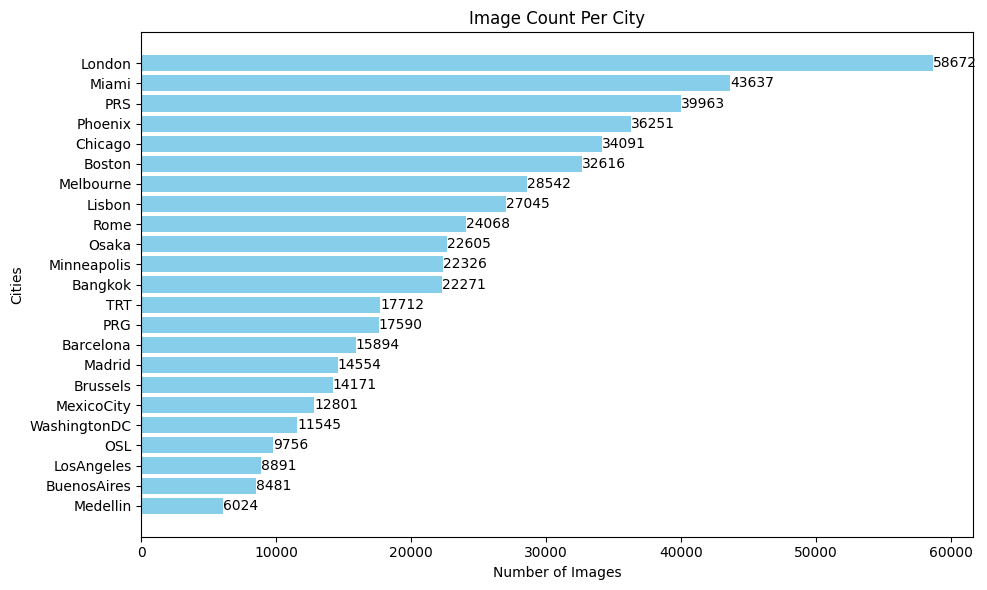

In [ ]:
import matplotlib.pyplot as plt

# Data for the plot
cities = list(image_count.keys())
counts = list(image_count.values())

# Sort data for better visualization
sorted_data = sorted(zip(counts, cities))
counts, cities = zip(*sorted_data)

# Plotting the horizontal bar chart
plt.figure(figsize=(10, 6))
bars = plt.barh(cities, counts, color='skyblue')
plt.xlabel('Number of Images')
plt.ylabel('Cities')
plt.title('Image Count Per City')

# Adding value labels
for bar in bars:
    plt.text(bar.get_width() + 1, bar.get_y() + bar.get_height()/2, str(bar.get_width()), va='center')

plt.tight_layout()
plt.show()

In [ ]:
import os
import random
from PIL import Image
from IPython import display

# Step 2: Display sample images from each city
def display_sample_images():
    # Number of images to display per city
    images_to_display = 1

    for city in os.listdir(images_path):
        city_images_folder = os.path.join(images_path, city)
        image_files = os.listdir(city_images_folder)

        # Randomly select a few images to display
        sampled_image_files = random.sample(image_files, min(images_to_display, len(image_files)))

        # Display the images
        print(f"\nDisplaying sample images for {city}:")
        for image_file in sampled_image_files:
            image_path = os.path.join(city_images_folder, image_file)
            print(f"Image name: {image_file}")  # Print the image file name
            img = Image.open(image_path)  # Open the image
            display.display(img)  # Display the image inline

# Execute the image display function
display_sample_images()


The dataset consists of images from various cities, with each city having a **different number of images** and **different number of dimensions** . Below is an overview of the structure and insights derived from the data:

### Dataset Structure:
Each city has a corresponding CSV file, containing metadata for images taken at various locations in that city. The data columns include:

- **place_id**: Unique identifier for each place.
- **year**: The year the image was taken.
- **month**: The month the image was taken.
- **northdeg**: A value potentially indicating the geographic position of the image.
- **city_id**: The name of the city (e.g., London, Miami).
- **lat** and **lon**: Latitude and longitude coordinates of the image location.
- **panoid**: Unique image identifier (likely referring to panoramic views).

Each dataset has been explored and sorted by row count, with the total number of rows for each city (number of images) listed. The total rows in each file are provided along with the missing value check, confirming that there are no missing values across any columns in any city dataset.

### Key Insights:
- **London** has the largest dataset with **58,672 images**, followed by **Miami** with **43,637 images** and **Phoenix** with **36,251 images**.
- Smaller datasets include **Medellin** with **6,024 images** and **Buenos Aires** with **8,481 images**, indicating an imbalance across cities.
- Other cities with notable image counts include **PRG (17,590 images)**, **Chicago (34,091 images)**, and **Osaka (22,605 images)**.
- Despite the differences in image count, all datasets have complete data, with no missing values in any of the columns.

### Plan:
- **Choose randomly images per city to create a dataset that will fit in the memory.**


## Data Merging and Saving Process for Dataframes

#### Merging the DataFrames
We begin by merging all the individual DataFrames, each corresponding to a city's dataset, into a single, consolidated DataFrame using the `concat()` function from pandas. This ensures that all the city-specific metadata is combined into one dataset for further analysis.


In [ ]:
from google.colab import drive
import pandas as pd

# Mount Google Drive to access the specified path
drive.mount('/content/drive')

# Merge all dataframes
merged_gsv_cities_df = pd.concat(dataframes, ignore_index=True)

# Specify the path where the merged file will be saved
output_path = '/content/drive/My Drive/merged_gsv_cities.csv'

# Save the merged dataframe as a new CSV file
merged_gsv_cities_df.to_csv(output_path, index=False)

print(f"Data merged and saved to {output_path}")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Data merged and saved to /content/drive/My Drive/merged_gsv_cities.csv


In [ ]:
merged_gsv_cities_df


,place_id,year,month,northdeg,city_id,lat,lon,panoid
0,5419,2018,1,128,London,51.512060,-0.116798,EMZTM4_GiqSm0g-dHFZ-dQ
1,2974,2014,5,202,London,51.500379,-0.115073,7-0Bl--2CEhSedOHRDsqsA
2,2635,2019,7,330,London,51.498907,-0.148466,efZzdOFwFegpirLMsZlfVA
3,2342,2015,10,111,London,51.497299,-0.154059,DI93cUvb6E01AqC623xS7w
4,46,2020,8,215,London,51.485768,-0.148259,PR2eYfQ06sL_7wIz-f6nPg
...,...,...,...,...,...,...,...,...
529501,121,2016,3,50,Medellin,6.232940,-75.593688,AT5jIwkA8UnMqJ1_oWLLwA
529502,803,2017,7,346,Medellin,6.245971,-75.599899,rlYO3OVppXZhJna7Gxo8tw
529503,597,2016,4,289,Medellin,6.241864,-75.594655,lQXorlN7WpoxuBO8ZBkJmA
529504,69,2019,6,505,Medellin,6.232298,-75.592430,m90gVrCWUG2MCznGxggp1w


## Random Sampling of Images and Saving Corresponding Data


In [ ]:
#  Import necessary libraries
import os
import random
import pickle
import pandas as pd
import shutil
from google.colab import drive


## Mount Google Drive to access the folder
#### This step ensures that your Google Drive is mounted for saving the sampled images and metadata


In [ ]:
#  Mount Google Drive
drive.mount('/content/drive', force_remount=True)


Mounted at /content/drive


## Define the function to get the image name from the dataframe row
#### This function constructs the image filename based on the metadata from the DataFrame.


In [ ]:
#  Define get_img_name function
def get_img_name(row):
    '''Given a row from the dataframe, return the corresponding image name'''
    city = row['city_id']
    place_id = row.name % 10**5  # Place ID is derived from the row index
    place_id = str(place_id).zfill(7)
    panoid = row['panoid']
    year = str(row['year']).zfill(4)
    month = str(row['month']).zfill(2)
    northdeg = str(row['northdeg']).zfill(3)
    lat, lon = str(row['lat']), str(row['lon'])

    # Construct the image filename
    name = f"{city}_{place_id}_{year}_{month}_{northdeg}_{lat}_{lon}_{panoid}.jpg"
    return name


## Define the function for sampling images and saving metadata with added seed and samples per city parameter
#### The function is responsible for sampling images and saving them to Google Drive.
#### Added optional parameters: `seed` for reproducibility and `samples_per_city` for the number of samples to take per city.


In [ ]:
import os
import random
import shutil

# Define sample_images_and_metadata function
def sample_images_and_metadata(df, images_path, samples_per_city=2, output_images_path='/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_Dataset_Images', seed=None):
    # Set seed for reproducibility
    if seed is not None:
        random.seed(seed)

    # Ensure the output directory exists, create if not
    if not os.path.exists(output_images_path):
        os.makedirs(output_images_path)

    sampled_images_metadata = []  # List to store metadata for sampled images
    existing_image_names = set()  # Set to keep track of existing image names

    # Iterate through each city in the images folder
    for city in os.listdir(images_path):
        city_images_folder = os.path.join(images_path, city)
        if not os.path.isdir(city_images_folder):
            continue

        # List all image files in the city's folder
        image_files = os.listdir(city_images_folder)
        image_files = [file for file in image_files if file.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif'))]

        # If there are no images or no matching metadata for this city, skip the city
        if len(image_files) == 0 or city not in df['city_id'].values:
            continue

        # Filter metadata for the current city
        image_metadata = df[df['city_id'] == city]

        # If the number of images is less than samples_per_city, sample all images
        if len(image_files) < samples_per_city:
            sampled_image_files = image_files
        else:
            # Randomly sample a specified number of images per city
            sampled_image_files = random.sample(image_files, samples_per_city)

        for image_file in sampled_image_files:
            # Ensure that the metadata for each image is unique by using .iloc for the sampled image
            image_row = image_metadata.sample(n=1).iloc[0]  # Sample a single row of metadata for the image

            # Get the real image name from the metadata
            real_image_name = get_img_name(image_row)

            # Check if the image name already exists
            if real_image_name in existing_image_names:
                continue  # Skip this image if it's a duplicate

            # Add the real image name to the set of existing image names
            existing_image_names.add(real_image_name)

            image_path = os.path.join(city_images_folder, image_file)

            # Copy the image to the Google Drive folder
            destination_path = os.path.join(output_images_path, real_image_name)
            shutil.copy(image_path, destination_path)

            # Add the real image name and image path to the metadata
            image_row['image_name'] = real_image_name
            image_row['image_path'] = destination_path  # Store the full path where the image is saved
            sampled_images_metadata.append(image_row)



    # Return the list of metadata with image names and paths
    return sampled_images_metadata


## Perform the sampling and store the data
#### Define `merged_gsv_cities_df` and `images_path` before running the function.
#### Specify `samples_per_city` and `seed` for reproducibility and the number of samples per city.


In [ ]:
# Sample images and save metadata
seed_value = 23  # Specify the seed for reproducibility
samples_per_city = 500 # Specify the number of images to sample per city

# Perform the sampling and store the data
sampled_images_metadata = sample_images_and_metadata(merged_gsv_cities_df, images_path, samples_per_city, seed=seed_value)

# Create a DataFrame for the sampled metadata including image names and paths
sampled_df = pd.DataFrame(sampled_images_metadata)


In [ ]:
import os

images_dir = '/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_Dataset_Images'

# Count the number of image files in the directory
image_files = [f for f in os.listdir(images_dir) if f.lower().endswith(('png', 'jpg', 'jpeg', 'gif', 'bmp', 'tiff'))]

num_images = len(image_files)
print(f"Number of images: {num_images}")


Number of images: 11309


## Save the sampled images and metadata to a pickle file
#### Save the metadata and image paths into a pickle file on Google Drive for later use.


In [ ]:
# Save to pickle
output_pickle_path = '/content/drive/My Drive/PDS_A3/sampled_images_and_metadata.pkl'

# Save the sampled data (image names and metadata) into a pickle file
with open(output_pickle_path, 'wb') as f:
    pickle.dump(sampled_df, f)

print(f"Sampled images and metadata saved to {output_pickle_path}")


Sampled images and metadata saved to /content/drive/My Drive/PDS_A3/sampled_images_and_metadata.pkl


## Load the pickle file and view the contents

This code loads the pickle file containing the sampled image metadata into a DataFrame.


In [ ]:
#  Mount Google Drive

import os
import random
import pickle
import pandas as pd
import shutil
from google.colab import drive
#  Mount Google Drive
drive.mount('/content/drive', force_remount=True)

# Load the pickle file to view the contents
import pickle
import pandas as pd

# Define the path to the pickle file
pickle_file_path = '/content/drive/My Drive/PDS_A3/sampled_images_and_metadata.pkl'

# Load the pickle file
with open(pickle_file_path, 'rb') as f:
    sampled_df = pickle.load(f)

# Display the DataFrame
sampled_df  # View the first few rows of the DataFrame



Mounted at /content/drive


,place_id,year,month,northdeg,city_id,lat,lon,panoid,image_name,image_path
360027,4538,2009,10,58,Minneapolis,44.987275,-93.221127,I2CfJnG67tnSAsiA3NMm1g,Minneapolis_0060027_2009_10_058_44.98727479016...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
350694,2916,2011,9,263,Minneapolis,44.969870,-93.295165,ljRpYVa8kN2fCd2PMNFmug,Minneapolis_0050694_2011_09_263_44.96987026561...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
350270,2742,2011,6,283,Minneapolis,44.968334,-93.287806,HkEPC9_d6P640aisJYngbA,Minneapolis_0050270_2011_06_283_44.96833429689...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
359023,3223,2016,9,225,Minneapolis,44.973403,-93.261019,TWBksn5jDCQzK80nhrCD5Q,Minneapolis_0059023_2016_09_225_44.97340315544...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
355953,136,2019,7,244,Minneapolis,44.939543,-93.254126,5Vy75AKPixWUC0ScEC72Fg,Minneapolis_0055953_2019_07_244_44.93954344166...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
...,...,...,...,...,...,...,...,...,...,...
113512,514,2014,9,348,PRS,48.809480,2.257262,Q0CCsTy1wpXe1kgNBm3UIQ,PRS_0013512_2014_09_348_48.80947970218288_2.25...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
109063,1521,2016,6,554,PRS,48.831663,2.365907,uVMEQA9EV1e-2q1ZH5dV0w,PRS_0009063_2016_06_554_48.83166304649817_2.36...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
134267,1573,2019,6,499,PRS,48.833256,2.317289,mzxQyVLDLwlBHFH8ZWU3Bw,PRS_0034267_2019_06_499_48.83325630517728_2.31...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
116443,2719,2015,6,78,PRS,48.857426,2.399494,1jUSTVj_-zVEbt2mi5sC0g,PRS_0016443_2015_06_078_48.85742623906796_2.39...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...


## Identify Duplicate Rows

The following code checks for duplicate rows based on the `image_name` and `image_path` columns.


In [ ]:
# Find duplicate rows based on the specified columns
duplicates = sampled_df[sampled_df.duplicated(subset=['image_name', 'image_path'], keep=False)]

# Display the duplicates
duplicates


,place_id,year,month,northdeg,city_id,lat,lon,panoid,image_name,image_path


## Check for Unique Values in Columns

This code checks whether the values in `image_name` and `image_path` columns are unique across the DataFrame.


In [ ]:
# Check if all values in the specified columns are unique
columns_to_check = ['image_name', 'image_path']
is_unique = sampled_df[columns_to_check].nunique() == len(sampled_df)

# Print the result
is_unique


,0
image_name,True
image_path,True


In [ ]:
# Define the path to the images directory
images_dir = '/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_Dataset_Images'

# Count the number of image files in the directory
image_files = [f for f in os.listdir(images_dir) if f.lower().endswith(('png', 'jpg', 'jpeg', 'gif', 'bmp', 'tiff'))]

num_images = len(image_files)
print(f"Number of images: {num_images}")

Number of images: 11309


In [ ]:


# Identify and delete duplicate image files
duplicates = sampled_df[sampled_df.duplicated(subset=['image_name', 'image_path'], keep=False)]
for index, row in duplicates.iterrows():
    image_path = os.path.join(images_dir, row['image_name'])
    if os.path.exists(image_path):
        os.remove(image_path)

# Drop duplicates from the DataFrame
sampled_df_cleaned = sampled_df.drop_duplicates(subset=['image_name', 'image_path'], keep='first')


## Verify Unique Values After Dropping Duplicates

After removing the duplicates, this code checks if the values in the specified columns are now unique.


In [ ]:
# Check if all values in the specified columns are unique
columns_to_check = ['image_name', 'image_path']
is_unique = sampled_df_cleaned[columns_to_check].nunique() == len(sampled_df_cleaned)

# Print the result
is_unique


,0
image_name,True
image_path,True


## Display Cleaned DataFrame

The cleaned DataFrame is displayed for verification.


In [ ]:
sampled_df_cleaned



,place_id,year,month,northdeg,city_id,lat,lon,panoid,image_name,image_path
360027,4538,2009,10,58,Minneapolis,44.987275,-93.221127,I2CfJnG67tnSAsiA3NMm1g,Minneapolis_0060027_2009_10_058_44.98727479016...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
350694,2916,2011,9,263,Minneapolis,44.969870,-93.295165,ljRpYVa8kN2fCd2PMNFmug,Minneapolis_0050694_2011_09_263_44.96987026561...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
350270,2742,2011,6,283,Minneapolis,44.968334,-93.287806,HkEPC9_d6P640aisJYngbA,Minneapolis_0050270_2011_06_283_44.96833429689...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
359023,3223,2016,9,225,Minneapolis,44.973403,-93.261019,TWBksn5jDCQzK80nhrCD5Q,Minneapolis_0059023_2016_09_225_44.97340315544...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
355953,136,2019,7,244,Minneapolis,44.939543,-93.254126,5Vy75AKPixWUC0ScEC72Fg,Minneapolis_0055953_2019_07_244_44.93954344166...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
...,...,...,...,...,...,...,...,...,...,...
113512,514,2014,9,348,PRS,48.809480,2.257262,Q0CCsTy1wpXe1kgNBm3UIQ,PRS_0013512_2014_09_348_48.80947970218288_2.25...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
109063,1521,2016,6,554,PRS,48.831663,2.365907,uVMEQA9EV1e-2q1ZH5dV0w,PRS_0009063_2016_06_554_48.83166304649817_2.36...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
134267,1573,2019,6,499,PRS,48.833256,2.317289,mzxQyVLDLwlBHFH8ZWU3Bw,PRS_0034267_2019_06_499_48.83325630517728_2.31...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
116443,2719,2015,6,78,PRS,48.857426,2.399494,1jUSTVj_-zVEbt2mi5sC0g,PRS_0016443_2015_06_078_48.85742623906796_2.39...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...


## Save Cleaned DataFrame to a New Pickle File

This code saves the cleaned DataFrame to a new pickle file.


In [ ]:
# Save the cleaned DataFrame to a pickle file
sampled_df_cleaned.to_pickle('/content/drive/My Drive/PDS_A3/sampled_df_cleaned.pkl')

## Overview of the Procedure

This code outlines the process of downloading, exploring, and processing the "GSV Cities" dataset. The procedure includes several key steps:

1. **Downloading and Exploring the Dataset**:
   The dataset is downloaded using the Kaggle API and stored in a specified directory. Afterward, the structure of the dataset is explored by listing directories and files within it. The dataset includes both image files and metadata stored in CSV files. Each city's dataset is explored to understand its structure, and the number of rows and missing values in the data are checked.

2. **Image Count per City**:
   The code calculates the number of images available for each city in the dataset, displaying this information in a bar chart. This allows for an understanding of the distribution of images across different cities.

3. **Random Sampling of Images**:
   The code samples images from each city and stores the corresponding metadata. For reproducibility, a seed is set, and a specified number of images are sampled per city. The images are copied to a designated folder on Google Drive, and the metadata is saved in a pickle file for later use.

4. **Merging DataFrames**:
   All individual DataFrames corresponding to different cities are merged into one consolidated DataFrame. This merged dataset is then saved as a CSV file on Google Drive.

5. **Removing Duplicates**:
   The code identifies and removes duplicate rows in the metadata DataFrame based on the `image_name` and `image_path` columns. Duplicate images are also deleted from the image directory. This ensures that only unique image paths remain.

6. **Final Dataset**:
   After removing the duplicates, the cleaned DataFrame (`sampled_df_cleaned`) is saved as a new pickle file. This final dataset, which contains only unique image names and paths, is ready for further analysis or processing.

The final cleaned dataset, `sampled_df_cleaned`, is now ready and can be loaded for further use.




In [ ]:
### Final Step: Load the Cleaned Dataset
# Load the cleaned dataset
import pickle
import pandas as pd

# Define the path to the cleaned pickle file
cleaned_pickle_file_path = '/content/drive/My Drive/PDS_A3/sampled_df_cleaned.pkl'

# Load the cleaned DataFrame
with open(cleaned_pickle_file_path, 'rb') as f:
    sampled_df_cleaned = pickle.load(f)

# Display the cleaned DataFrame
sampled_df_cleaned  # View the cleaned dataset

,place_id,year,month,northdeg,city_id,lat,lon,panoid,image_name,image_path
360027,4538,2009,10,58,Minneapolis,44.987275,-93.221127,I2CfJnG67tnSAsiA3NMm1g,Minneapolis_0060027_2009_10_058_44.98727479016...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
350694,2916,2011,9,263,Minneapolis,44.969870,-93.295165,ljRpYVa8kN2fCd2PMNFmug,Minneapolis_0050694_2011_09_263_44.96987026561...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
350270,2742,2011,6,283,Minneapolis,44.968334,-93.287806,HkEPC9_d6P640aisJYngbA,Minneapolis_0050270_2011_06_283_44.96833429689...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
359023,3223,2016,9,225,Minneapolis,44.973403,-93.261019,TWBksn5jDCQzK80nhrCD5Q,Minneapolis_0059023_2016_09_225_44.97340315544...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
355953,136,2019,7,244,Minneapolis,44.939543,-93.254126,5Vy75AKPixWUC0ScEC72Fg,Minneapolis_0055953_2019_07_244_44.93954344166...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
...,...,...,...,...,...,...,...,...,...,...
113512,514,2014,9,348,PRS,48.809480,2.257262,Q0CCsTy1wpXe1kgNBm3UIQ,PRS_0013512_2014_09_348_48.80947970218288_2.25...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
109063,1521,2016,6,554,PRS,48.831663,2.365907,uVMEQA9EV1e-2q1ZH5dV0w,PRS_0009063_2016_06_554_48.83166304649817_2.36...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
134267,1573,2019,6,499,PRS,48.833256,2.317289,mzxQyVLDLwlBHFH8ZWU3Bw,PRS_0034267_2019_06_499_48.83325630517728_2.31...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...
116443,2719,2015,6,78,PRS,48.857426,2.399494,1jUSTVj_-zVEbt2mi5sC0g,PRS_0016443_2015_06_078_48.85742623906796_2.39...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...


## Image Preprocessing for K-means Clustering

In this section, we will preprocess the images in the dataset to ensure they are in a suitable format for K-means clustering. Proper preprocessing is crucial for clustering tasks, as K-means works by calculating distances between data points (in this case, images). If the images are not standardized or normalized, the clustering algorithm might not perform as expected.

## Why Preprocessing is Important for K-means:

1. **Resizing to a Uniform Shape**:
   K-means clustering depends on the distance between data points. If the images are of different sizes, it becomes difficult to measure meaningful distances. By resizing all images to the same size (512x512 pixels), we ensure that each image contributes equally to the clustering process, avoiding distortions due to differing image dimensions.

2. **RGB Conversion**:
   K-means works best when images are in a consistent color space. Some images may be in formats like grayscale or RGBA, but K-means requires a uniform color representation. Converting all images to RGB ensures that each pixel is represented by three channels (Red, Green, Blue), making the images comparable.

3. **Normalization**:
   To avoid issues where pixel intensities have large disparities (which could affect the distance calculation), normalizing pixel values to a range of [0, 1] is essential. This ensures that all images are on a similar scale and improves the convergence and performance of the K-means algorithm.

In the following code, we will preprocess the images by:
- Resizing each image to 512x512 pixels.
- Converting all images to the RGB color space.
- Normalizing pixel values to the range [0, 1].


## Code: Image Preprocessing

The following Python function will:
1. Count the number of images in the specified folder.
2. Resize each image to 512x512 pixels.
3. Convert each image to RGB color mode.
4. Normalize the pixel values to the range [0, 1].

This preprocessing is essential to ensure that all images are in a consistent format and ready for use in the K-means clustering process.


In [ ]:
import os
from PIL import Image
import numpy as np

def preprocess_images(output_images_path, target_size=(512, 512)):
    # Get a list of all image files in the folder
    image_files = [f for f in os.listdir(output_images_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    # Count the number of images
    num_images = len(image_files)
    print(f"Total number of images: {num_images}")

    for image_file in image_files:
        image_path = os.path.join(output_images_path, image_file)

        # Open the image
        with Image.open(image_path) as img:
            # Resize the image
            img_resized = img.resize(target_size)

            # Convert to RGB (in case the image is in another color mode)
            img_rgb = img_resized.convert('RGB')

            # Normalize the image (scaling pixel values to the range [0, 1])
            img_array = np.array(img_rgb) / 255.0

            # Convert back to Image object after preprocessing
            img_preprocessed = Image.fromarray((img_array * 255).astype(np.uint8))

            # Save the preprocessed image back (overwriting the original)
            img_preprocessed.save(image_path)

    print("Preprocessing complete.")

# Example usage
output_images_path = '/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_Dataset_Images'
preprocess_images(output_images_path)


Total number of images: 11309
Preprocessing complete.


In [ ]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import random

# Define the path to your image folder
output_images_path = '/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_Dataset_Images'

# Get the list of image files in the directory
image_files = [f for f in os.listdir(output_images_path) if f.endswith(('.png', '.jpg', '.jpeg'))]

# Randomly select a few images to display
sample_images = random.sample(image_files, 5)  # Display 5 random images

# Plot the selected images
plt.figure(figsize=(512, 512))
for i, img_file in enumerate(sample_images, 1):
    img_path = os.path.join(output_images_path, img_file)
    img = mpimg.imread(img_path)
    plt.subplot(1, 5, i)
    plt.imshow(img)
    plt.axis('off')
plt.show()


# 2. Exploratory Data Analysis:

## Exploratory Data Analysis Overview

## 1. Import Required Libraries

- Libraries like **pandas**, **matplotlib**, **seaborn**, and **folium** were used for data manipulation, visualization, and geospatial mapping.

## 2. Descriptive Statistics and Basic Summary

### Key Considerations:
- The results of exploratory data analysis (EDA) and descriptive statistics are influenced by the nature of the sampled data.
- Insights, trends, and distributions observed in this analysis reflect the characteristics of the sampled dataset. Biases or limitations in the sampling process may impact the generalizability of the findings.

### Dataset Analysis

#### Data Summary:
The dataset contains **11,309 rows** and the following columns:
- **Year**: Year the data was recorded.
- **Month**: Month the data was recorded.
- **Northdeg**: Measurement indicating northern direction (degree).
- **Lat**: Latitude of the location.
- **Lon**: Longitude of the location.

#### Descriptive Statistics:
Key descriptive statistics were calculated, excluding the 'place_id' column. The dataset spans from **2007 to 2021**, with most data points concentrated between **2013–2018**. The data also shows a broad geographical spread, including values for **latitude** from **-37.85° to 59.96°** and **longitude** from **-118.27° to 145.02°**.

#### Key Insights from Dataset Analysis:
1. **Year**: Concentration of data from 2013 to 2018, suitable for analyzing contemporary trends.
2. **Month**: Higher density from May to September, likely reflecting seasonal activity.
3. **Northdeg**: Wide variability, suggesting diverse locations and terrains captured by the cameras.
4. **Latitude and Longitude**: Majority of data points fall in mid-latitude regions, with geographical spread covering areas in the Americas, Europe, and parts of Africa/Asia.

## 3. Visualizations

### a) Distribution of `Year` and `Month`

#### Year Distribution:
- **Trends**: The dataset shows a significant increase in data from 2014, peaking in that year, followed by a decline. The drop in 2021 could be related to external events like COVID-19.

#### Month Distribution:
- **Trends**: Higher concentration in late spring and early autumn, with peaks in summer months (June–August). Winter months have the least data, possibly due to environmental constraints.

### b) Scatter Plot of `Lat` vs `Lon`

The scatter plot highlights data concentration around certain latitudes and longitudes, with clusters observed primarily between **latitude 40–60** and **longitude -100 to 0**. Isolated points near **longitude 0 and 150** and **latitude -40** suggest sparsity in those areas.

### c) KMeans Clustering Analysis: Latitude vs Longitude

Using KMeans clustering, distinct groups were identified:
- **Pink Cluster**: Concentrated between longitudes **-100 to -50** and latitudes **20–40**.
- **Blue Cluster**: Focused around **longitude 0** and **latitude 40–60**.
- **Yellow Cluster**: Located near **longitude 100** and **latitude -40**, representing rare outliers.

### d) Geolocation Map with Folium

A map was created using **Folium**, showcasing the geolocation data with markers for each place, which can be used for visualizing the data's spatial distribution.

### e) City Distribution (Bar Chart)

The bar chart shows the frequency distribution of cities, with cities like **London** and **Miami** having the highest frequency. Duplicate removal in preprocessing ensures accurate representation, with each city counted only once per unique record.

### f) Angle Analysis (northdeg)

A histogram of **northdeg** (camera orientation) shows a broad range from **-4 to 726**. Most data points fall between **153 and 365 degrees**, indicating that camera orientations are concentrated in certain directional zones. This distribution likely reflects environmental or logistical factors influencing camera placement.

---
### Summary:
The exploratory data analysis provides insights into the temporal, spatial, and directional distribution of the dataset. The observed trends reveal potential biases and highlight seasonal and geographical patterns that could influence the data collection process. The KMeans clustering and other visualizations help to uncover patterns and outliers, offering a deeper understanding of the dataset's characteristics.


##1. Import Required Libraries

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import MarkerCluster



##2. Descriptive Statistics and Basic Summary

### Key Considerations:
- The results of exploratory data analysis (EDA) and descriptive statistics are inherently influenced by the nature of the sampled data.
- Insights, trends, and distributions observed in this analysis reflect the characteristics of the sampled dataset. Any biases or limitations in the sampling process may impact the generalizability of the findings.

### Dataset Analysis

#### Data Summary
The dataset contains **11309 rows** and the following columns:

- **Index**: Row identifier.
- **Place ID**: Unique identifier for places.
- **Year**: Year the data was recorded.
- **Month**: Month the data was recorded.
- **Northdeg**: Measurement indicating northern direction (degree).
- **Lat**: Latitude of the location.
- **Lon**: Longitude of the location.

---

In [ ]:
# Remove 'place_id' from descriptive statistics and get basic descriptive statistics
desc_stats = sampled_df_cleaned.drop(columns=['place_id']).describe()

# Display the descriptive statistics
desc_stats


,year,month,northdeg,lat,lon
count,11309.000000,11309.000000,11309.000000,11309.000000,11309.000000
mean,2014.801574,6.781059,274.080821,31.893728,-23.158901
std,3.576798,2.707434,157.099201,24.131281,73.269631
min,2007.000000,1.000000,-4.000000,-37.854864,-118.269349
25%,2013.000000,5.000000,153.000000,25.782030,-80.217042
50%,2015.000000,7.000000,267.000000,40.417174,-9.167805
75%,2018.000000,9.000000,365.000000,44.957103,10.701730
max,2021.000000,12.000000,726.000000,59.958047,145.024955


### Descriptive Statistics Analysis

#### Data Summary
The dataset contains **11309 rows** and the following columns:

- **Year**: Year the data was recorded.
- **Month**: Month the data was recorded.
- **Northdeg**: Measurement indicating northern direction (degree).
- **Lat**: Latitude of the location.
- **Lon**: Longitude of the location.

---

### Key Insights from Dataset Analysis

1. **Year**:
   - The dataset spans a long period, with records dating back to 2007 and extending up to 2021.
   - The interquartile range (2013–2018) indicates that most data points are concentrated in the 2010s, reflecting a focus on recent decades. This makes the dataset suitable for analyzing contemporary trends or changes over time.

2. **Month**:
   - The data covers all months (January to December), ensuring even temporal distribution throughout the year.
   - The interquartile range (May–September) shows a higher density of data points in late spring through early autumn, potentially reflecting seasonal activity or data collection patterns influenced by favorable weather conditions.

3. **Northdeg (Direction Measurement)**:
   - Values range from -4 to 726, with an interquartile range of 153 to 365. The wide variability suggests a diverse set of locations with varying directional orientations, possibly representing different terrains or landmarks.

4. **Latitude**:
   - Spanning from -37.85° (southern hemisphere) to 59.96° (northern hemisphere), the dataset includes regions from subtropical to temperate zones.
   - The interquartile range (25.78°–44.96°) indicates a majority of the data points are from mid-latitude regions, likely focusing on populous areas.

5. **Longitude**:
   - The dataset spans -118.27° (Western Hemisphere) to 145.02° (Eastern Hemisphere), covering a wide geographical area.
   - Most data points fall within -80.22° to 10.70°, suggesting a concentration in regions such as the Americas, Europe, and parts of Africa or Asia.

6. **Temporal and Spatial Diversity**:
   - The combination of year, month, latitude, and longitude coverage indicates the dataset is well-suited for global and temporal analyses, such as examining geographic trends, seasonal effects, or historical patterns over the decades.



##3. Visualizations
## a) Distribution of `year` and `month`



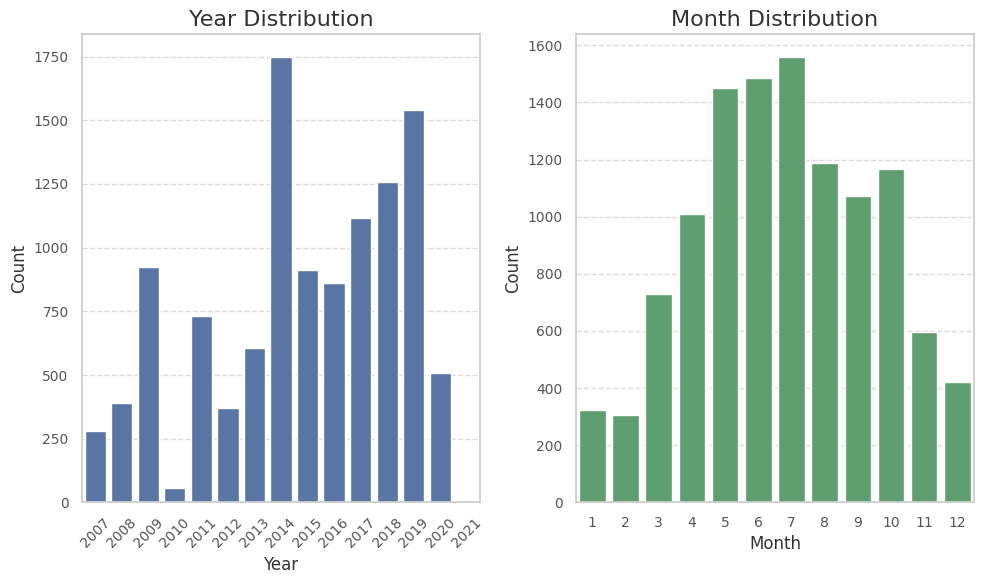

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set a minimalist theme for clarity
sns.set_theme(style="whitegrid")

# Create a figure with a larger size
plt.figure(figsize=(10, 6))

# Year Distribution Plot
plt.subplot(1, 2, 1)
sns.countplot(x='year',data=sampled_df_cleaned, color='#4C72B0')  # Subtle blue
plt.title('Year Distribution', fontsize=16, color='#333333')  # Darker title for emphasis
plt.xlabel('Year', fontsize=12, color='#333333')
plt.ylabel('Count', fontsize=12, color='#333333')
plt.xticks(rotation=45, fontsize=10, color='#555555')
plt.yticks(fontsize=10, color='#555555')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Month Distribution Plot
plt.subplot(1, 2, 2)
sns.countplot(x='month',data=sampled_df_cleaned, color='#55A868')  # Subtle green
plt.title('Month Distribution', fontsize=16, color='#333333')
plt.xlabel('Month', fontsize=12, color='#333333')
plt.ylabel('Count', fontsize=12, color='#333333')
plt.xticks(fontsize=10, color='#555555')
plt.yticks(fontsize=10, color='#555555')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Adjust layout for proper spacing
plt.tight_layout()

# Show the plots
plt.show()


### Analysis of Year and Month Distributions (Sampled Data)

#### Year Distribution
- **Key Trends**:
  - A significant increase in recorded data begins around 2014, peaking in 2014. This indicates that the dataset might have been heavily sampled during this period due to a specific focus, event, or initiative.
  - A gradual decline is observed post-2014, with the lowest number of records in 2021. This could reflect reduced data collection, project completion, or global events like the COVID-19 pandemic affecting data availability.
  - The lack of substantial records before 2007 suggests minimal or no data collection during earlier periods.

- **Implications**:
  - The observed trends highlight potential biases in the sampled data, especially with the noticeable concentration around 2014–2018.
  - The sharp drop in 2021 raises questions about external constraints or shifts in data collection priorities for the sampled dataset.

#### Month Distribution
- **Key Trends**:
  - The dataset shows higher data concentration between late spring and early autumn (May to September), with a peak during the summer months (July and June).
  - Winter months (December–February) have the least data, suggesting seasonal variation or logistical challenges during those months.

- **Implications**:
  - The seasonal concentration in late spring and summer likely reflects dependencies on environmental or operational factors affecting the sampled data.
  - The lower activity during winter may indicate that the sampled dataset was influenced by constraints such as adverse weather or project-specific requirements.

---

### Summary
The trends observed in the year and month distributions are based on the sampled dataset and may not fully represent the entire population. The patterns suggest temporal and seasonal dependencies influenced by project priorities, environmental factors, or external disruptions. Any conclusions drawn from this analysis should account for the sampled nature of the data and potential sampling biases.


##b) Scatter Plot of `lat` vs `lon`


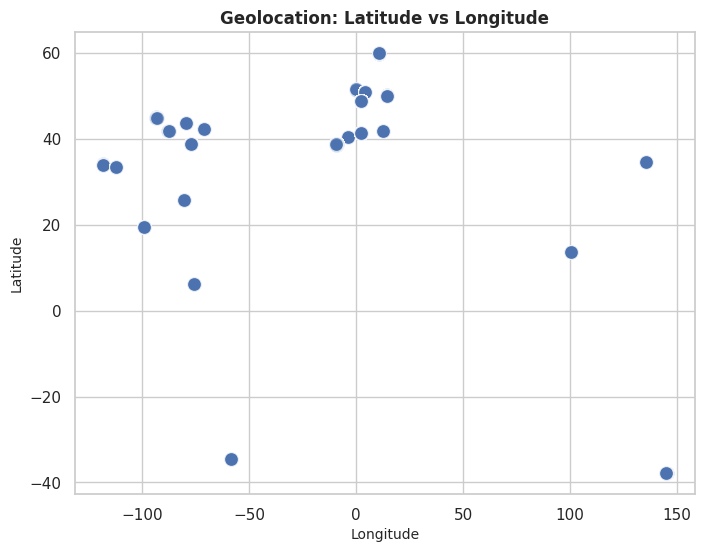

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the size and style of the plot
plt.figure(figsize=(8, 6))
sns.set(style="whitegrid")

# Create the scatter plot for latitude vs longitude
sns.scatterplot(x='lon', y='lat', data=sampled_df_cleaned, alpha=0.7, edgecolor='w', s=100)

# Add a title and labels for clarity
plt.title('Geolocation: Latitude vs Longitude', fontsize=12, weight='bold')
plt.xlabel('Longitude', fontsize=10)
plt.ylabel('Latitude', fontsize=10)

# Display the plot
plt.show()


### Geolocation Analysis: Latitude vs Longitude

The scatter plot above shows the relationship between latitude and longitude for a set of geographical locations. Below are the key insights:

#### Key Insights:
1. **Data Distribution:**
   - The majority of the data points are concentrated in certain regions, primarily around longitude values of -100 to 0 and latitude values of 40–60.
   - Several points cluster around latitude 40–50 and longitude -50 to -100, indicating that most locations fall within this geographical range.
   - Isolated points can be seen near longitude values of 0 and 150, and latitude values close to -40, suggesting sparsity in these areas.

2. **Clusters:**
   - The plot reveals distinct clusters, notably near latitude 40–50 and longitude -50 to -100. These clusters may represent related geographical areas or types of data.
   - There is a visible grouping around latitude 20–30 and longitude -100, indicating another possible cluster.

3. **Outliers:**
   - A few points lie outside the primary clusters, particularly those with extreme longitude values (near 150 and -100) and low latitudes (close to -40), which may indicate outliers or rare locations.



### KMeans Clustering Analysis: Latitude vs Longitude

The scatter plot above shows the results of KMeans clustering applied to the geolocation data (latitude vs longitude). Below are the key insights:

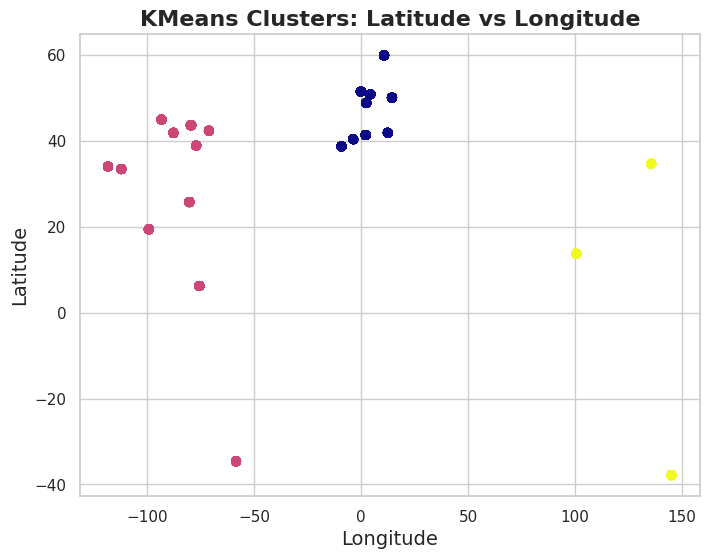

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN, KMeans
from scipy.stats import zscore

# Assuming 'sampled_df_cleaned' contains your data with 'lat' and 'lon' columns
lat_lon_data = sampled_df_cleaned[['lat', 'lon']]

# --- Clustering with KMeans ---
kmeans = KMeans(n_clusters=3)  # Adjust the number of clusters based on the dataset
kmeans_labels = kmeans.fit_predict(lat_lon_data)

# Add KMeans labels to the DataFrame
sampled_df_cleaned['kmeans_cluster'] = kmeans_labels

# Plot the KMeans clusters
plt.figure(figsize=(8, 6))
plt.scatter(sampled_df_cleaned['lon'], sampled_df_cleaned['lat'], c=sampled_df_cleaned['kmeans_cluster'], cmap='plasma', alpha=0.7)
plt.title('KMeans Clusters: Latitude vs Longitude', fontsize=16, weight='bold')
plt.xlabel('Longitude', fontsize=14)
plt.ylabel('Latitude', fontsize=14)
plt.show()



### KMeans Clusters: Latitude vs Longitude

#### Key Insights:
1. **Clusters Identified:**
   - **Pink Cluster**: The majority of the points belong to this cluster, concentrated around longitudes of -100 to -50 and latitudes between 20 and 40.
   - **Blue Cluster**: A distinct group of points is concentrated around longitude 0 and latitude 40–60. These points likely represent a specific region or geographical area.
   - **Yellow Cluster**: A small number of points are in this cluster, located around longitude 100 and latitude -40, indicating that this group may represent outliers or rare locations.

#### Conclusion:
The KMeans clustering has successfully identified distinct groups within the geolocation data. The pink cluster represents the largest group, while the blue and yellow clusters highlight specific regions or potential outliers. Further analysis can explore the significance of these clusters and the potential factors influencing the distribution of these data points.


## c) Geolocation Map with Folium

In [ ]:
from google.colab import drive
import folium
from folium.plugins import MarkerCluster
from folium import Icon

# Mount Google Drive
drive.mount('/content/drive')

# Initialize map with a slightly narrower width, centered at the average lat, lon
m = folium.Map(
    location=[sampled_df_cleaned['lat'].mean(), sampled_df_cleaned['lon'].mean()],
    zoom_start=2,  # Zoom out to cover the whole Earth
    tiles='CartoDB positron',  # Grayscale map style
)

# Add marker cluster
marker_cluster = MarkerCluster().add_to(m)

# Add markers with the 'panoid' shown in the popup
for idx, row in sampled_df_cleaned.iterrows():
    folium.Marker(
        location=[row['lat'], row['lon']],
        popup=f"Place ID: {row['place_id']}<br>PanoID: {row['panoid']}",  # Show place_id and panoid in popup
        icon=Icon(
            icon='circle'
        )
    ).add_to(marker_cluster)

# Specify the path in Google Drive where the map will be saved
output_path = '/content/drive/MyDrive/PDS_A3/map_output.html'

# Save the map to Google Drive
m.save(output_path)

# Show the map
m


### d) City Distribution (Bar Chart)

<ipython-input-41-e7d00f3cb1f8>:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  unique_colors = plt.cm.get_cmap('Spectral', len(city_order))
<ipython-input-41-e7d00f3cb1f8>:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(x='city_id', data=sampled_df_cleaned, order=city_order, palette=[unique_colors(i) for i in range(len(city_order))])


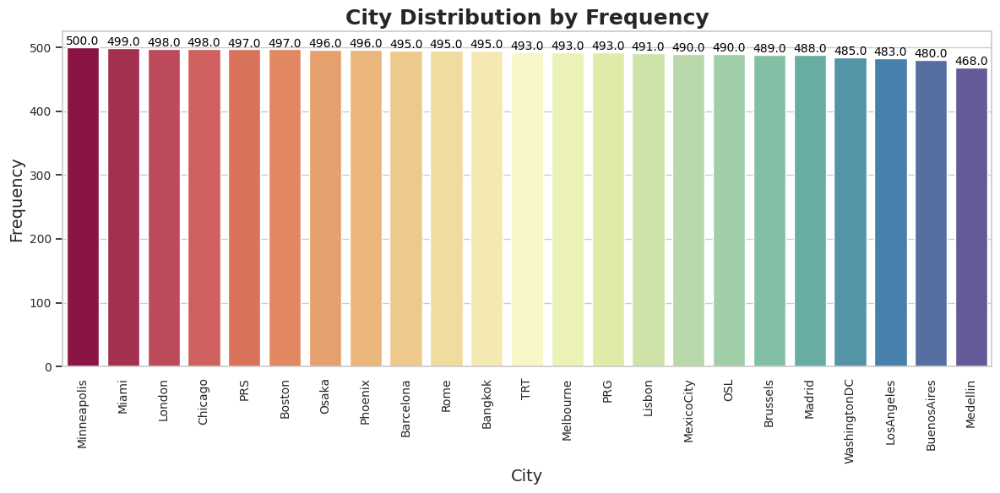

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the style for the plots and improve the overall look
sns.set(style="whitegrid")
plt.figure(figsize=(12, 6))

# Get the order of cities by frequency for the plot
city_order = sampled_df_cleaned['city_id'].value_counts().index

# Generate a color for each city based on a list of unique colors
unique_colors = plt.cm.get_cmap('Spectral', len(city_order))

# Plot the frequency distribution of cities (Bar Chart) with unique colors for each city
ax = sns.countplot(x='city_id', data=sampled_df_cleaned, order=city_order, palette=[unique_colors(i) for i in range(len(city_order))])

# Add the exact frequency labels on top of each bar
for p in ax.patches:
    ax.annotate(f'{p.get_height()}',
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center',
                fontsize=10, color='black',
                xytext=(0, 5), textcoords='offset points')

# Enhance readability of the plot
plt.xticks(rotation=90, fontsize=10)  # Rotate x-ticks for better readability
plt.yticks(fontsize=10)  # Adjust y-tick font size

# Title and axis labels with improved font size and style
plt.title('City Distribution by Frequency', fontsize=18, weight='bold')
plt.xlabel('City', fontsize=14)
plt.ylabel('Frequency', fontsize=14)

# Adding ticks for better granularity on the x and y axis
plt.tick_params(axis='x', which='both', bottom=False, top=False)  # Remove x-tick borders
plt.tick_params(axis='y', which='both', left=True, right=False)  # Keep y-tick borders for clarity

# Show the plot
plt.tight_layout()  # Adjust layout to prevent clipping of labels
plt.show()


### Analysis of City Distribution (Bar Chart)

The bar chart above displays the frequency distribution of cities in the dataset. Here are the key insights:

#### Key Insights:
1. **City Distribution**:
   - The chart shows the frequency of occurrences for each city. The counts represent the number of unique records for each city after duplicates have been removed.
   - Some cities, such as **London**, **Miami**, and **Medellin**, have frequencies close to 500, but **almost no city reaches exactly 500**. This is because the function used to preprocess the data removed duplicate entries for each city, ensuring that each city is only counted once per unique record, not for every occurrence.

2. **City Variety**:
   - A wide variety of cities are represented in the chart, with notable locations like **Osaka**, **Rome**, **Melbourne**, and **Mexico City**. Each city is visually distinguished by its own unique color.

3. **Duplicate Removal**:
   - The reason some bars do not show exactly 500 is that duplicates were removed prior to plotting. The function ensures that images with duplicate names (based on real_image_name) are not included. If the same image appears multiple times across different cities or metadata rows, it will be skipped due to the check if real_image_name in existing_image_names: continue. This prevents the exact count of images from reaching 500 if there are duplicate image names.

4. **Color Coding**:
   - Each city is assigned a distinct color, making it easy to differentiate between cities while maintaining visual clarity.

#### Conclusion:
The bar chart provides a clear representation of the distribution of cities, with each city’s frequency showing how many unique records it has after removing duplicates. This explains why no bar reaches exactly 500, as the data was pre-processed to avoid duplicate images for each city.


###Angle Analysis (northdeg)
We can analyze the distribution of northdeg (which likely represents the camera orientation) to explore trends related to the angles.

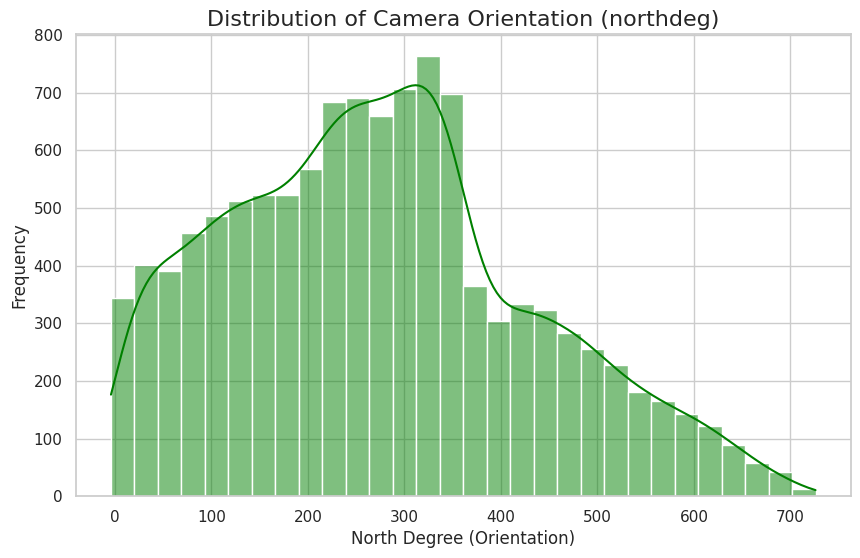

In [ ]:
# Plot the distribution of northdeg to explore camera orientation trends
plt.figure(figsize=(10, 6))
sns.histplot(sampled_df_cleaned['northdeg'], bins=30, kde=True, color='green')
plt.title('Distribution of Camera Orientation (northdeg)', fontsize=16)
plt.xlabel('North Degree (Orientation)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.show()



#### Northdeg (Direction Measurement):
1. **Wide Range of Values**: The values for the northdeg range from -4 to 726, indicating that camera orientations cover a broad range of directions. This suggests cameras capturing data from various terrains or locations with diverse orientations.
2. **Interquartile Range**: The data for northdeg is concentrated between 153 and 365 degrees, showing that the majority of orientations fall within this range. This suggests that camera orientations are focused on certain directional zones.
3. **Environmental and Logistical Factors**: The variation in camera orientation could be attributed to environmental factors, such as different terrains or landmarks, or logistical factors related to camera positioning during data collection.

#3. Unsupervised Learning:


## Methods for Clustering Evaluation and Visualization

### 1. **Silhouette Score**
- **Definition**: Measures how similar an object is to its own cluster compared to other clusters.
- **Range**: Values range from -1 to 1:
  - A value close to 1 indicates well-separated clusters.
  - A value close to 0 indicates overlapping clusters.
  - A negative value suggests incorrect clustering.
- **Usage**: The number of clusters with the highest silhouette score is considered optimal.
- **Visualization**: Bar charts and heatmaps show how cluster distributions vary across cities.

---

### 2. **Elbow Method (Inertia/WCSS)**
- **Definition**: Evaluates the within-cluster sum of squares (WCSS) as the number of clusters increases.
- **Interpretation**: Look for the "elbow point," where the rate of decrease in WCSS slows significantly.
- **Purpose**: Balances the number of clusters against the explained variance.
- **Visualization**: Bar charts allow comparison of city cluster distributions for the optimal number of clusters.

---

### 3. **Gap Statistic**
- **Definition**: Compares the total intra-cluster variation for different numbers of clusters with that expected under a reference distribution.
- **Interpretation**: The optimal number of clusters is where the gap statistic is maximized.
- **Usage**: Provides a statistically robust estimate for the number of clusters.
- **Visualization**: Heatmaps and bar charts highlight the variations in cluster assignments across cities.

---

### 4. **City Cluster Distributions**
- **Definition**: Examines how clusters are distributed across cities for each clustering method.
- **Bar Chart Visualization**:
  - Each subplot represents a city.
  - The x-axis shows cluster IDs, and the y-axis shows the count of items in each cluster.
- **Grid Layout**: Compact grid layout organizes subplots for better comparison.

---

### Summary
- **Silhouette Score** helps determine well-separated clusters.
- **Elbow Method** identifies an efficient number of clusters.
- **Gap Statistic** provides a robust statistical estimate.
- Visualizations like **bar charts** and **heatmaps** enable clear comparison and interpretation of clustering results.


##Import necessary libraries

In [1]:
import os
import numpy as np
import torch
import torchvision.transforms as T
from PIL import Image
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score
from torch.utils.data import Dataset, DataLoader
from torchvision import models
import torch.nn.functional as F
import pandas as pd


##Mount Google Drive

In [2]:
## Mount Google Drive and load the dataset
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

# Define the path to the images and the cleaned metadata
images_path = '/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_Dataset_Images'
metadata_path = '/content/drive/My Drive/PDS_A3/sampled_df_cleaned.pkl'  # Path to the cleaned DataFrame


Mounted at /content/drive


## Counting Images and Metadata

In [ ]:
# Count images in the images_path
image_count = len([f for f in os.listdir(images_path) if os.path.isfile(os.path.join(images_path, f))])

# Load the cleaned DataFrame
if os.path.exists(metadata_path):
    sampled_df_cleaned = pd.read_pickle(metadata_path)
    row_count = len(sampled_df_cleaned)
else:
    row_count = "Metadata path not found"

print(f"Number of images: {image_count}")
print(f"Number of rows in metadata: {row_count}")


Number of images: 11309
Number of rows in metadata: 11309


##Load pretrained ResNet model

In [5]:
# Load Pretrained ResNet101 Model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = models.resnet101(pretrained=True)
model = model.to(device)
model.eval()


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet101_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet101-63fe2227.pth" to /root/.cache/torch/hub/checkpoints/resnet101-63fe2227.pth
100%|██████████| 171M/171M [00:00<00:00, 211MB/s]


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

##Define image preprocessing transformations

In [3]:
import torch
import torchvision.transforms as T
from PIL import Image, ImageFilter
import matplotlib.pyplot as plt

# Define a custom crop strategy for center crop with smaller dimensions
class CenterCrop:
    def __init__(self, height, width):
        self.height = height
        self.width = width

    def __call__(self, img):
        img_width, img_height = img.size
        # Calculate the position of the crop: center
        left = (img_width - self.width) // 2
        top = (img_height - self.height) // 2  # Center of the image
        right = left + self.width
        bottom = top + self.height
        return img.crop((left, top, right, bottom))

# Define a custom transformation to apply the edge detection filter
class EdgeDetection:
    def __call__(self, img):
        # Convert to grayscale and apply edge detection
        img = img.convert("L")  # Convert to grayscale
        img = img.filter(ImageFilter.FIND_EDGES)  # Apply edge detection
        img = img.convert("RGB")  # Convert back to RGB
        return img

# Define a custom transformation to apply the sharpening filter
class Sharpen:
    def __call__(self, img):
        img = img.filter(ImageFilter.SHARPEN)  # Apply sharpening
        return img

# Define transformations to preprocess images with center crop (150x150), filter and normalize
transform = T.Compose([
    #CenterCrop(height=200, width=200),  # Crop from the center
    EdgeDetection(),  # Apply edge detection filter
    Sharpen(),  # Apply sharpening filter
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])


##Define dataset class to load images

In [4]:
# Dataset class to load images
class ImageDataset(Dataset):
    def __init__(self, images_path, transform=None):
        self.images_path = images_path
        self.image_files = [f for f in os.listdir(images_path) if f.lower().endswith(('png', 'jpg', 'jpeg'))]
        self.transform = transform

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        image_path = os.path.join(self.images_path, self.image_files[idx])
        img = Image.open(image_path).convert("RGB")
        if self.transform:
            img = self.transform(img)
        return img, self.image_files[idx]

##Define DataLoader for batching

In [ ]:
# DataLoader for batching
batch_size = 128
dataset = ImageDataset(images_path, transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False)


##Extract image features using ResNet

In [ ]:
import torch
import torch.nn.functional as F
import numpy as np
from tqdm import tqdm  # Import tqdm for progress bar

# Function to extract features from images
def extract_image_features(dataloader, model, device):
    features = []
    image_names = []
    model.to(device)  # Ensure the model is moved to GPU
    model.eval()  # Set the model to evaluation mode

    with torch.no_grad():
        # Wrap the dataloader with tqdm to show a progress bar
        for imgs, filenames in tqdm(dataloader, desc="Extracting Image Features", unit="batch"):
            imgs = imgs.to(device)  # Move images to GPU
            feature = model(imgs)  # Extract features using the model
            feature = F.normalize(feature, p=2, dim=1)  # L2 normalize features
            features.append(feature.cpu().numpy())  # Move features back to CPU
            image_names.extend(filenames)  # Store image filenames

    features = np.concatenate(features, axis=0)  # Concatenate all features into a single array
    return features, image_names

# Save the extracted features to a file
def save_features(features, image_names, feature_file, name_file):
    np.save(feature_file, features)  # Save features as a .npy file
    with open(name_file, 'w') as f:
        for name in image_names:
            f.write(f"{name}\n")  # Save image filenames to a text file

# Example usage
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Use GPU if available
# Assuming the model is initialized and loaded correctly
image_features, image_names = extract_image_features(dataloader, model, device)

# Specify file paths to save features and image names
feature_file = '/content/drive/My Drive/PDS_A3/features.npy'  # Path to save features
name_file = '/content/drive/My Drive/PDS_A3/image_names.txt'  # Path to save image filenames

# Save features and filenames to the specified files
save_features(image_features, image_names, feature_file, name_file)


Extracting Image Features: 100%|██████████| 89/89 [05:55<00:00,  4.00s/batch]


##Extract metadata features from sampled_df_cleaned

In [ ]:
sampled_df_cleaned = pd.read_pickle('/content/drive/My Drive/PDS_A3/sampled_images_and_metadata.pkl')


# Extract metadata features from the cleaned DataFrame
def extract_metadata_features(df):
    metadata_features = df[['year', 'month', 'lat', 'lon']].values
    # Normalize metadata features using StandardScaler
    from sklearn.preprocessing import StandardScaler
    scaler = StandardScaler()
    metadata_features = scaler.fit_transform(metadata_features)
    return metadata_features

# Extract metadata features
metadata_features = extract_metadata_features(sampled_df_cleaned)


 ## Combine image features and metadata features
  Image features have been saved in a .npy file in order not to rerun the Resnet Model

In [ ]:
import numpy as np

# Load image features from the given path
image_features = np.load('/content/drive/My Drive/PDS_A3/features.npy')

# Assuming metadata_features is already defined or loaded from another source
# You can use the combine_features function as you did

def combine_features(image_features, metadata_features):
    assert image_features.shape[0] == metadata_features.shape[0], "Number of image features and metadata rows must match"
    combined_features = np.concatenate([image_features, metadata_features], axis=1)
    return combined_features

# Example: load or define metadata_features
# metadata_features = some_method_to_load_metadata_features()

# Combine image and metadata features
combined_features = combine_features(image_features, metadata_features)


## Apply PCA for dimensionality reduction

In [ ]:
## Apply PCA for dimensionality reduction
n_components = 100  # Increase PCA components to capture more variance
pca = PCA(n_components=n_components)
features_pca = pca.fit_transform(combined_features)

# Evaluate variance explained by PCA components
print(f"Explained variance ratio by PCA components: {pca.explained_variance_ratio_}")
print(f"Total variance explained by {n_components} components: {np.sum(pca.explained_variance_ratio_)}")


Explained variance ratio by PCA components: [3.14885778e-01 2.38369767e-01 2.33722546e-01 1.81965252e-01
 9.87922063e-03 3.66217869e-03 3.16742957e-03 2.10568049e-03
 1.53257509e-03 1.08708266e-03 7.48378469e-04 7.36053536e-04
 5.25618297e-04 4.94083512e-04 4.07175250e-04 3.71164351e-04
 3.60192393e-04 3.07012388e-04 2.70524725e-04 2.53801156e-04
 2.40125199e-04 2.13505538e-04 2.01343190e-04 1.87542185e-04
 1.78476561e-04 1.64793305e-04 1.58749788e-04 1.42186627e-04
 1.35181777e-04 1.26875547e-04 1.21389885e-04 1.06404026e-04
 1.00897851e-04 9.83495474e-05 9.58551050e-05 9.40328551e-05
 8.67262359e-05 8.50261008e-05 7.86801307e-05 7.19345411e-05
 7.03548756e-05 6.74618411e-05 6.33935374e-05 6.15855147e-05
 6.02242947e-05 5.58313917e-05 5.41647832e-05 5.24278392e-05
 5.12395357e-05 5.00305174e-05 4.89248559e-05 4.60790430e-05
 4.41661045e-05 4.30184963e-05 3.99980933e-05 3.95461756e-05
 3.83517073e-05 3.76685270e-05 3.56120809e-05 3.48847665e-05
 3.35289857e-05 3.25485760e-05 3.16563677

##  KMeans Clustering

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, pairwise_distances

# Initialize variables
silhouette_scores = []
inertia_scores = []
gap_statistic_values = []
cluster_range = range(2, 11)

# Precompute reference datasets for Gap Statistic
n_refs = 10
reference_dispersions = []

print("Precomputing reference dispersions for Gap Statistic...")
for _ in range(n_refs):
    random_reference = np.random.uniform(features_pca.min(axis=0), features_pca.max(axis=0), features_pca.shape)
    reference_dispersions.append(random_reference)

# Main loop to compute all metrics
print("Calculating clustering metrics...")
for n_clusters in cluster_range:
    print(f"Testing n_clusters = {n_clusters}...")

    # Fit KMeans to the actual data
    kmeans = KMeans(n_clusters=n_clusters, n_init=10, init='k-means++', random_state=42)
    kmeans_labels = kmeans.fit_predict(features_pca)

    # Silhouette Score
    silhouette = silhouette_score(features_pca, kmeans_labels)
    silhouette_scores.append(silhouette)

    # Inertia (Elbow Method)
    inertia_scores.append(kmeans.inertia_)

    # Gap Statistic
    actual_dispersion = np.sum(np.min(pairwise_distances(features_pca, kmeans.cluster_centers_), axis=1))
    ref_disps = []
    for ref_data in reference_dispersions:
        kmeans.fit(ref_data)
        ref_dispersion = np.sum(np.min(pairwise_distances(ref_data, kmeans.cluster_centers_), axis=1))
        ref_disps.append(ref_dispersion)
    gap_stat = np.log(np.mean(ref_disps)) - np.log(actual_dispersion)
    gap_statistic_values.append(gap_stat)

# Find optimal clusters for each method
best_n_clusters_silhouette = cluster_range[np.argmax(silhouette_scores)]
optimal_clusters_gap = cluster_range[np.argmax(gap_statistic_values)]

# Elbow Method - Locate "elbow"
def find_elbow_point(inertia_scores):
    diffs = np.diff(inertia_scores)
    elbow_point = np.argmin(np.abs(diffs[1:] - diffs[:-1])) + 2  # +2 to align with cluster_range
    return elbow_point

best_n_clusters_elbow = find_elbow_point(inertia_scores)




Precomputing reference dispersions for Gap Statistic...
Calculating clustering metrics...
Testing n_clusters = 2...
Testing n_clusters = 3...
Testing n_clusters = 4...
Testing n_clusters = 5...
Testing n_clusters = 6...
Testing n_clusters = 7...
Testing n_clusters = 8...
Testing n_clusters = 9...
Testing n_clusters = 10...


## Visualize silhouette scores for each n_clusters and scoring methods


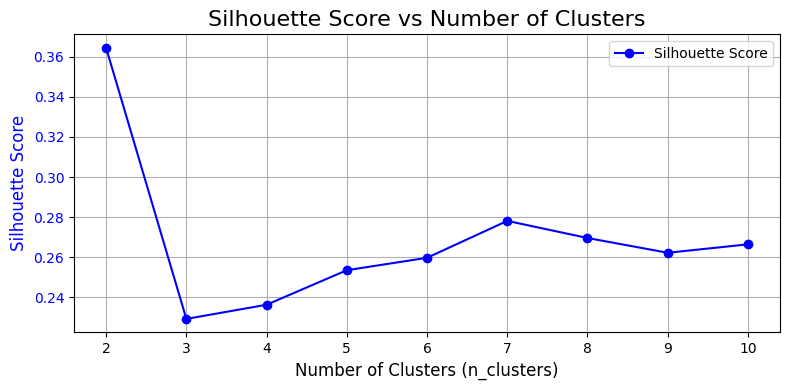

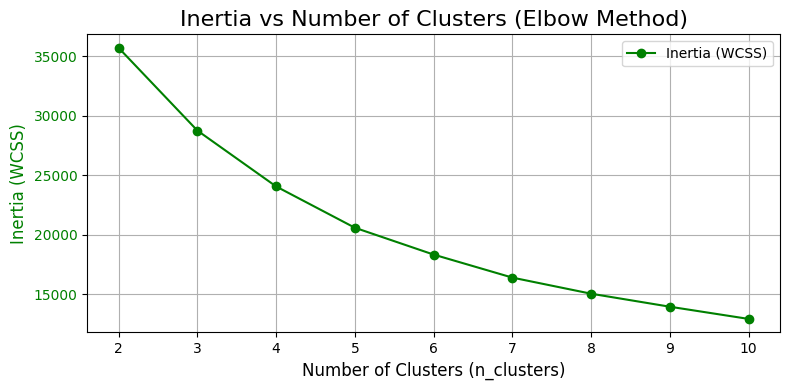

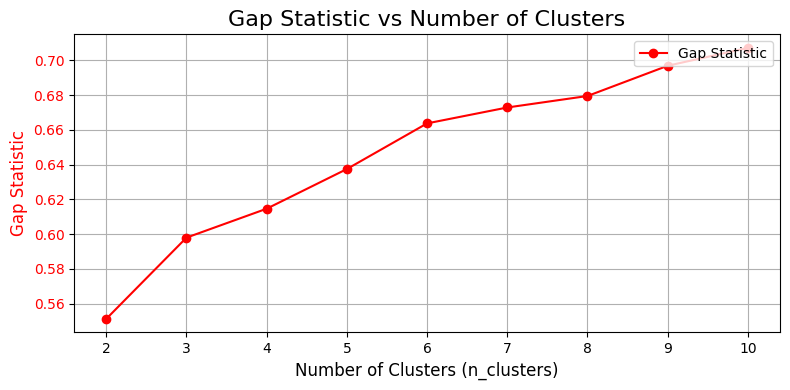

Best n_clusters based on Silhouette Score: 2
Optimal number of clusters (Gap Statistic): 10
Best n_clusters based on Elbow Method: 8


In [ ]:
import matplotlib.pyplot as plt

# Silhouette Score Plot
fig1, ax1 = plt.subplots(figsize=(8, 4))
ax1.plot(cluster_range, silhouette_scores, marker='o', linestyle='-', color='b', label='Silhouette Score')
ax1.set_xlabel('Number of Clusters (n_clusters)', fontsize=12)
ax1.set_ylabel('Silhouette Score', fontsize=12, color='b')
ax1.tick_params(axis='y', labelcolor='b')
ax1.set_title('Silhouette Score vs Number of Clusters', fontsize=16)
ax1.grid(True)
ax1.legend(loc='upper right', fontsize=10)
plt.tight_layout()
plt.show()

# Inertia (Elbow Method) Plot
fig2, ax2 = plt.subplots(figsize=(8, 4))
ax2.plot(cluster_range, inertia_scores, marker='o', linestyle='-', color='g', label='Inertia (WCSS)')
ax2.set_xlabel('Number of Clusters (n_clusters)', fontsize=12)
ax2.set_ylabel('Inertia (WCSS)', fontsize=12, color='g')
ax2.tick_params(axis='y', labelcolor='g')
ax2.set_title('Inertia vs Number of Clusters (Elbow Method)', fontsize=16)
ax2.grid(True)
ax2.legend(loc='upper right', fontsize=10)
plt.tight_layout()
plt.show()

# Gap Statistic Plot
fig3, ax3 = plt.subplots(figsize=(8, 4))
ax3.plot(cluster_range, gap_statistic_values, marker='o', linestyle='-', color='r', label='Gap Statistic')
ax3.set_xlabel('Number of Clusters (n_clusters)', fontsize=12)
ax3.set_ylabel('Gap Statistic', fontsize=12, color='r')
ax3.tick_params(axis='y', labelcolor='r')
ax3.set_title('Gap Statistic vs Number of Clusters', fontsize=16)
ax3.grid(True)
ax3.legend(loc='upper right', fontsize=10)
plt.tight_layout()
plt.show()

# Print optimal clusters for all methods
print(f"Best n_clusters based on Silhouette Score: {best_n_clusters_silhouette}")
print(f"Optimal number of clusters (Gap Statistic): {optimal_clusters_gap}")
print(f"Best n_clusters based on Elbow Method: {best_n_clusters_elbow}")


##Apply KMeans clustering with the best n_clusters for each scoring method

In [ ]:
import joblib
import pandas as pd
from sklearn.cluster import KMeans
from google.colab import drive
import os

# Mount Google Drive
drive.mount('/content/drive',force_remount=True)

# Specify the directory on Google Drive where models will be saved
save_path = '/content/drive/MyDrive/PDS_A3/kmeans_models/'

# Create the directory if it doesn't exist
os.makedirs(save_path, exist_ok=True)

# Dictionary to store optimal clusters from each method
optimal_clusters_methods = {
    "Silhouette Score": best_n_clusters_silhouette,
    "Elbow Method": best_n_clusters_elbow,
    "Gap Statistic": optimal_clusters_gap
}

# Dictionary to store clustering results
kmeans_results = {}

# Apply KMeans clustering for each optimal cluster count
for method, n_clusters in optimal_clusters_methods.items():
    print(f"Applying KMeans with {n_clusters} clusters ({method})...")
    kmeans = KMeans(n_clusters=n_clusters, n_init=10, init='k-means++', random_state=42)
    labels = kmeans.fit_predict(features_pca)
    kmeans_results[method] = {
        "model": kmeans,
        "labels": labels,
        "centers": kmeans.cluster_centers_
    }
    print(f"Finished clustering using {method}.\n")

    # Save the trained model on Google Drive
    model_filename = f"{save_path}kmeans_{method.replace(' ', '_').lower()}.pkl"
    joblib.dump(kmeans, model_filename)
    print(f"Saved {method} model as {model_filename}")

# Load the metadata DataFrame from the pickle file
df = pd.read_pickle('/content/drive/My Drive/PDS_A3/sampled_images_and_metadata.pkl')

# For each clustering method, add the corresponding cluster labels as a new column
for method, n_clusters in optimal_clusters_methods.items():
    # Get the cluster labels for the current method
    labels = kmeans_results[method]["labels"]

    # Add a new column with the cluster labels for the current method
    df[f'cluster_{method.replace(" ", "_").lower()}'] = labels

# Optionally, save the updated DataFrame back to a pickle file
output_pickle_path = '/content/drive/My Drive/PDS_A3/updated_sampled_images_and_metadata.pkl'
df.to_pickle(output_pickle_path)

# Display the updated DataFrame with the new cluster columns
df.head()  # Print the first few rows to check the added cluster columns


Mounted at /content/drive
Applying KMeans with 2 clusters (Silhouette Score)...
Finished clustering using Silhouette Score.

Saved Silhouette Score model as /content/drive/MyDrive/PDS_A3/kmeans_models/kmeans_silhouette_score.pkl
Applying KMeans with 8 clusters (Elbow Method)...
Finished clustering using Elbow Method.

Saved Elbow Method model as /content/drive/MyDrive/PDS_A3/kmeans_models/kmeans_elbow_method.pkl
Applying KMeans with 10 clusters (Gap Statistic)...
Finished clustering using Gap Statistic.

Saved Gap Statistic model as /content/drive/MyDrive/PDS_A3/kmeans_models/kmeans_gap_statistic.pkl


,place_id,year,month,northdeg,city_id,lat,lon,panoid,image_name,image_path,cluster_silhouette_score,cluster_elbow_method,cluster_gap_statistic
360027,4538,2009,10,58,Minneapolis,44.987275,-93.221127,I2CfJnG67tnSAsiA3NMm1g,Minneapolis_0060027_2009_10_058_44.98727479016...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...,1,3,6
350694,2916,2011,9,263,Minneapolis,44.969870,-93.295165,ljRpYVa8kN2fCd2PMNFmug,Minneapolis_0050694_2011_09_263_44.96987026561...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...,1,3,6
350270,2742,2011,6,283,Minneapolis,44.968334,-93.287806,HkEPC9_d6P640aisJYngbA,Minneapolis_0050270_2011_06_283_44.96833429689...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...,1,3,6
359023,3223,2016,9,225,Minneapolis,44.973403,-93.261019,TWBksn5jDCQzK80nhrCD5Q,Minneapolis_0059023_2016_09_225_44.97340315544...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...,1,6,3
355953,136,2019,7,244,Minneapolis,44.939543,-93.254126,5Vy75AKPixWUC0ScEC72Fg,Minneapolis_0055953_2019_07_244_44.93954344166...,/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_...,1,6,3


## Visualize the clustering results with the best n_clusters

### Silhouette Score Clustering 3D Plot

In [ ]:
import plotly.graph_objs as go
import plotly.express as px
import os
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive',force_remount=True)

# Directory to save HTML plots
html_save_directory = "/content/drive/My Drive/PDS_A3/Clustering_Plots/"
os.makedirs(html_save_directory, exist_ok=True)

# Visualize Silhouette Score clustering results in 3D with Plotly
features_3d = features_pca[:, :3]  # Use the first three PCA components for 3D visualization
method = "Silhouette Score"
result = kmeans_results[method]
n_clusters = optimal_clusters_methods[method]
labels = result["labels"]

# Create a color map for clusters
cmap = px.colors.qualitative.Set1  # Using qualitative color set for distinct clusters
cluster_colors = [cmap[label % len(cmap)] for label in labels]

# Create a list to store traces for each cluster
traces = []

# Create a trace for each cluster and add it to the list
for cluster_id in range(n_clusters):
    cluster_indices = [i for i, label in enumerate(labels) if label == cluster_id]
    cluster_x = features_3d[cluster_indices, 0]
    cluster_y = features_3d[cluster_indices, 1]
    cluster_z = features_3d[cluster_indices, 2]

    trace = go.Scatter3d(
        x=cluster_x,
        y=cluster_y,
        z=cluster_z,
        mode='markers',
        marker=dict(
            size=5,
            color=cluster_colors[cluster_indices[0]],  # Use the first color for this cluster
            opacity=0.8
        ),
        name=f'Cluster {cluster_id}',  # Legend label
        hoverinfo='text',
        text=[f'Cluster {cluster_id}' for _ in cluster_x]
    )

    traces.append(trace)

# Define layout with larger legend
layout = go.Layout(
    title=f'KMeans Clustering ({method}) with n_clusters={n_clusters}',
    scene=dict(
        xaxis_title='PCA Component 1',
        yaxis_title='PCA Component 2',
        zaxis_title='PCA Component 3'
    ),
    margin=dict(l=0, r=0, b=0, t=40),
    legend=dict(
        font=dict(
            size=20  # Increase legend font size
        ),
        title=dict(
            text='Clusters',  # Title for the legend
            font=dict(size=24)  # Increase the title font size
        ),
        itemclick="toggle",  # Make the legend interactive
        itemdoubleclick="toggleothers"  # Make the legend interactive
    )
)

# Create the figure
fig = go.Figure(data=traces, layout=layout)

# Save the plot as an HTML file
html_filename = f"{method.replace(' ', '_')}_3d_plot_n_clusters_{n_clusters}.html"
fig.write_html(os.path.join(html_save_directory, html_filename))

# Display the interactive plot
fig.show()

print(f"Saved plot for {method} as HTML in Google Drive: {html_filename}")


Mounted at /content/drive


Saved plot for Silhouette Score as HTML in Google Drive: Silhouette_Score_3d_plot_n_clusters_2.html


###Elbow Method Clustering 3D Plot

In [ ]:
# Visualize Elbow Method clustering results in 3D with Plotly
method = "Elbow Method"
result = kmeans_results[method]
n_clusters = optimal_clusters_methods[method]
labels = result["labels"]

# Create a color map for clusters
cmap = px.colors.qualitative.Set1  # Using qualitative color set for distinct clusters
cluster_colors = [cmap[label % len(cmap)] for label in labels]

# Create a list to store traces for each cluster
traces = []

# Create a trace for each cluster and add it to the list
for cluster_id in range(n_clusters):
    cluster_indices = [i for i, label in enumerate(labels) if label == cluster_id]
    cluster_x = features_3d[cluster_indices, 0]
    cluster_y = features_3d[cluster_indices, 1]
    cluster_z = features_3d[cluster_indices, 2]

    trace = go.Scatter3d(
        x=cluster_x,
        y=cluster_y,
        z=cluster_z,
        mode='markers',
        marker=dict(
            size=5,
            color=cluster_colors[cluster_indices[0]],  # Use the first color for this cluster
            opacity=0.8
        ),
        name=f'Cluster {cluster_id}',  # Legend label
        hoverinfo='text',
        text=[f'Cluster {cluster_id}' for _ in cluster_x]
    )

    traces.append(trace)

# Define layout with larger legend and the ability to see multiple clusters
layout = go.Layout(
    title=f'KMeans Clustering ({method}) with n_clusters={n_clusters}',
    scene=dict(
        xaxis_title='PCA Component 1',
        yaxis_title='PCA Component 2',
        zaxis_title='PCA Component 3'
    ),
    margin=dict(l=0, r=0, b=0, t=40),
    legend=dict(
        font=dict(
            size=20  # Increase legend font size
        ),
        title=dict(
            text='Clusters',  # Title for the legend
            font=dict(size=24)  # Increase the title font size
        ),
        itemclick="toggle",  # Allow toggling visibility of individual clusters
        itemdoubleclick="toggleothers"  # Allow toggling visibility of individual clusters
    )
)

# Create the figure
fig = go.Figure(data=traces, layout=layout)

# Save the plot as an HTML file
html_filename = f"{method.replace(' ', '_')}_3d_plot_n_clusters_{n_clusters}.html"
fig.write_html(os.path.join(html_save_directory, html_filename))

# Display the interactive plot
fig.show()

print(f"Saved plot for {method} as HTML in Google Drive: {html_filename}")


Saved plot for Elbow Method as HTML in Google Drive: Elbow_Method_3d_plot_n_clusters_8.html


### Gap Statistic Clustering 3D Plot

In [ ]:
# Visualize Gap Statistic clustering results in 3D with Plotly
method = "Gap Statistic"
result = kmeans_results[method]
n_clusters = optimal_clusters_methods[method]
labels = result["labels"]

# Create a color map for clusters
cmap = px.colors.qualitative.Set1  # Using qualitative color set for distinct clusters
cluster_colors = [cmap[label % len(cmap)] for label in labels]

# Create a list to store traces for each cluster
traces = []

# Create a trace for each cluster and add it to the list
for cluster_id in range(n_clusters):
    cluster_indices = [i for i, label in enumerate(labels) if label == cluster_id]
    cluster_x = features_3d[cluster_indices, 0]
    cluster_y = features_3d[cluster_indices, 1]
    cluster_z = features_3d[cluster_indices, 2]

    trace = go.Scatter3d(
        x=cluster_x,
        y=cluster_y,
        z=cluster_z,
        mode='markers',
        marker=dict(
            size=5,
            color=cluster_colors[cluster_indices[0]],  # Use the first color for this cluster
            opacity=0.8
        ),
        name=f'Cluster {cluster_id}',  # Legend label
        hoverinfo='text',
        text=[f'Cluster {cluster_id}' for _ in cluster_x]
    )

    traces.append(trace)

# Define layout with larger legend and the ability to see multiple clusters
layout = go.Layout(
    title=f'KMeans Clustering ({method}) with n_clusters={n_clusters}',
    scene=dict(
        xaxis_title='PCA Component 1',
        yaxis_title='PCA Component 2',
        zaxis_title='PCA Component 3'
    ),
    margin=dict(l=0, r=0, b=0, t=40),
    legend=dict(
        font=dict(
            size=20  # Increase legend font size
        ),
        title=dict(
            text='Clusters',  # Title for the legend
            font=dict(size=24)  # Increase the title font size
        ),
        itemclick="toggle",  # Allow toggling visibility of individual clusters
        itemdoubleclick="toggleothers"  # Allow toggling visibility of individual clusters
    )
)

# Create the figure
fig = go.Figure(data=traces, layout=layout)

# Save the plot as an HTML file
html_filename = f"{method.replace(' ', '_')}_3d_plot_n_clusters_{n_clusters}.html"
fig.write_html(os.path.join(html_save_directory, html_filename))

# Display the interactive plot
fig.show()

print(f"Saved plot for {method} as HTML in Google Drive: {html_filename}")


Saved plot for Gap Statistic as HTML in Google Drive: Gap_Statistic_3d_plot_n_clusters_10.html


## Get the closest images to each cluster center

### Silhouette Score Closest Images to Each Cluster Center

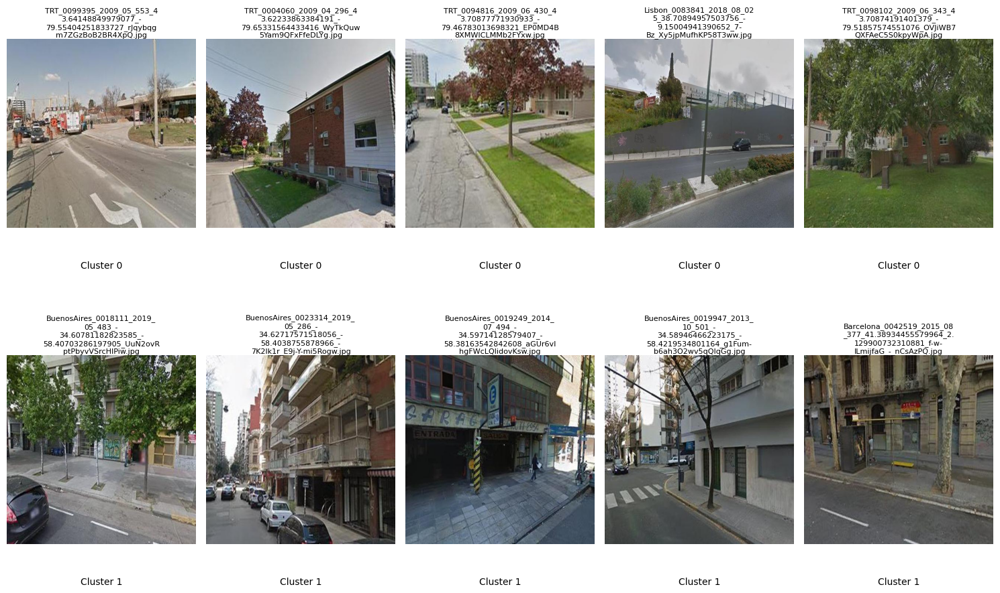

In [ ]:
import numpy as np
import os
from IPython.display import Image, display
import matplotlib.pyplot as plt
import textwrap

# Function to get the 5 closest images to each cluster center
def get_closest_images_per_cluster(kmeans, features, image_names, n_closest=5):
    centers = kmeans.cluster_centers_
    closest_image_idx_per_cluster = []
    for center in centers:
        distances = np.linalg.norm(features - center, axis=1)
        closest_idx = np.argsort(distances)[:n_closest]  # Get the indices of the n closest images
        closest_image_idx_per_cluster.append(closest_idx)
    return [[image_names[idx] for idx in closest_idx] for closest_idx in closest_image_idx_per_cluster]

# Load image names from the text file
image_names_path = "/content/drive/My Drive/PDS_A3/image_names.txt"
with open(image_names_path, 'r') as file:
    image_names = file.read().splitlines()

# Directory containing the images
image_directory = "/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_Dataset_Images"

# Assuming kmeans_results and optimal_clusters_methods are predefined in your environment
method = "Silhouette Score"
result = kmeans_results[method]
n_clusters = optimal_clusters_methods[method]

# Get the 5 closest images per cluster
closest_images_per_cluster = get_closest_images_per_cluster(result["model"], features_pca, image_names, n_closest=5)

# Plot images in rows for each cluster (smaller size)
fig, axes = plt.subplots(n_clusters, 5, figsize=(15, 5 * n_clusters))  # Adjust figure size based on number of clusters
if n_clusters == 1:
    axes = [axes]  # To handle the case when there is only one cluster

for i in range(n_clusters):
    for j, closest_image in enumerate(closest_images_per_cluster[i]):
        img_path = os.path.join(image_directory, closest_image)
        axes[i, j].imshow(plt.imread(img_path))
        axes[i, j].axis('off')  # Turn off axis
        # Add image name, break long names into multiple lines
        name_display = closest_image
        wrapped_name = textwrap.fill(name_display, width=25)  # Wrap the name into multiple lines
        axes[i, j].set_title(wrapped_name, fontsize=8, verticalalignment='top')

        # Display cluster information below the image
        axes[i, j].text(0.5, -0.2, f"Cluster {i}", ha='center', va='center', transform=axes[i, j].transAxes, fontsize=10)

plt.tight_layout()
plt.show()


#### **Cluster 0 : "Suburban Area"**
- Most Represented Cities: PRS, Boston, TRT, Phoenix, Buenos Aires.
- Characteristics: Suburban areas with wide streets, residential buildings, and some greenery. These cities have more open spaces, often with low-rise buildings, and appear to be more spread out with less commercial activity compared to urban centers.

#### **Cluster 1 : "Urban Area"**
- Most Represented Cities: WashingtonDC, London.
- Characteristics: Urban, densely populated cities with narrow streets, commercial buildings, and visible infrastructure. These cities feature more compact areas with a mix of residential and commercial properties, as well as higher population densities and less greenery.


### Elbow Method Closest Images to Each Cluster Center

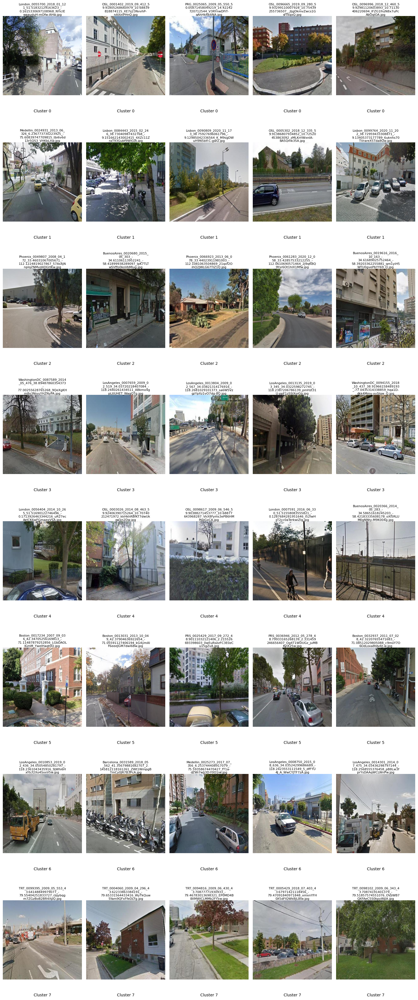

In [ ]:
import numpy as np
import os
from IPython.display import Image, display
import matplotlib.pyplot as plt
import textwrap

# Function to get the closest 5 images to each cluster center
def get_closest_images(kmeans, features, image_names, num_closest=5):
    centers = kmeans.cluster_centers_
    closest_image_idx = []
    for center in centers:
        distances = np.linalg.norm(features - center, axis=1)
        sorted_idx = np.argsort(distances)[:num_closest]  # Get indices of the closest 5 images
        closest_image_idx.append(sorted_idx)
    return [[image_names[idx] for idx in cluster_idx] for cluster_idx in closest_image_idx]

# Load image names from the text file
image_names_path = "/content/drive/My Drive/PDS_A3/image_names.txt"
with open(image_names_path, 'r') as file:
    image_names = file.read().splitlines()

# Directory containing the images
image_directory = "/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_Dataset_Images"

# Display the closest images for Gap Statistic clustering method
method = "Elbow Method"
result = kmeans_results[method]
n_clusters = optimal_clusters_methods[method]
closest_images_per_cluster = get_closest_images(result["model"], features_pca, image_names, num_closest=5)

# Number of images per row
images_per_row = 5
num_rows = (n_clusters * 5 + images_per_row - 1) // images_per_row  # Adjust for 5 images per cluster

# Plot images in rows for each cluster
fig, axes = plt.subplots(num_rows, images_per_row, figsize=(15, num_rows * 4.5))

# Flatten axes array for easy iteration if multiple rows
axes = axes.flatten()

# Display the 5 closest images per cluster
for i, cluster_images in enumerate(closest_images_per_cluster):
    for j, closest_image in enumerate(cluster_images):
        idx = i * 5 + j
        img_path = os.path.join(image_directory, closest_image)
        axes[idx].imshow(plt.imread(img_path))
        axes[idx].axis('off')  # Turn off axis

        # Add wrapped image name with a maximum width for better display
        wrapped_name = textwrap.fill(closest_image, width=25)  # Wrap the name into multiple lines
        axes[idx].set_title(wrapped_name, fontsize=8, verticalalignment='top')

        # Display cluster information below the image
        axes[idx].text(0.5, -0.2, f"Cluster {i}", ha='center', va='center', transform=axes[idx].transAxes, fontsize=10)

# Turn off axes for any remaining empty subplots
for j in range(idx + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


### **Evaluations of Elbow Method Clusters**

### **Cluster 0**
Urban streets that feature a blend of residential buildings and commercial areas, with visible infrastructure like pedestrian pathways, traffic signs, and parked cars.  
**Distinguished Feature:** A mix of residential buildings and shops on the same streets, with modern urban infrastructure.


### **Cluster 1**
Urban streets with a mix of residential and commercial elements, featuring tree-lined roads, modern apartment buildings, and clear road markings.  
**Distinguished Feature:** A combination of greenery (trees) along the streets and well-maintained urban infrastructure, with a mix of vehicles parked along the roads.


### **Cluster 2**
Suburban streets with residential houses, small businesses, and green spaces. The streets appear less busy compared to urban areas, with fewer vehicles and a more relaxed, spacious atmosphere.  
**Distinguished Feature:** Primarily residential areas with a mix of single-story homes and small commercial establishments, surrounded by greenery.


### **Cluster 3**
Urban streets with commercial buildings, larger roads, and well-defined traffic infrastructure. The images depict busy streets with wide lanes, trees lining the roads, and a blend of high-rise and mid-rise buildings.  
**Distinguished Feature:** Streets with a mix of commercial and residential areas, characterized by wide lanes and urban infrastructure, indicating a more metropolitan environment.


### **Cluster 4**
Residential streets with a focus on greenery, fences, and gated areas. The images depict quieter streets with more private or semi-private spaces, featuring green areas, fences, and pathways.  
**Distinguished Feature:** Suburban or residential settings with private areas, characterized by fences, greenery, and a more isolated atmosphere compared to busy urban centers.


### **Cluster 5**
Suburban and residential streets with a combination of single-family homes, apartment buildings, and tree-lined avenues. The streets are characterized by a mix of residential and commercial elements, with parked cars along the roads.  
**Distinguished Feature:** A combination of residential homes and apartment buildings, with clear signs of urban life, such as vehicles parked along the streets and greenery lining the roads.


### **Cluster 6**
Urban streets with high traffic, featuring both commercial and residential areas. The images depict wide roads with a mix of vehicles such as trucks and cars, and infrastructure like street signage and parked vehicles.  
**Distinguished Feature:** Wide roads with heavy traffic, a combination of vehicles and urban infrastructure indicating a busy metropolitan environment.


### **Cluster 7**
Suburban streets with residential buildings, well-maintained lawns, and clear signs of a quieter, community-oriented environment. The images show residential areas with green spaces, sidewalks, and occasional parked cars.  
**Distinguished Feature:** Residential neighborhoods with grassy areas and low-density buildings, suggesting a peaceful suburban atmosphere.



### Gap Statistic Closest Images to Each Cluster Center

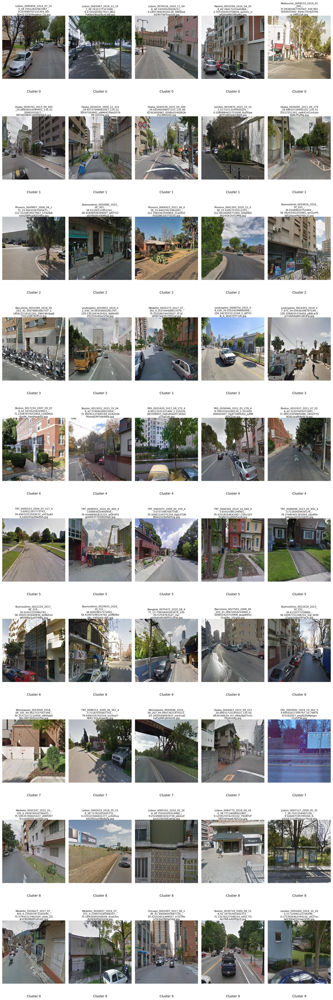

In [ ]:
import numpy as np
import os
from IPython.display import Image, display
import matplotlib.pyplot as plt
import textwrap

# Function to get the closest 5 images to each cluster center
def get_closest_images(kmeans, features, image_names, num_closest=5):
    centers = kmeans.cluster_centers_
    closest_image_idx = []
    for center in centers:
        distances = np.linalg.norm(features - center, axis=1)
        sorted_idx = np.argsort(distances)[:num_closest]  # Get indices of the closest 5 images
        closest_image_idx.append(sorted_idx)
    return [[image_names[idx] for idx in cluster_idx] for cluster_idx in closest_image_idx]

# Load image names from the text file
image_names_path = "/content/drive/My Drive/PDS_A3/image_names.txt"
with open(image_names_path, 'r') as file:
    image_names = file.read().splitlines()

# Directory containing the images
image_directory = "/content/drive/My Drive/PDS_A3/PDS_A3_Sampled_Dataset_Images"

# Display the closest images for Gap Statistic clustering method
method = "Gap Statistic"
result = kmeans_results[method]
n_clusters = optimal_clusters_methods[method]
closest_images_per_cluster = get_closest_images(result["model"], features_pca, image_names, num_closest=5)

# Number of images per row
images_per_row = 5
num_rows = (n_clusters * 5 + images_per_row - 1) // images_per_row  # Adjust for 5 images per cluster

# Plot images in rows for each cluster
fig, axes = plt.subplots(num_rows, images_per_row, figsize=(15, num_rows * 4.5))

# Flatten axes array for easy iteration if multiple rows
axes = axes.flatten()

# Display the 5 closest images per cluster
for i, cluster_images in enumerate(closest_images_per_cluster):
    for j, closest_image in enumerate(cluster_images):
        idx = i * 5 + j
        img_path = os.path.join(image_directory, closest_image)
        axes[idx].imshow(plt.imread(img_path))
        axes[idx].axis('off')  # Turn off axis

        # Add wrapped image name with a maximum width for better display
        wrapped_name = textwrap.fill(closest_image, width=25)  # Wrap the name into multiple lines
        axes[idx].set_title(wrapped_name, fontsize=8, verticalalignment='top')

        # Display cluster information below the image
        axes[idx].text(0.5, -0.2, f"Cluster {i}", ha='center', va='center', transform=axes[idx].transAxes, fontsize=10)

# Turn off axes for any remaining empty subplots
for j in range(idx + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


### **Cluster 0**
Urban streets with trees lining the roads, pedestrian-friendly environments, and a mix of residential and commercial buildings. The streets appear to have moderate traffic, with parked cars along the roads.

**Distinguished Feature:** Tree-lined streets in urban areas, with a balance of residential and commercial properties, creating a pleasant and functional environment.

### **Cluster 1**
Urban streets with a focus on narrow roads, mixed commercial and residential buildings, and well-maintained infrastructure. The images show tree-lined streets with clear lanes and pedestrian walkways, often with few vehicles.  

**Distinguished Feature:** Narrow, well-defined streets in busy urban settings, with a combination of commercial and residential structures, indicating a highly organized and pedestrian-friendly environment.


### **Cluster 2**
Suburban streets with residential homes, small businesses, and green spaces. The images depict quieter areas with low-density buildings, wide roads, and a relaxed atmosphere.  
**Distinguished Feature:** Suburban or residential settings characterized by single-story homes, small commercial establishments, and greenery along the streets.


### **Cluster 3**
Urban streets with high traffic, wide lanes, and a mix of commercial and residential buildings. The images depict busy streets with a variety of vehicles, including trucks and cars, and large urban infrastructure.  

**Distinguished Feature:** Wide roads and busy urban environments with a combination of commercial and residential buildings, indicating a high-traffic, metropolitan setting.

### **Cluster 4**
Residential and suburban streets featuring a mix of low-rise homes, green spaces, and trees. The streets are relatively quiet, with clear walkways and some parked cars.  

**Distinguished Feature:** Residential areas with a mix of single-family homes and low-density commercial buildings, characterized by green spaces and tree-lined streets.


### **Cluster 5**
Suburban streets with a combination of residential houses, some under construction or renovation, and well-maintained green spaces. The streets are characterized by single-family homes, paved roads, and clean sidewalks.

**Distinguished Feature:** A mix of residential homes, some in the process of being renovated or constructed, alongside well-maintained streets and green lawns.

### **Cluster 6**
Urban streets with a focus on commercial areas and some residential buildings, featuring narrow roads, parked cars, and visible utility infrastructure. The streets appear to be bustling with activity and have various types of buildings and street signs.  

**Distinguished Feature:** Commercial areas with a mix of narrow streets, parked vehicles, and visible utility infrastructure, giving a densely populated and active urban atmosphere.

### **Cluster 7**
Highway and suburban roads with wide lanes, minimal traffic congestion, and a mix of residential and industrial elements. The images depict roads with open spaces, large vehicles, and visible infrastructure such as overpasses and bridges.  

**Distinguished Feature:** Wide, open highways and roads with minimal traffic, often featuring industrial or residential areas alongside the road, providing a more expansive and utilitarian environment.


### **Cluster 8**
Urban streets showcasing the facades of homes, storefronts, and large advertising billboards. The images depict a mix of residential and commercial buildings with visible signage and advertisements.  

**Distinguished Feature:** A combination of home facades, commercial store fronts, and prominent billboards, highlighting the urban commercial atmosphere.

### **Cluster 9**
Wide streets with active traffic, featuring a mix of residential and urban areas. The images show roads with moving vehicles, large buildings, and clear signage.  
**Distinguished Feature:** Wide roads with active traffic, highlighting a blend of urban and suburban areas, with a focus on roadways and vehicles in motion.





## City Distributions per Cluster

### Silhouette Score Heatmap

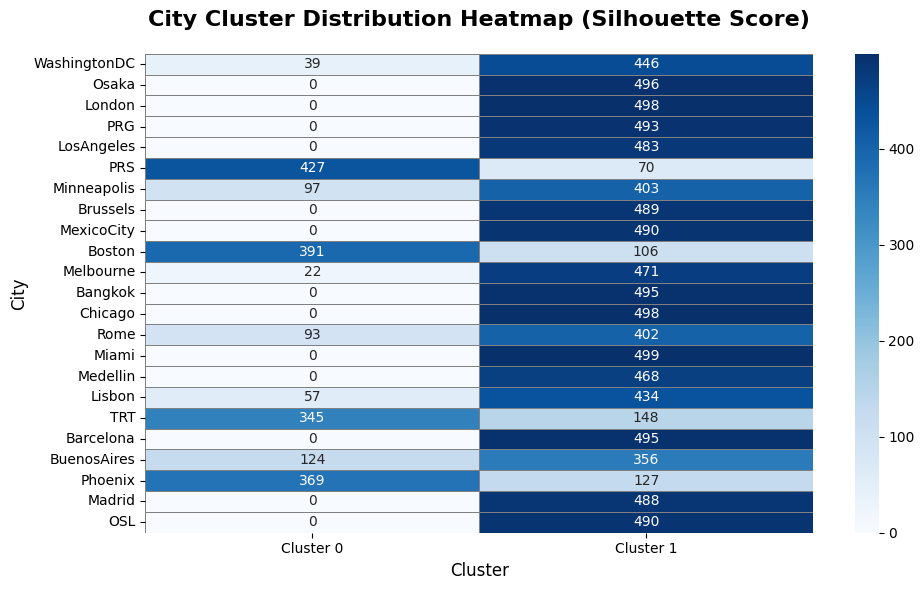

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

# Function to calculate city cluster distribution
def calculate_city_cluster_distribution(labels, image_names):
    city_cluster_distribution = {}
    for i, city in enumerate(image_names):
        city_name = city.split('_')[0]  # Assuming the city name is the first part of the image name
        if city_name not in city_cluster_distribution:
            city_cluster_distribution[city_name] = []
        city_cluster_distribution[city_name].append(labels[i])

    city_cluster_counts = {}
    for city, clusters in city_cluster_distribution.items():
        cluster_counts = np.bincount(clusters, minlength=len(set(labels)))
        city_cluster_counts[city] = cluster_counts

    return pd.DataFrame(city_cluster_counts).T

# Heatmap for Silhouette Score clustering method
method = "Silhouette Score"
result = kmeans_results[method]
n_clusters = optimal_clusters_methods[method]

# Calculate city cluster distribution
city_cluster_df = calculate_city_cluster_distribution(result["labels"], image_names)
city_cluster_df.columns = [f'Cluster {i}' for i in range(city_cluster_df.shape[1])]
city_cluster_df.index.name = "City"

# Plot Heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(city_cluster_df, annot=True, fmt="d", cmap="Blues", cbar=True, linewidths=0.5, linecolor='gray')
plt.title(f"City Cluster Distribution Heatmap ({method})", fontsize=16, fontweight='bold', pad=20)
plt.ylabel("City", fontsize=12)
plt.xlabel("Cluster", fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10, rotation=0)
plt.tight_layout()
plt.show()


### Elbow Method Heatmap

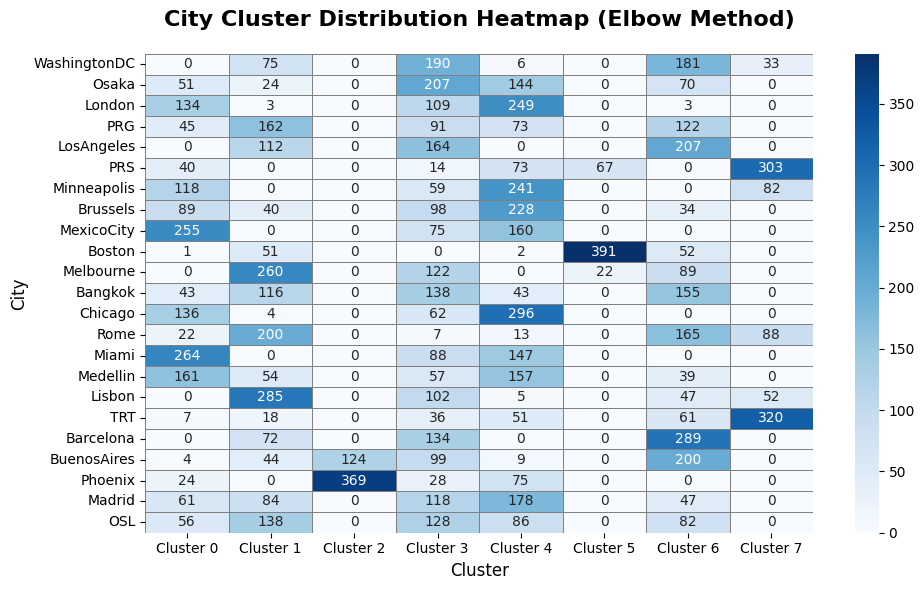

In [ ]:
# Heatmap for Elbow Method clustering
method = "Elbow Method"
result = kmeans_results[method]
n_clusters = optimal_clusters_methods[method]

# Calculate city cluster distribution
city_cluster_df = calculate_city_cluster_distribution(result["labels"], image_names)
city_cluster_df.columns = [f'Cluster {i}' for i in range(city_cluster_df.shape[1])]
city_cluster_df.index.name = "City"

# Plot Heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(city_cluster_df, annot=True, fmt="d", cmap="Blues", cbar=True, linewidths=0.5, linecolor='gray')
plt.title(f"City Cluster Distribution Heatmap ({method})", fontsize=16, fontweight='bold', pad=20)
plt.ylabel("City", fontsize=12)
plt.xlabel("Cluster", fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10, rotation=0)
plt.tight_layout()
plt.show()


### Gap Statistic Heatmap

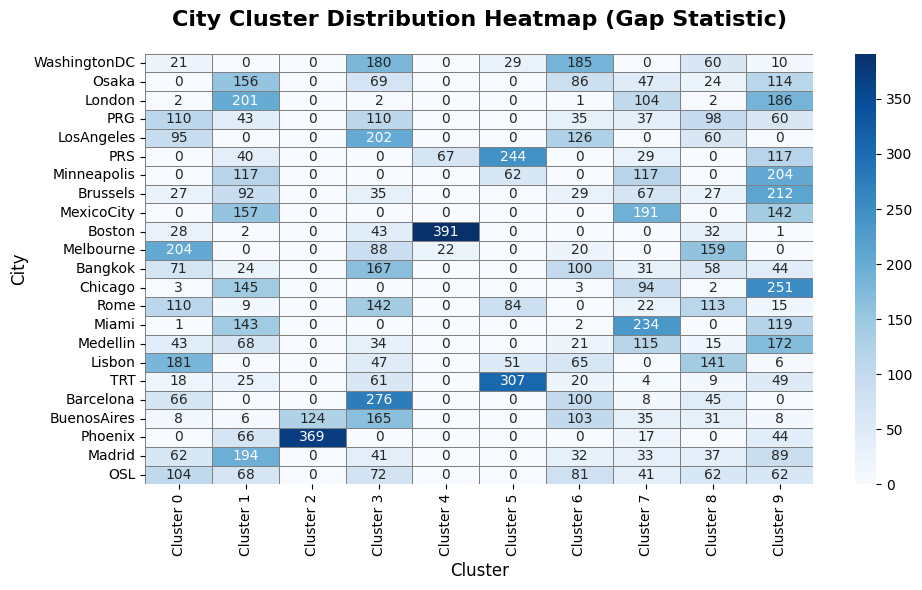

In [ ]:
# Heatmap for Gap Statistic clustering method
method = "Gap Statistic"
result = kmeans_results[method]
n_clusters = optimal_clusters_methods[method]

# Calculate city cluster distribution
city_cluster_df = calculate_city_cluster_distribution(result["labels"], image_names)
city_cluster_df.columns = [f'Cluster {i}' for i in range(city_cluster_df.shape[1])]
city_cluster_df.index.name = "City"

# Plot Heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(city_cluster_df, annot=True, fmt="d", cmap="Blues", cbar=True, linewidths=0.5, linecolor='gray')
plt.title(f"City Cluster Distribution Heatmap ({method})", fontsize=16, fontweight='bold', pad=20)
plt.ylabel("City", fontsize=12)
plt.xlabel("Cluster", fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10, rotation=0)
plt.tight_layout()
plt.show()


### Silhouette Score Bar Charts

<ipython-input-27-f78090ed6c06>:40: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



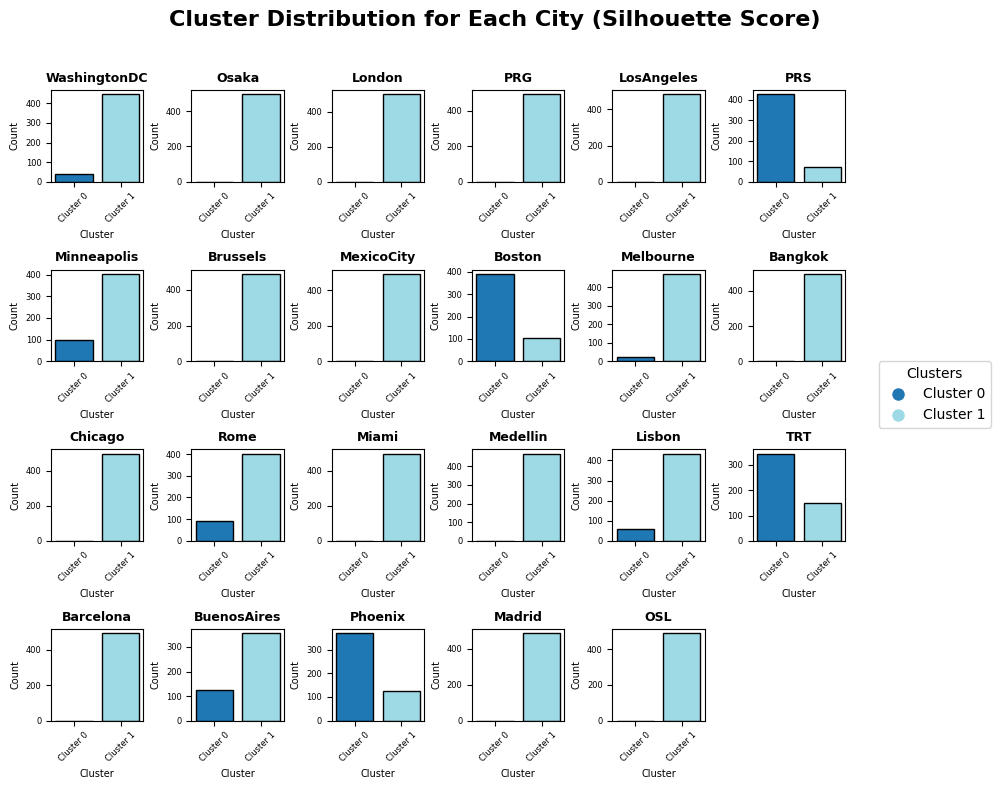

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Function to calculate city cluster distribution
def calculate_city_cluster_distribution(labels, image_names):
    city_cluster_distribution = {}
    for i, city in enumerate(image_names):
        city_name = city.split('_')[0]  # Assuming the city name is the first part of the image name
        if city_name not in city_cluster_distribution:
            city_cluster_distribution[city_name] = []
        city_cluster_distribution[city_name].append(labels[i])

    city_cluster_counts = {}
    for city, clusters in city_cluster_distribution.items():
        cluster_counts = np.bincount(clusters, minlength=len(set(labels)))
        city_cluster_counts[city] = cluster_counts

    return city_cluster_counts

# Bar Charts for Silhouette Score clustering method
method = "Silhouette Score"
result = kmeans_results[method]
n_clusters = optimal_clusters_methods[method]

# Calculate city cluster distribution
city_cluster_counts = calculate_city_cluster_distribution(result["labels"], image_names)

# Plot bar charts as subplots
num_cities = len(city_cluster_counts)
cols = 6  # Number of columns for smaller subplots
rows = (num_cities + cols - 1) // cols  # Calculate rows based on cities and columns

fig, axes = plt.subplots(rows, cols, figsize=(10, rows * 2))  # Adjust overall size
fig.suptitle(f"Cluster Distribution for Each City ({method})", fontsize=16, fontweight='bold')

# Flatten axes for easier iteration
axes = axes.flatten()

# Define a color map with distinct colors for each cluster
colors = plt.cm.get_cmap('tab20', n_clusters)  # 'tab20' has 20 distinct colors

# Plot each city's distribution
for idx, (city, counts) in enumerate(city_cluster_counts.items()):
    axes[idx].bar(range(len(counts)), counts, color=colors(range(len(counts))), edgecolor='black')
    axes[idx].set_title(city, fontsize=9, fontweight='bold')
    axes[idx].set_xlabel("Cluster", fontsize=7)
    axes[idx].set_ylabel("Count", fontsize=7)
    axes[idx].set_xticks(range(len(counts)))
    axes[idx].set_xticklabels([f'Cluster {i}' for i in range(len(counts))], fontsize=6, rotation=45)
    axes[idx].tick_params(axis='y', labelsize=6)

# Remove empty subplots
for idx in range(len(city_cluster_counts), len(axes)):
    fig.delaxes(axes[idx])

# Create a custom legend for all clusters (one legend for all plots)
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=colors(i), markersize=10) for i in range(n_clusters)]
labels = [f'Cluster {i}' for i in range(n_clusters)]

# Add the legend outside the figure
fig.legend(handles, labels, loc='center right', title="Clusters", fontsize=10)

plt.tight_layout()
plt.subplots_adjust(top=0.88, right=0.85)
plt.show()


### **Cities Grouped by Silhouette Score Method Clustering**

---
- **Cluster 0:**

Cities that are most similar in cluster distribution are Phoenix, Boston, TRT, PRS.

- **Cluster 1:**

Cities that are most similar in cluster distribution are Osaka, London, PRG, Los Angeles, Minneapolis, Brussels, Mexico City, Melbourne, Bangkok, Chicago, Lisbon, and OSL.

### Elbow Method Bar Charts

<ipython-input-28-c3e16d8e7df6>:40: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



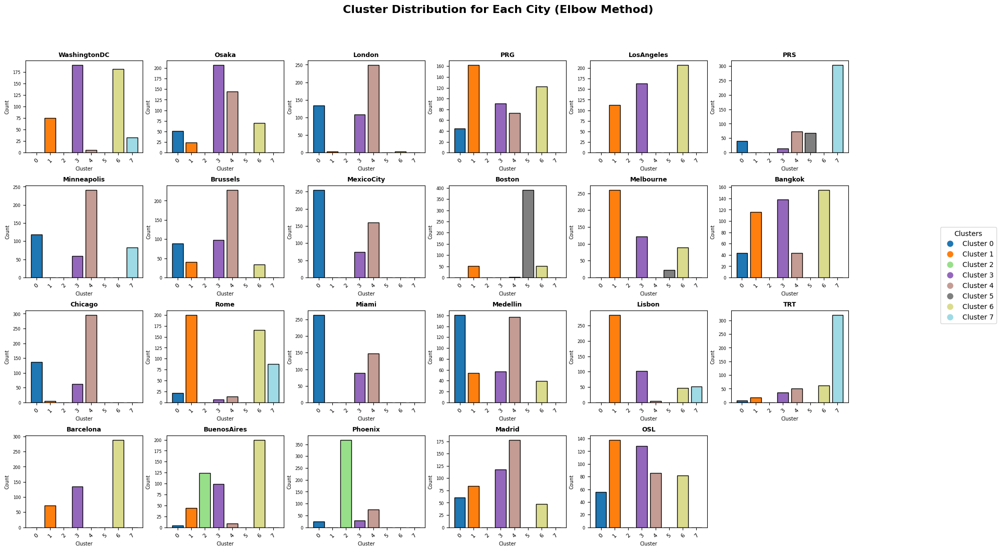

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Function to calculate city cluster distribution
def calculate_city_cluster_distribution(labels, image_names):
    city_cluster_distribution = {}
    for i, city in enumerate(image_names):
        city_name = city.split('_')[0]  # Assuming the city name is the first part of the image name
        if city_name not in city_cluster_distribution:
            city_cluster_distribution[city_name] = []
        city_cluster_distribution[city_name].append(labels[i])

    city_cluster_counts = {}
    for city, clusters in city_cluster_distribution.items():
        cluster_counts = np.bincount(clusters, minlength=len(set(labels)))
        city_cluster_counts[city] = cluster_counts

    return city_cluster_counts

# Bar Charts for Elbow Method clustering
method = "Elbow Method"
result = kmeans_results[method]
n_clusters = optimal_clusters_methods[method]

# Calculate city cluster distribution
city_cluster_counts = calculate_city_cluster_distribution(result["labels"], image_names)

# Plot bar charts as subplots
num_cities = len(city_cluster_counts)
cols = 6  # Number of columns for smaller subplots
rows = (num_cities + cols - 1) // cols  # Calculate rows based on cities and columns

fig, axes = plt.subplots(rows, cols, figsize=(20, rows * 2.8))  # Adjust overall size
fig.suptitle(f"Cluster Distribution for Each City ({method})", fontsize=16, fontweight='bold')

# Flatten axes for easier iteration
axes = axes.flatten()

# Define a color map with distinct colors for each cluster
colors = plt.cm.get_cmap('tab20', n_clusters)  # 'tab20' has 20 distinct colors

# Plot each city's distribution
for idx, (city, counts) in enumerate(city_cluster_counts.items()):
    bars = axes[idx].bar(range(len(counts)), counts, color=colors(range(len(counts))), edgecolor='black')
    axes[idx].set_title(city, fontsize=9, fontweight='bold')
    axes[idx].set_xlabel("Cluster", fontsize=7)
    axes[idx].set_ylabel("Count", fontsize=7)
    axes[idx].set_xticks(range(len(counts)))
    axes[idx].set_xticklabels([f'{i}' for i in range(len(counts))], fontsize=8, rotation=45)
    axes[idx].tick_params(axis='y', labelsize=6)

# Remove empty subplots
for idx in range(len(city_cluster_counts), len(axes)):
    fig.delaxes(axes[idx])

# Create a custom legend for all clusters (one legend for all plots)
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=colors(i), markersize=10) for i in range(n_clusters)]
labels = [f'Cluster {i}' for i in range(n_clusters)]

# Add the legend outside the figure
fig.legend(handles, labels, loc='center right',title="Clusters", fontsize=10)

plt.tight_layout()
plt.subplots_adjust(top=0.88, right=0.85)
plt.show()


### **Cities Grouped by Elbow Method Clustering**

---

- **Cluster 0**:  
  - **Mexico City**, **Miami**, **Medellin**  
  These cities are strongly represented in **Cluster 0**, suggesting they share similar features or behaviors that categorize them into this group.

- **Cluster 1**:  
  - **Prague**, **Melbourne**, **Lisbon**, **Oslo**  
  These cities share a strong presence in **Cluster 1**, indicating they share clustering traits or features that align them in this category.

- **Cluster 2**:  
  - **Phoenix**  
  **Phoenix** stands out as the only city in **Cluster 2**, indicating it has a unique clustering pattern compared to other cities.

- **Cluster 3**:  
  - **Washington DC**, **Osaka**, **Oslo**  
  These cities share a strong presence in **Cluster 3**, suggesting they have a similar clustering pattern that sets them apart from other cities.

- **Cluster 4**:  
  - **London**, **Minneapolis**, **Brussels**, **Medellin**, **Chicago**, **Madrid**  
  These cities share a strong presence in **Cluster 4**, indicating they share clustering traits or features that align them in this category.

- **Cluster 5**:  
  - **Boston**  
  **Boston** stands out as the only city in **Cluster 5**, showing a unique clustering pattern compared to other cities.

- **Cluster 6**:  
  - **Buenos Aires**, **Barcelona**, **Washington**, **Los Angeles**  
  These cities exhibit common trends, suggesting they share a clustering pattern that distinguishes them from other cities.

- **Cluster 7**:  
  - **Prague**, **TRT**  
  These cities are represented in **Cluster 7**, sharing a common clustering pattern that sets them apart from other cities.


###Gap Statistic Bar Charts

<ipython-input-29-2390aa43c728>:40: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



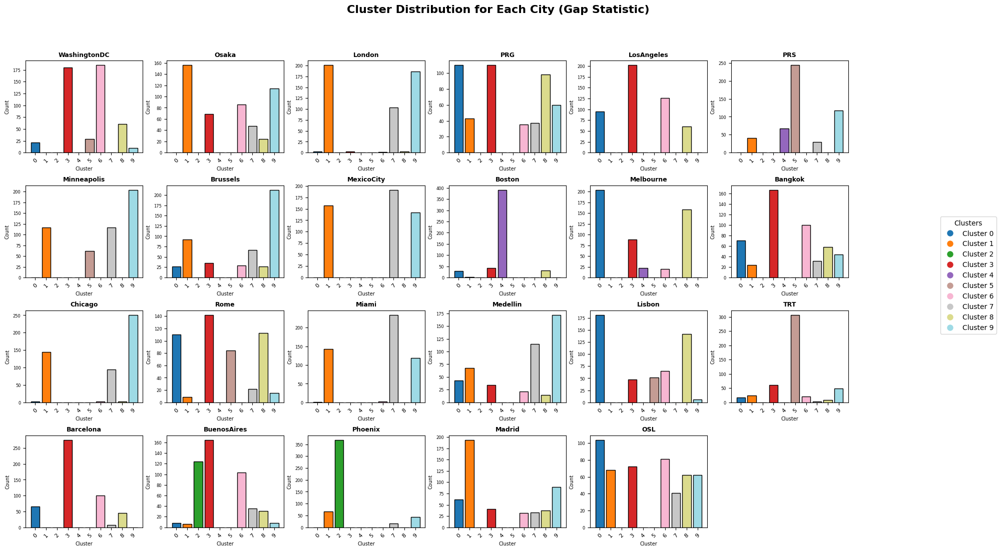

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Function to calculate city cluster distribution
def calculate_city_cluster_distribution(labels, image_names):
    city_cluster_distribution = {}
    for i, city in enumerate(image_names):
        city_name = city.split('_')[0]  # Assuming the city name is the first part of the image name
        if city_name not in city_cluster_distribution:
            city_cluster_distribution[city_name] = []
        city_cluster_distribution[city_name].append(labels[i])

    city_cluster_counts = {}
    for city, clusters in city_cluster_distribution.items():
        cluster_counts = np.bincount(clusters, minlength=len(set(labels)))
        city_cluster_counts[city] = cluster_counts

    return city_cluster_counts

# Bar Charts for Gap Statistic clustering method
method = "Gap Statistic"
result = kmeans_results[method]
n_clusters = optimal_clusters_methods[method]

# Calculate city cluster distribution
city_cluster_counts = calculate_city_cluster_distribution(result["labels"], image_names)

# Plot bar charts as subplots
num_cities = len(city_cluster_counts)
cols = 6  # Number of columns for smaller subplots
rows = (num_cities + cols - 1) // cols  # Calculate rows based on cities and columns

fig, axes = plt.subplots(rows, cols, figsize=(20, rows * 2.8))  # Adjust overall size
fig.suptitle(f"Cluster Distribution for Each City ({method})", fontsize=16, fontweight='bold')

# Flatten axes for easier iteration
axes = axes.flatten()

# Define a color map with distinct colors for each cluster
colors = plt.cm.get_cmap('tab20', n_clusters)  # 'tab20' has 20 distinct colors
# Plot each city's distribution
for idx, (city, counts) in enumerate(city_cluster_counts.items()):
    bars = axes[idx].bar(range(len(counts)), counts, color=colors(range(len(counts))), edgecolor='black')
    axes[idx].set_title(city, fontsize=9, fontweight='bold')
    axes[idx].set_xlabel("Cluster", fontsize=7)
    axes[idx].set_ylabel("Count", fontsize=7)
    axes[idx].set_xticks(range(len(counts)))
    axes[idx].set_xticklabels([f'{i}' for i in range(len(counts))], fontsize=8, rotation=45)
    axes[idx].tick_params(axis='y', labelsize=6)

# Remove empty subplots
for idx in range(len(city_cluster_counts), len(axes)):
    fig.delaxes(axes[idx])

# Create a custom legend for all clusters (one legend for all plots)
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=colors(i), markersize=10) for i in range(n_clusters)]
labels = [f'Cluster {i}' for i in range(n_clusters)]

# Add the legend outside the figure
fig.legend(handles, labels, loc='center right', title="Clusters", fontsize=10)

plt.tight_layout()
plt.subplots_adjust(top=0.88, right=0.85)
plt.show()


### Cities Grouped by Gap Statistic Method Clustering

---

- **Cluster 0**:  
  - **Prague**, **Melbourne**, **Lisbon**, **Oslo**  
  These cities share a strong presence in **Cluster 0**, indicating they share clustering traits or features that align them in this category.

- **Cluster 1**:  
  - **Osaka**, **London**, **Mexico City**, **Madrid**  
  These cities are strongly represented in **Cluster 1**, suggesting they share similar features or behaviors that categorize them into this group.

- **Cluster 2**:  
  - **Phoenix**  
  **Phoenix** stands out as the primary city in **Cluster 2**, with some images of **Boston** also included, indicating it has a unique clustering pattern compared to other cities.

- **Cluster 3**:  
  - **Washington DC**, **Prague**, **Barcelona**, **Buenos Aires**  
  These cities share a strong presence in **Cluster 3**, suggesting they have a similar clustering pattern that sets them apart from other cities.

- **Cluster 4**:  
  - **Boston**  
  **Boston** is the only city in **Cluster 4**, showing a unique clustering pattern compared to other cities.

- **Cluster 5**:  
  - **Prague**, **TRT**  
  These cities are represented in **Cluster 5**, with **Prague** and **TRT** showing a notable similarity in their cluster distribution.

- **Cluster 6**:  
  - **Oslo**, **Bangkok**  
  These cities show a strong presence in **Cluster 6**, indicating they share clustering traits or features.

- **Cluster 7**:  
  - **Mexico City**, **Miami**, **Medellin**  
  Cities in **Cluster 7** exhibit a common trend, suggesting they share similar clustering patterns that set them apart from other cities.

- **Cluster 8**:  
  - **Melbourne**, **Lisbon**, **Oslo**, **Rome**, **Medellin**, **Brussels**, **London**, **Mexico City**  
  These cities exhibit common trends, suggesting they share a clustering pattern that distinguishes them from other cities.

- **Cluster 9**:  
  - **Minneapolis**, **Medellin**, **Brussels**,
  These cities exhibit common trends, suggesting they share a clustering pattern that distinguishes them from other cities.

## Cluster Statistics per Method
---


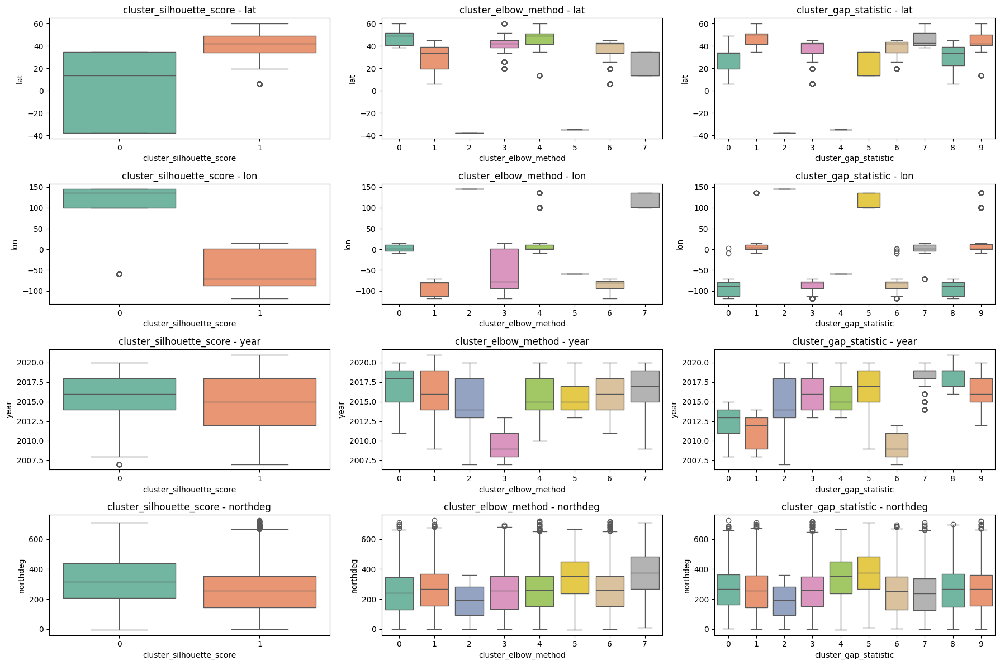

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the DataFrame
cluster_stats = pd.read_pickle('/content/drive/My Drive/PDS_A3/updated_sampled_images_and_metadata.pkl')

# List of cluster columns (clustering methods)
cluster_columns = ['cluster_silhouette_score', 'cluster_elbow_method', 'cluster_gap_statistic']

# Get the columns of interest for analysis
columns_of_interest = ['place_id', 'year', 'month', 'northdeg', 'city_id', 'lat', 'lon', 'panoid', 'image_name', 'image_path']

# Selected features for visualization
selected_features = ['lat', 'lon', 'year', 'northdeg']

# Create a grid for subplots (4 rows and 3 columns for each clustering method and feature)
fig, axes = plt.subplots(len(selected_features), len(cluster_columns), figsize=(18, 12))
plt.tight_layout(pad=4.0)  # Adjust padding between subplots

# Loop through each clustering method and each selected feature
for i, method in enumerate(cluster_columns):
    for j, feature in enumerate(selected_features):
        # Create boxplot for current feature and clustering method
        sns.boxplot(data=cluster_stats, x=method, y=feature, palette="Set2", hue=method, ax=axes[j, i], legend=False)

        # Set title and labels for each subplot
        axes[j, i].set_title(f"{method} - {feature}")
        axes[j, i].set_xlabel(f"{method}")
        axes[j, i].set_ylabel(f"{feature}")

# Adjust layout to fit everything
plt.tight_layout()
plt.show()


# 5. Conclusion:


## Overview of the "GSV Cities" Dataset and Preprocessing
The GSV Cities dataset contains metadata (`place_id`, `year`, etc.) and images categorized by cities.  
Preprocessing steps include downloading data, sampling images, merging data, removing duplicates, and resizing images for clustering.

### Initial Dataset Distribution
The dataset originally contained **640,537 images** across 23 cities:
- **Smallest city**: Medellin with **6,024 images**.
- **Largest city**: London with **58,672 images**.
- **Range of images per city**: **6,024 to 58,672**.
- **Average images per city**: Approximately **27,850 images**.

#####This uneven distribution creates significant imbalances, with cities like **London**, **Miami**, and **Phoenix** dominating the dataset, while smaller cities like **Medellin** and **Los Angeles** are underrepresented.
---
### Why Sample 500 Images Per City?
1. **Fair Representation**: Ensures equal contribution from all cities, preventing dominant cities like **London** and **Miami** from biasing clustering results.
2. **Meaningful Clusters**: Reduces the risk of clusters reflecting data imbalance rather than inherent patterns in the images.
3. **Improved Interpretability**: Clusters provide balanced insights across all cities.
4. **Efficiency**: Reduces the dataset size to almost **11,500 images** (500 per city), making computations faster and more manageable.
5. **Better Initialization**: Prevents centroids from being disproportionately influenced by overrepresented cities.

Balancing the dataset ensures fair, efficient, and meaningful clustering results.

---
## Exploratory Data Analysis Overview
- **Dataset Overview**:  
  11,309 rows spanning 2007–2021 with geographical coverage from -37.85° to 59.96° latitude and -118.27° to 145.02° longitude.

- **Visualizations**:  
  - Temporal trends in data collection.  
  - Geographical scatter plots.  
  - KMeans clustering reveals distinct clusters.  
  - Folium maps for spatial insights.

- **Insights**:  
  Seasonal and geographical patterns influence data distribution, with biases evident in certain clusters.

---

## Methods for Clustering Evaluation and Visualization
1. **Silhouette Score**: Evaluates separation quality; optimal clusters are well-separated.
2. **Elbow Method**: Identifies the "elbow point" for efficient clustering.
3. **Gap Statistic**: Provides statistically robust clustering estimates.
4. **City Cluster Distributions**: Examines clustering across cities using bar charts and heatmaps.

---
### Why ResNet-101 for Feature Extraction in Image Clustering?

You chose **ResNet-101** because it efficiently extracts meaningful features for clustering. Key reasons include:

1. **Rich Features**: Its 101 layers capture both low-level details (e.g., edges) and high-level patterns (e.g., objects).
2. **Residual Connections**: Improve training stability and ensure robust feature learning.
3. **Pretrained on ImageNet**: Provides high-quality, transferable features without extra training.
4. **Efficient for Clustering**: Outputs compact feature vectors ideal for clustering algorithms like KMeans.
5. **Proven Success**: Widely used for similar tasks with large datasets.

---

### Summary of Clustering Methods

#### **Silhouette Score Method Clustering:**
- **Cluster 0:** Phoenix, Boston, TRT, PRS share a similar clustering distribution.
- **Cluster 1:** Osaka, London, PRG, Los Angeles, Minneapolis, Brussels, Mexico City, Melbourne, Bangkok, Chicago, Lisbon, OSL form a large cluster with common clustering traits.
--
#### **Elbow Method Clustering:**
- **Cluster 0:** Mexico City, Miami, Medellin exhibit similar features.
- **Cluster 1:** Prague, Melbourne, Lisbon, Oslo share clustering traits.
- **Cluster 2:** Phoenix stands alone, showing a unique clustering pattern.
- **Cluster 3:** Washington DC, Osaka, Oslo share similar clustering patterns.
- **Cluster 4:** London, Minneapolis, Brussels, Medellin, Chicago, Madrid form a distinct group.
- **Cluster 5:** Boston stands alone with unique features.
- **Cluster 6:** Buenos Aires, Barcelona, Washington, Los Angeles show common trends.
- **Cluster 7:** Prague, TRT have a shared clustering pattern.
--
#### **Gap Statistic Method Clustering:**
- **Cluster 0:** Prague, Melbourne, Lisbon, Oslo show similar clustering traits.
- **Cluster 1:** Osaka, London, Mexico City, Madrid share common features.
- **Cluster 2:** Phoenix stands alone, with a unique clustering pattern.
- **Cluster 3:** Washington DC, Prague, Barcelona, Buenos Aires share similar clustering patterns.
- **Cluster 4:** Boston stands alone with distinct features.
- **Cluster 5:** Prague, TRT show a notable similarity.
- **Cluster 6:** Oslo, Bangkok share similar traits.
- **Cluster 7:** Mexico City, Miami, Medellin exhibit common clustering patterns.
- **Cluster 8:** Melbourne, Lisbon, Oslo, Rome, Medellin, Brussels, London, Mexico City share clustering features.
- **Cluster 9:** Minneapolis, Medellin, Brussels show common clustering trends.

--

### Evaluation of Three Clustering Models:
1. **Silhouette Score with 2 Clusters**:  

This method groups cities based on how similar they are within their clusters and how distinct the clusters are from each other. It divides cities into urban and suburban clusters, with the urban areas characterized by high population density and commercial activity, while suburban areas are more spread out and residential. Cities like Washington DC and London are grouped as urban, while cities like Phoenix and Buenos Aires are categorized as suburban.


2. **Elbow Method with 7 Clusters**:  

The Elbow Method determines the optimal number of clusters by analyzing the within-cluster sum of squares. It clusters cities into urban and suburban areas with varying levels of infrastructure and traffic, with some clusters representing quieter suburban areas and others busy, high-traffic urban zones. The method distinguishes cities like Boston and Phoenix in suburban clusters, while Washington DC and London are placed in urban clusters.


3. **Gap Statistic Method with 10 Clusters**:

The Gap Statistic compares the observed clustering to a random uniform distribution to determine the ideal number of clusters. This method identifies distinct groups based on population density, residential vs. commercial balance, and traffic levels. Cities like Osaka and Mexico City are grouped in urban clusters, while suburban areas like Boston and Phoenix form separate groups, based on unique clustering characteristics.









---
# Part 3: End Application
---

## InterAnnotator Agreement Analysis

## Download and Store Images

In [ ]:
"""
import os
import pandas as pd
import requests
from PIL import Image
from io import BytesIO

# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Define paths
base_path = '/content/drive/My Drive/PDS_A3/Part_3/student_annotations'
output_dir = '/content/drive/My Drive/PDS_A3/Part_3/annotated_images'

# Check if base path exists
if not os.path.exists(base_path):
    raise FileNotFoundError(f"The directory {base_path} does not exist. Please check the path.")

# Create the output directory if it doesn't exist
os.makedirs(output_dir, exist_ok=True)

# Get the first Excel file in the directory
xlsx_files = [f for f in os.listdir(base_path) if f.endswith('.xlsx')]
if not xlsx_files:
    raise FileNotFoundError(f"No Excel files found in the directory {base_path}.")
first_xlsx = os.path.join(base_path, xlsx_files[0])

# Load the first Excel file and skip the first row
df = pd.read_excel(first_xlsx, skiprows=1)

# Clean column names to remove whitespace
df.columns = df.columns.str.strip()

# Debug: Print column names to confirm "Image URL" exists
print("Column names in the DataFrame:", df.columns)

# Ensure the "Image URL" column exists
if 'Image URL' not in df.columns:
    raise KeyError("The column 'Image URL' does not exist in the Excel file. Check your file format.")

# Filter out rows with missing or invalid URLs
df = df[df['Image URL'].notnull()]

# Iterate through the "Image URL" column and download images
for index, image_url in df['Image URL'].items():
    try:
        # Fetch the image from the URL
        response = requests.get(image_url.strip())  # Strip any whitespace from the URL
        response.raise_for_status()

        # Save the image
        image = Image.open(BytesIO(response.content))
        output_path = os.path.join(output_dir, f"image_{index + 1}.jpg")
        image.save(output_path)
        print(f"Saved: {output_path}")
    except Exception as e:
        print(f"Failed to download image from {image_url}. Error: {e}")
"""

'\nimport os\nimport pandas as pd\nimport requests\nfrom PIL import Image\nfrom io import BytesIO\n\n# Mount Google Drive\nfrom google.colab import drive\ndrive.mount(\'/content/drive\')\n\n# Define paths\nbase_path = \'/content/drive/My Drive/PDS_A3/Part_3/student_annotations\'\noutput_dir = \'/content/drive/My Drive/PDS_A3/Part_3/annotated_images\'\n\n# Check if base path exists\nif not os.path.exists(base_path):\n    raise FileNotFoundError(f"The directory {base_path} does not exist. Please check the path.")\n\n# Create the output directory if it doesn\'t exist\nos.makedirs(output_dir, exist_ok=True)\n\n# Get the first Excel file in the directory\nxlsx_files = [f for f in os.listdir(base_path) if f.endswith(\'.xlsx\')]\nif not xlsx_files:\n    raise FileNotFoundError(f"No Excel files found in the directory {base_path}.")\nfirst_xlsx = os.path.join(base_path, xlsx_files[0])\n\n# Load the first Excel file and skip the first row\ndf = pd.read_excel(first_xlsx, skiprows=1)\n\n# Clean co

## Import Libraries and Mount Google Drive

In [6]:
import os
import pandas as pd
from sklearn.metrics import cohen_kappa_score
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


##  Define Paths and Check Directory

In [7]:
# Define paths
base_path = '/content/drive/My Drive/PDS_A3/Part_3/student_annotations'
output_dir = '/content/drive/My Drive/PDS_A3/Part_3/annotated_results'

# Check if base path exists
if not os.path.exists(base_path):
    raise FileNotFoundError(f"The directory {base_path} does not exist. Please check the path.")

# Create the output directory if it doesn't exist
os.makedirs(output_dir, exist_ok=True)

# Initialize a list to store all annotations
all_annotations_list = []


## Process Each Excel File

In [8]:
# Get all `.xlsx` files in the directory
xlsx_files = [f for f in os.listdir(base_path) if f.endswith('.xlsx')]
if not xlsx_files:
    raise FileNotFoundError(f"No Excel files found in the directory {base_path}.")

for xlsx_file in xlsx_files:
    print(f"Processing file: {xlsx_file}")
    file_path = os.path.join(base_path, xlsx_file)

    # Extract annotator ID from filename
    annotator_id = os.path.splitext(xlsx_file)[0]

    # Load the Excel file
    df = pd.read_excel(file_path, skiprows=1)

    # Clean column names
    df.columns = df.columns.str.strip()

    # Ensure the necessary columns exist
    required_columns = ['Image URL', 'Categorie', 'Other...']
    if not all(col in df.columns for col in required_columns):
        raise KeyError(f"One or more required columns {required_columns} are missing in {xlsx_file}.")

    # Add image_id as a new column
    df['image_id'] = [f"image_{i + 1}" for i in range(len(df))]

    # Split multiple categories into lists for both 'Categorie' and 'Other...'
    df['Categories'] = df['Categorie'].apply(lambda x: [cat.strip() for cat in str(x).split(',')] if pd.notnull(x) else [])
    df['Other_Categories'] = df['Other...'].apply(lambda x: [cat.strip() for cat in str(x).split(',')] if pd.notnull(x) else [])

    # Combine annotations from 'Categorie' and 'Other...'
    df['Combined_Categories'] = df.apply(lambda row: list(set(row['Categories'] + row['Other_Categories'])), axis=1)

    # Add annotator ID as a column
    df['Annotator ID'] = annotator_id

    # Append to the annotations list
    all_annotations_list.append(df[['image_id', 'Image URL', 'Annotator ID', 'Combined_Categories']])

# Combine all annotations into a single DataFrame
all_annotations_df = pd.concat(all_annotations_list, ignore_index=True)

# Display the combined DataFrame
from IPython.display import display
print("Combined Annotations DataFrame:")
display(all_annotations_df)


Processing file: f3352406.xlsx
Processing file: f3352411.xlsx
Processing file: f3352407.xlsx
Processing file: f3210105.xlsx
Processing file: f3352316.xlsx
Processing file: f3352404.xlsx
Processing file: f3352409.xlsx
Processing file: f3352405.xlsx
Processing file: f3352401.xlsx
Processing file: f3352402.xlsx
Processing file: f3352403.xlsx
Processing file: f3352410.xlsx
Combined Annotations DataFrame:


,image_id,Image URL,Annotator ID,Combined_Categories
0,image_1,https://drive.google.com/uc?export=view&id=1SN...,f3352406,"[Parked Vehicles Obstructing Sidewalks, Narrow..."
1,image_2,https://drive.google.com/uc?export=view&id=1mr...,f3352406,"[Parked Vehicles Obstructing Sidewalks, Narrow..."
2,image_3,https://drive.google.com/uc?export=view&id=1x2...,f3352406,"[Parked Vehicles Obstructing Sidewalks, Narrow..."
3,image_4,https://drive.google.com/uc?export=view&id=135...,f3352406,"[Parked Vehicles Obstructing Sidewalks, Debris..."
4,image_5,https://drive.google.com/uc?export=view&id=15_...,f3352406,"[Parked Vehicles Obstructing Sidewalks, Narrow..."
...,...,...,...,...
1483,image_120,https://drive.google.com/uc?export=view&id=1IW...,f3352410,"[Parked Vehicles Obstructing Sidewalks, Obstac..."
1484,image_121,https://drive.google.com/uc?export=view&id=1SJ...,f3352410,"[Parked Vehicles Obstructing Sidewalks, Narrow..."
1485,image_122,https://drive.google.com/uc?export=view&id=1Vg...,f3352410,[Blocked or Limited Crossing Access]
1486,image_123,https://drive.google.com/uc?export=view&id=1lK...,f3352410,"[Parked Vehicles Obstructing Sidewalks, Obstac..."


##Ground Truth


In [9]:
import pandas as pd

# Extract all unique categories
unique_categories = set(cat for cats in all_annotations_df['Combined_Categories'] for cat in cats)

# Create a binary matrix for each category
category_matrices = {}
for category in unique_categories:
    # Generate a binary matrix for each category (1 if the category is present, else 0)
    category_matrix = pd.pivot_table(
        all_annotations_df.explode('Combined_Categories'),
        index='image_id',
        columns='Annotator ID',
        values='Combined_Categories',
        aggfunc=lambda x: category in x.values if x is not None else False,
        fill_value=0
    )
    category_matrices[category] = category_matrix.astype(int)

# Now, compute the ground truth for each image by determining if the category was annotated by a majority of annotators
ground_truth = pd.DataFrame(index=category_matrices[category].index)

for category, matrix in category_matrices.items():
    # Majority voting: ground truth is 1 if more than half of annotators assigned the category to the image
    majority = (matrix.sum(axis=1) > (matrix.shape[1] / 2)).astype(int)
    ground_truth[category] = majority

# Display the ground truth for each image and category
display(ground_truth)


,Parked Vehicles Obstructing Sidewalks,Blocked or Limited Crossing Access,Restaurant chairs could narrow sidewalk space,Inaccesible for people with disabilities,ramp inaccesible for people with disabilities due to parked cars,Narrow or Limited Sidewalk Space,Debris and Environmental Hazards,Obstacles from Natural Elements,Miscellaneous Obstructions,None,Other... (Write in column D),Uneven or Hazardous Pavement
image_id,,,,,,,,,,,,
image_1,1,0,0,0,0,1,1,0,0,0,0,0
image_10,1,0,0,0,0,1,1,0,0,0,0,0
image_100,1,0,0,0,0,0,0,0,0,0,0,0
image_101,0,1,0,0,0,0,0,0,0,0,0,0
image_102,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
image_95,1,0,0,0,0,0,1,0,0,0,0,0
image_96,1,0,0,0,0,0,1,0,0,0,0,0
image_97,0,0,0,0,0,0,0,0,0,0,0,0


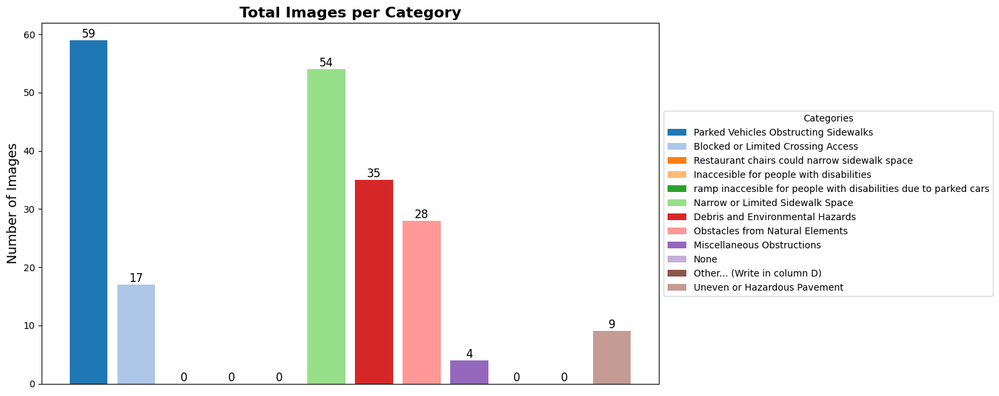

In [10]:
import matplotlib.pyplot as plt
import seaborn as sns

# Count the total number of images for each category (sum of 1s for each category)
category_counts = ground_truth.sum(axis=0)

# Convert the series to a DataFrame for better visualization
category_stats_df = category_counts.reset_index()
category_stats_df.columns = ['Category', 'Total Images']

# Plot: Total Images per Category
plt.figure(figsize=(15, 6))  # Increased size for better visualization
colors = sns.color_palette("tab20", len(category_stats_df))  # Generate colors using Seaborn palette
bars = plt.bar(category_stats_df["Category"], category_stats_df["Total Images"], color=colors)

# Annotate bars with exact values
for bar, value in zip(bars, category_stats_df["Total Images"]):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height(), f"{value}", ha="center", va="bottom", fontsize=12)

# Create a legend explaining category colors
plt.title("Total Images per Category", fontsize=16, weight='bold')
plt.ylabel("Number of Images", fontsize=14)
plt.xticks([])  # Remove x-axis labels
plt.legend(bars, category_stats_df["Category"], title="Categories", loc="center left", bbox_to_anchor=(1, 0.5))
plt.tight_layout()  # Adjust layout to avoid overlap
plt.show()


## Compute Inter-Annotator Agreement and Cohen's Kappa

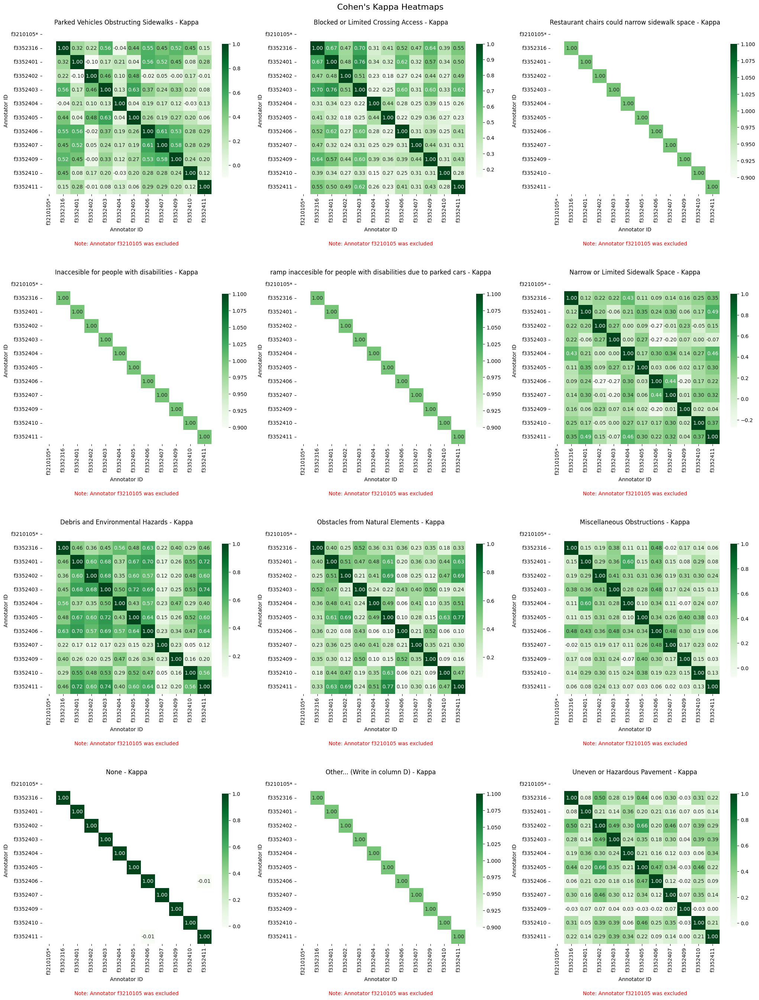

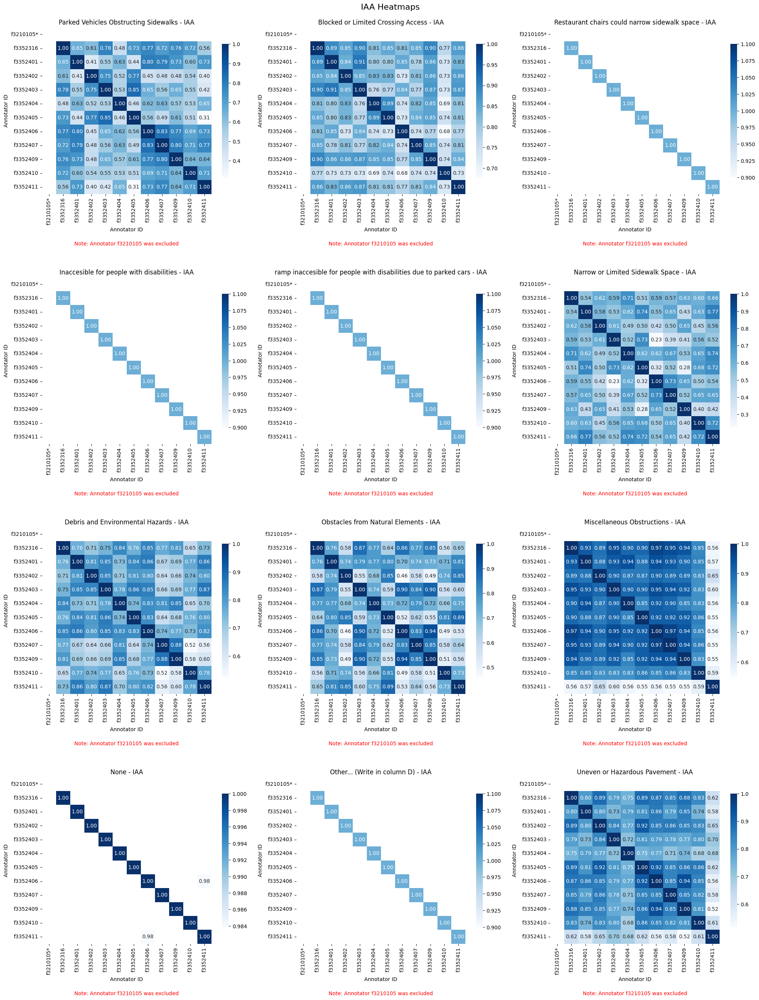

In [11]:
# Plot Cohen's Kappa and IAA heatmaps in subplots with 3 plots per row
plots_per_row = 3  # Fixed number of plots per row
rows = int(np.ceil(len(category_matrices) / plots_per_row))  # Compute the number of rows

# Create subplots for Cohen's Kappa and IAA
fig_kappa, axes_kappa = plt.subplots(rows, plots_per_row, figsize=(25, rows * 8))
fig_iaa, axes_iaa = plt.subplots(rows, plots_per_row, figsize=(25, rows * 8))

# Flatten the axes for easy indexing
axes_kappa = axes_kappa.flatten()
axes_iaa = axes_iaa.flatten()

# Iterate over categories to compute and plot heatmaps
for idx, (category, matrix) in enumerate(category_matrices.items()):
    annotators = matrix.columns
    num_annotators = len(annotators)
    kappa_matrix = np.zeros((num_annotators, num_annotators))
    iaa_matrix = np.zeros((num_annotators, num_annotators))

    # Compute Cohen's Kappa and IAA for each pair of annotators
    for i, annotator1 in enumerate(annotators):
        for j, annotator2 in enumerate(annotators):
            if annotator1 == 'f3210105' or annotator2 == 'f3210105':
                kappa_matrix[i, j] = np.nan  # Mark as not computable
                iaa_matrix[i, j] = np.nan    # Mark as not computable
            elif i == j:
                kappa_matrix[i, j] = 1.0  # Perfect agreement
                iaa_matrix[i, j] = 1.0    # Perfect agreement
            else:
                # Filter out invalid comparisons
                if matrix[annotator1].sum() == 0 or matrix[annotator2].sum() == 0:
                    kappa_matrix[i, j] = np.nan
                    iaa_matrix[i, j] = np.nan
                else:
                    # Compute Cohen's Kappa
                    kappa_matrix[i, j] = cohen_kappa_score(matrix[annotator1], matrix[annotator2])
                    # Compute Percentage Agreement (IAA)
                    agreement = (matrix[annotator1] == matrix[annotator2]).sum() / len(matrix)
                    iaa_matrix[i, j] = agreement

    # Convert to DataFrames for visualization
    kappa_df = pd.DataFrame(kappa_matrix, index=annotators, columns=annotators)
    iaa_df = pd.DataFrame(iaa_matrix, index=annotators, columns=annotators)

    # Annotate excluded annotator
    annotator_labels = [
        f"{annotator}*" if annotator == 'f3210105' else annotator
        for annotator in annotators
    ]

    # Plot Cohen's Kappa heatmap
    sns.heatmap(
        kappa_df,
        annot=True,
        fmt=".2f",
        cmap="Greens",  # Color scheme for Kappa
        cbar_kws={"shrink": 0.8},  # Smaller colorbar
        xticklabels=annotator_labels,
        yticklabels=annotator_labels,
        mask=np.isnan(kappa_df),
        ax=axes_kappa[idx]
    )
    axes_kappa[idx].set_title(f"{category} - Kappa", fontsize=12)
    axes_kappa[idx].tick_params(axis='both', which='major', labelsize=10)
    axes_kappa[idx].text(
        0.5, -0.3,  # Position below the plot
        "Note: Annotator f3210105 was excluded",
        ha='center', va='center', transform=axes_kappa[idx].transAxes, fontsize=10, color='red'
    )

    # Plot IAA heatmap
    sns.heatmap(
        iaa_df,
        annot=True,
        fmt=".2f",
        cmap="Blues",  # Color scheme for IAA
        cbar_kws={"shrink": 0.8},  # Smaller colorbar
        xticklabels=annotator_labels,
        yticklabels=annotator_labels,
        mask=np.isnan(iaa_df),
        ax=axes_iaa[idx]
    )
    axes_iaa[idx].set_title(f"{category} - IAA", fontsize=12)
    axes_iaa[idx].tick_params(axis='both', which='major', labelsize=10)
    axes_iaa[idx].text(
        0.5, -0.3,  # Position below the plot
        "Note: Annotator f3210105 was excluded",
        ha='center', va='center', transform=axes_iaa[idx].transAxes, fontsize=10, color='red'
    )

# Remove unused subplots
for idx in range(len(category_matrices), len(axes_kappa)):
    fig_kappa.delaxes(axes_kappa[idx])
    fig_iaa.delaxes(axes_iaa[idx])

# Adjust layout: reduce gap between main title and plots
fig_kappa.suptitle("Cohen's Kappa Heatmaps", fontsize=16, y=0.9)  # Main title closer to plots
fig_iaa.suptitle("IAA Heatmaps", fontsize=16, y=0.9)  # Main title closer to plots

fig_kappa.subplots_adjust(hspace=0.5)  # Add vertical spacing between rows
fig_iaa.subplots_adjust(hspace=0.5)  # Add vertical spacing between rows

plt.show()


### Cohen's Kappa and IAA Analysis

#### Moderate to High Agreement:
- **Blocked or Limited Crossing Access**
- **Debris and Environmental Hazards**
- **Obstacles from Natural Elements**
- **Narrow or Limited Sidewalk Space**
- **Parked Vehicles Obstructing Sidewalks**
- **Uneven or Hazardous Pavement**
- **Miscellaneous Obstructions**

These categories show moderate to high Kappa and IAA values, indicating good agreement with some minor discrepancies.

#### Zero or Near-Zero Kappa and IAA:
- **Ramp Inaccessible for People with Disabilities Due to Parked Cars**
- **Other (Write in Column D)**
- **Restaurant Chairs Could Narrow Sidewalk Space**
- **Inaccessible for People with Disabilities**

These categories show zero Kappa and IAA scores as they were suggested by only one annotator.


## Compute and Display Category Stats

In [12]:
# Initialize a dictionary to store stats for each category
category_stats = {}

for category, matrix in category_matrices.items():
    annotators = matrix.columns
    num_annotators = len(annotators)
    kappa_values = []
    iaa_values = []
    total_images = (matrix.sum(axis=1) > 0).sum()  # Count images with at least one annotation
    unique_annotators = (matrix.sum(axis=0) > 0).sum()  # Count annotators who contributed

    # Compute Cohen's Kappa and IAA for each pair of annotators
    for i, annotator1 in enumerate(annotators):
        for j, annotator2 in enumerate(annotators):
            if i >= j:  # Avoid duplicate pairs
                continue
            if annotator1 == 'f3210105' or annotator2 == 'f3210105':
                continue  # Skip excluded annotator
            if matrix[annotator1].sum() == 0 or matrix[annotator2].sum() == 0:
                continue  # Skip if either annotator has no annotations

            # Compute Cohen's Kappa
            kappa = cohen_kappa_score(matrix[annotator1], matrix[annotator2])
            kappa_values.append(kappa)

            # Compute IAA (Percentage Agreement)
            agreement = (matrix[annotator1] == matrix[annotator2]).sum() / len(matrix)
            iaa_values.append(agreement)

    # Store stats for the category
    category_stats[category] = {
        "Total Images": total_images,
        "Unique Annotators": unique_annotators,
        "Mean Kappa": np.mean(kappa_values) if kappa_values else np.nan,
        "Mean IAA": np.mean(iaa_values) if iaa_values else np.nan
    }

# Convert stats dictionary to a DataFrame for display
stats_df = pd.DataFrame.from_dict(category_stats, orient='index')
stats_df.index.name = "Category"
stats_df.reset_index(inplace=True)

# Display the stats DataFrame
from IPython.display import display
print("Category Statistics:")
display(stats_df)


Category Statistics:


,Category,Total Images,Unique Annotators,Mean Kappa,Mean IAA
0,Parked Vehicles Obstructing Sidewalks,120,11,0.255162,0.623754
1,Blocked or Limited Crossing Access,74,11,0.390697,0.808504
2,Restaurant chairs could narrow sidewalk space,1,1,NaN,NaN
3,Inaccesible for people with disabilities,1,1,NaN,NaN
4,ramp inaccesible for people with disabilities ...,1,1,NaN,NaN
5,Narrow or Limited Sidewalk Space,119,11,0.149868,0.567155
6,Debris and Environmental Hazards,85,11,0.432638,0.753959
7,Obstacles from Natural Elements,92,11,0.340895,0.706745
8,Miscellaneous Obstructions,67,11,0.224328,0.840469
9,None,2,2,-0.008130,0.983871


### Total Images per Category that were annotated

This plot shows the total number of images annotated for each category.


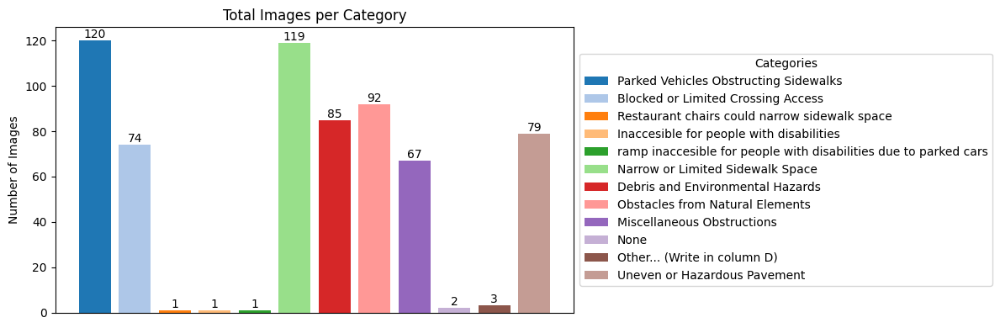

In [13]:
# Plot: Total Images per Category
plt.figure(figsize=(12, 4))  # Adjusted height
colors = sns.color_palette("tab20", len(stats_df))  # Generate colors using Seaborn palette
bars = plt.bar(stats_df["Category"], stats_df["Total Images"].fillna(0), color=colors)  # Replace NaN with 0

# Annotate bars with exact values
for bar, value in zip(bars, stats_df["Total Images"].fillna(0)):  # Replace NaN with 0
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height(), f"{value}", ha="center", va="bottom", fontsize=10)

# Create a legend explaining category colors
plt.title("Total Images per Category")
plt.ylabel("Number of Images")
plt.xticks([])
plt.legend(bars, stats_df["Category"], title="Categories", loc="center left", bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()


### Unique Annotators per Category

This plot displays the number of unique annotators who contributed to each category.


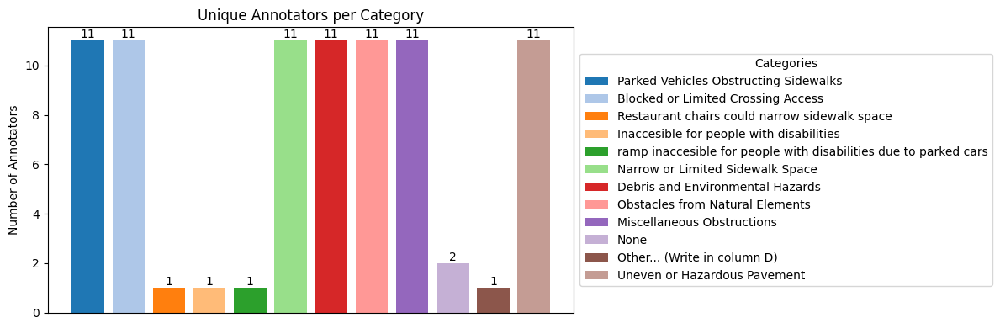

In [14]:
# Plot: Unique Annotators per Category
plt.figure(figsize=(12, 4))  # Adjusted height
colors = sns.color_palette("tab20", len(stats_df))  # Generate colors using Seaborn palette
bars = plt.bar(stats_df["Category"], stats_df["Unique Annotators"].fillna(0), color=colors)  # Replace NaN with 0

# Annotate bars with exact values
for bar, value in zip(bars, stats_df["Unique Annotators"].fillna(0)):  # Replace NaN with 0
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height(), f"{value}", ha="center", va="bottom", fontsize=10)

# Create a legend explaining category colors
plt.title("Unique Annotators per Category")
plt.ylabel("Number of Annotators")
plt.xticks([])
plt.legend(bars, stats_df["Category"], title="Categories", loc="center left", bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()


### Mean Kappa per Category


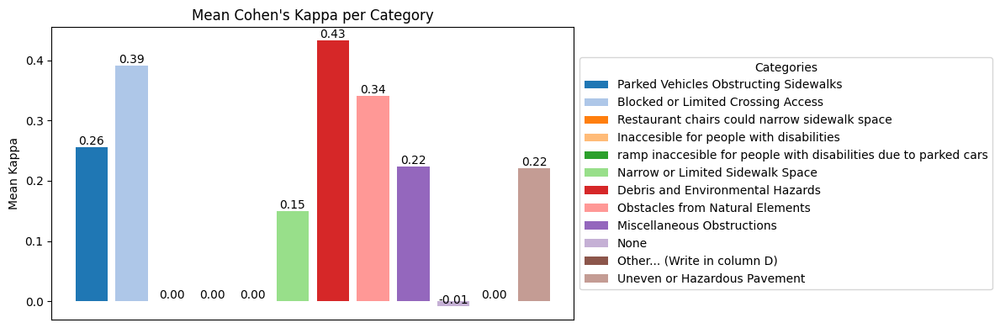

In [15]:
# Plot: Mean Kappa per Category
plt.figure(figsize=(12, 4))
colors = sns.color_palette("tab20", len(stats_df))  # Generate colors using Seaborn palette
bars = plt.bar(stats_df["Category"], stats_df["Mean Kappa"].fillna(0), color=colors)  # Replace NaN with 0

# Annotate bars with exact values
for bar, value in zip(bars, stats_df["Mean Kappa"].fillna(0)):  # Replace NaN with 0
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height(), f"{value:.2f}", ha="center", va="bottom", fontsize=10)

# Create a legend explaining category colors
plt.title("Mean Cohen's Kappa per Category")
plt.ylabel("Mean Kappa")
plt.xticks([])
plt.legend(bars, stats_df["Category"], title="Categories", loc="center left", bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()


### Mean Inter-Annotator Agreement (IAA) per Category

This plot shows the average Inter-Annotator Agreement (IAA) for each category, with colors representing the categories. The exact numbers are displayed above the bars.


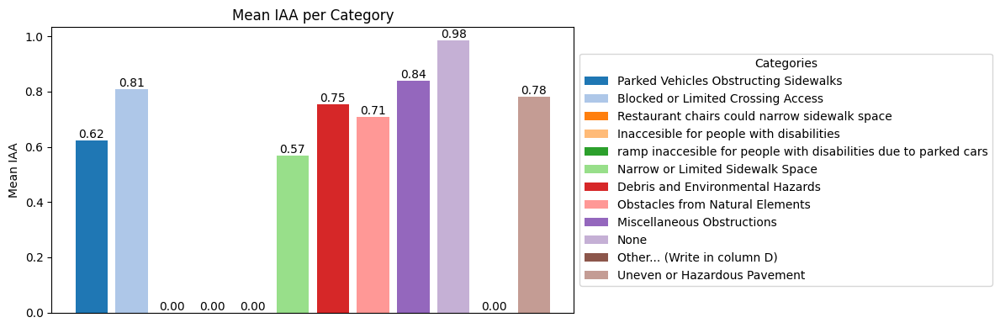

In [16]:
# Plot: Mean IAA per Category
plt.figure(figsize=(12, 4))  # Adjusted height
colors = sns.color_palette("tab20", len(stats_df))  # Generate colors using Seaborn palette
bars = plt.bar(stats_df["Category"], stats_df["Mean IAA"].fillna(0), color=colors)  # Replace NaN with 0

# Annotate bars with exact values
for bar, value in zip(bars, stats_df["Mean IAA"].fillna(0)):  # Replace NaN with 0
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height(), f"{value:.2f}", ha="center", va="bottom", fontsize=10)

# Create a legend explaining category colors
plt.title("Mean IAA per Category")
plt.ylabel("Mean IAA")
plt.xticks([])
plt.legend(bars, stats_df["Category"], title="Categories", loc="center left", bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()


### Task Difficulty Analysis

In [17]:
# Initialize a dictionary to store task difficulty metrics
task_difficulty = {}

for category, matrix in category_matrices.items():
    annotators = matrix.columns
    num_annotators = len(annotators)
    kappa_values = []
    iaa_values = []

    # Compute Cohen's Kappa and IAA for each pair of annotators
    for i, annotator1 in enumerate(annotators):
        for j, annotator2 in enumerate(annotators):
            if i >= j:  # Avoid duplicate pairs
                continue
            if annotator1 == 'f3210105' or annotator2 == 'f3210105':
                continue  # Skip excluded annotator
            if matrix[annotator1].sum() == 0 or matrix[annotator2].sum() == 0:
                continue  # Skip if either annotator has no annotations

            # Compute Cohen's Kappa
            kappa = cohen_kappa_score(matrix[annotator1], matrix[annotator2])
            kappa_values.append(kappa)

            # Compute IAA (Percentage Agreement)
            agreement = (matrix[annotator1] == matrix[annotator2]).sum() / len(matrix)
            iaa_values.append(agreement)

    # Compute disagreement rate
    disagreement_rate = 1 - matrix.sum(axis=1).mean() / num_annotators

    # Store metrics for the category
    task_difficulty[category] = {
        "Mean Kappa": np.mean(kappa_values) if kappa_values else np.nan,
        "Std Kappa": np.std(kappa_values) if kappa_values else np.nan,
        "Mean IAA": np.mean(iaa_values) if iaa_values else np.nan,
        "Std IAA": np.std(iaa_values) if iaa_values else np.nan,
        "Disagreement Rate": disagreement_rate
    }

# Convert task difficulty dictionary to a DataFrame
difficulty_df = pd.DataFrame.from_dict(task_difficulty, orient="index")
difficulty_df.index.name = "Category"
difficulty_df.reset_index(inplace=True)

# Display the task difficulty DataFrame
from IPython.display import display
print("Task Difficulty Analysis:")
display(difficulty_df)


Task Difficulty Analysis:


,Category,Mean Kappa,Std Kappa,Mean IAA,Std IAA,Disagreement Rate
0,Parked Vehicles Obstructing Sidewalks,0.255162,0.190664,0.623754,0.127476,0.481855
1,Blocked or Limited Crossing Access,0.390697,0.145262,0.808504,0.056759,0.819892
2,Restaurant chairs could narrow sidewalk space,NaN,NaN,NaN,NaN,0.999328
3,Inaccesible for people with disabilities,NaN,NaN,NaN,NaN,0.999328
4,ramp inaccesible for people with disabilities ...,NaN,NaN,NaN,NaN,0.999328
5,Narrow or Limited Sidewalk Space,0.149868,0.174756,0.567155,0.118275,0.523522
6,Debris and Environmental Hazards,0.432638,0.190171,0.753959,0.085442,0.702957
7,Obstacles from Natural Elements,0.340895,0.176660,0.706745,0.124673,0.709677
8,Miscellaneous Obstructions,0.224328,0.143030,0.840469,0.130849,0.901210
9,None,-0.008130,0.000000,0.983871,0.000000,0.998656


<ipython-input-30-2f33fc7e5fc9>:52: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


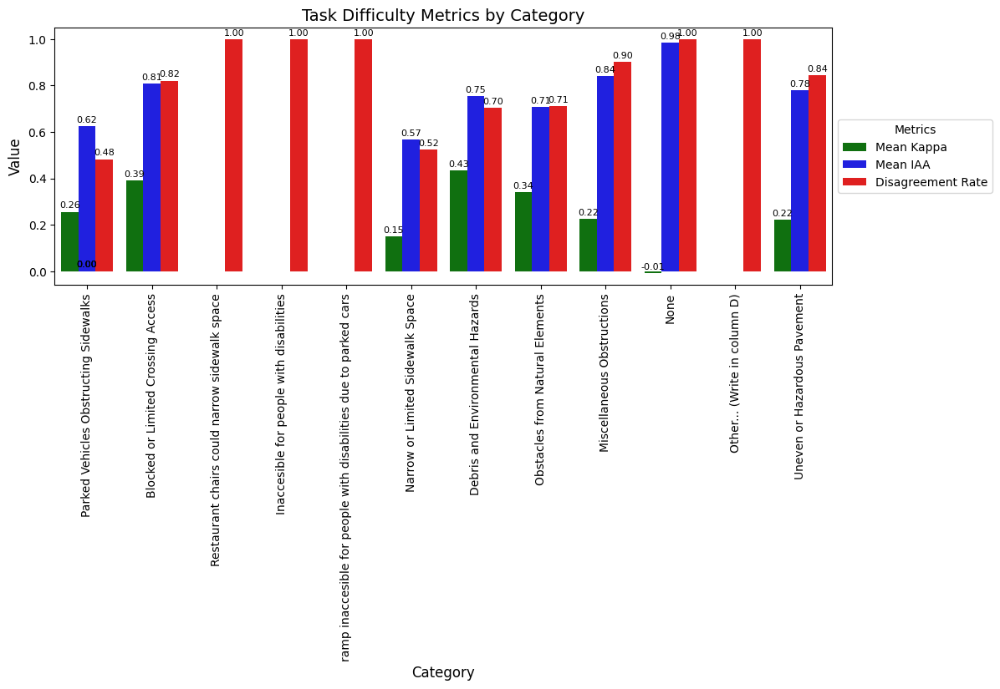

In [30]:
import seaborn as sns
import matplotlib.pyplot as plt

# Melt the DataFrame for Seaborn compatibility
difficulty_melted = difficulty_df.melt(
    id_vars="Category",
    value_vars=["Mean Kappa", "Mean IAA", "Disagreement Rate"],
    var_name="Metric",
    value_name="Value"
)

# Set the figure size
plt.figure(figsize=(12, 4))

# Create the bar plot
sns.barplot(
    data=difficulty_melted,
    x="Category",
    y="Value",
    hue="Metric",
    palette={"Mean Kappa": "green", "Mean IAA": "blue", "Disagreement Rate": "red"}
)

# Annotate exact values on the bars
for p in plt.gca().patches:
    height = p.get_height()
    if not pd.isnull(height):  # Avoid NaN or invalid heights
        plt.text(
            p.get_x() + p.get_width() / 2,  # Centered on the bar
            height + 0.01,
            f"{height:.2f}",
            ha="center",
            va="bottom",
            fontsize=8
        )

# Adjust plot aesthetics
plt.title("Task Difficulty Metrics by Category", fontsize=14)
plt.ylabel("Value", fontsize=12)
plt.xlabel("Category", fontsize=12)
plt.xticks(rotation=90)

# Move the legend outside the plot
plt.legend(
    title="Metrics",
    loc="center left",
    bbox_to_anchor=(1, 0.5),
    fontsize=10
)

# Adjust layout to prevent clipping
plt.tight_layout()
plt.show()


### Key Observations:

1. **Moderate Difficulty Categories**:
   - *Obstacles from Natural Elements*:
     - **Mean Kappa**: 0.34 (moderate agreement among annotators).
     - **Mean IAA**: 0.71.
     - **Disagreement Rate**: 71%, indicating significant annotator divergence.
   - *Debris and Environmental Hazards*:
     - **Mean Kappa**: 0.43 (higher than average agreement).
     - **Mean IAA**: 0.75.
     - **Disagreement Rate**: 70%.

2. **High-Difficulty Categories**:
   - *Parked Vehicles Obstructing Sidewalks*:
     - **Mean Kappa**: 0.26 (low annotator agreement).
     - **Mean IAA**: 0.62.
     - **Disagreement Rate**: 48%, showing significant annotator challenges.
   - *Narrow or Limited Sidewalk Space*:
     - **Mean Kappa**: 0.15 (very low agreement).
     - **Mean IAA**: 0.57.
     - **Disagreement Rate**: 52%, reflecting high task complexity.

3. **Challenging or Undefined Categories**:
   - *Other... (Write in column D)* and *None*:
     - **Mean Kappa**: Not computable (insufficient data or unclear criteria).
     - **Disagreement Rate**: Nearly 100%, reflecting confusion or inconsistent annotations.
   - *Ramp inaccessible for people with disabilities due to parked cars*:
     - Similar to the above, with **100% disagreement rate**, suggesting a lack of clarity.

4. **Relatively Easier Categories**:
   - *Miscellaneous Obstructions*:
     - **Mean Kappa**: 0.22.
     - **Mean IAA**: 0.84 (high agreement, indicating some consensus).
     - **Disagreement Rate**: 90%.
   - *Blocked or Limited Crossing Access*:
     - **Mean Kappa**: 0.39.
     - **Mean IAA**: 0.81.
     - **Disagreement Rate**: 82%, though annotators seem to converge on specific instances.

5. **High Variability in Kappa Scores**:
   - Categories such as *Uneven or Hazardous Pavement* and *Narrow or Limited Sidewalk Space*:
     - High standard deviations in Kappa scores (~0.16–0.17), reflecting inconsistent annotation behavior.

### Recommendations:
- Categories with low Kappa and high disagreement rates (e.g., *None*, *Other...*) need clearer guidelines or examples for annotators.
- Training annotators on ambiguous categories (e.g., *Ramp inaccessible...*) can help reduce confusion and improve consensus.
- Further analysis on high-variability categories could help refine task definitions and criteria.


## Clustering Annotated Images

### Extract Features Using ResNet-101



In [19]:
import torch
import torchvision.transforms as T
from PIL import Image, ImageFilter
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from tqdm import tqdm
import numpy as np
import torch.nn.functional as F

# Define a custom crop strategy for center crop with smaller dimensions
class CenterCrop:
    def __init__(self, height, width):
        self.height = height
        self.width = width

    def __call__(self, img):
        img_width, img_height = img.size
        # Calculate the position of the crop: center
        left = (img_width - self.width) // 2
        top = (img_height - self.height) // 2  # Center of the image
        right = left + self.width
        bottom = top + self.height
        return img.crop((left, top, right, bottom))

# Define a custom transformation to apply the edge detection filter
class EdgeDetection:
    def __call__(self, img):
        # Convert to grayscale and apply edge detection
        img = img.convert("L")  # Convert to grayscale
        img = img.filter(ImageFilter.FIND_EDGES)  # Apply edge detection
        img = img.convert("RGB")  # Convert back to RGB
        return img

# Define a custom transformation to apply the sharpening filter
class Sharpen:
    def __call__(self, img):
        img = img.filter(ImageFilter.SHARPEN)  # Apply sharpening
        return img

# Define transformations to preprocess images with resizing, edge detection, and normalization
transform = T.Compose([
    T.Resize((224, 224)),  # Resize all images to 224x224
    EdgeDetection(),  # Apply edge detection filter
    Sharpen(),  # Apply sharpening filter
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

### Extract Features Using the DataLoader

In [20]:
# DataLoader for batching
batch_size = 128
image_dir = '/content/drive/MyDrive/PDS_A3/Part_3/annotated_images'  # Path to images
dataset = ImageDataset(image_dir, transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False)

# Function to extract features from images
def extract_image_features(dataloader, model, device):
    features = []
    image_names = []
    model.to(device)  # Ensure the model is moved to GPU
    model.eval()  # Set the model to evaluation mode

    with torch.no_grad():
        # Wrap the dataloader with tqdm to show a progress bar
        for imgs, filenames in tqdm(dataloader, desc="Extracting Image Features", unit="batch"):
            imgs = imgs.to(device)  # Move images to GPU
            feature = model(imgs)  # Extract features using the model
            feature = F.normalize(feature, p=2, dim=1)  # L2 normalize features
            features.append(feature.cpu().numpy())  # Move features back to CPU
            image_names.extend(filenames)  # Store image filenames

    features = np.concatenate(features, axis=0)  # Concatenate all features into a single array
    return features, image_names


### Save Extracted Features and Filenames

In [21]:
# Save the extracted features to a file
def save_features(features, image_names, feature_file, name_file):
    np.save(feature_file, features)  # Save features as a .npy file
    with open(name_file, 'w') as f:
        for name in image_names:
            f.write(f"{name}\n")  # Save image filenames to a text file

# Example usage
image_features_athens, image_names_athens = extract_image_features(dataloader, model, device)

# Specify file paths to save features and image names
feature_file = '/content/drive/MyDrive/PDS_A3/Part_3/annotated_images/features_athens.npy'  # Path to save features
name_file = '/content/drive/MyDrive/PDS_A3/Part_3/annotated_images/image_names_athens.txt'  # Path to save image filenames

# Save features and filenames to the specified files
save_features(image_features_athens, image_names_athens, feature_file, name_file)


Extracting Image Features: 100%|██████████| 1/1 [01:03<00:00, 63.20s/batch]


### Apply PCA for Dimensionality Reduction

In [22]:
from google.colab import drive
import numpy as np
from sklearn.decomposition import PCA

# Mount Google Drive
drive.mount('/content/drive',force_remount=True)

# Specify file paths to load features and image names
feature_file = '/content/drive/MyDrive/PDS_A3/Part_3/annotated_images/features_athens.npy'
name_file = '/content/drive/MyDrive/PDS_A3/Part_3/annotated_images/image_names_athens.txt'

# Load features
image_features = np.load(feature_file)

# Load image names
with open(name_file, 'r') as file:
    image_names_athens = file.read().splitlines()

# Apply PCA for dimensionality reduction
n_components = 100  # Number of PCA components
pca = PCA(n_components=n_components)
features_pca = pca.fit_transform(image_features)

# Evaluate variance explained by PCA components
explained_variance_ratio = pca.explained_variance_ratio_
print(f"Explained variance ratio by PCA components: {explained_variance_ratio}")
print(f"Total variance explained by {n_components} components: {np.sum(explained_variance_ratio)}")

# Print loaded image names (optional)
print(f"Loaded {len(image_names_athens)} image names.")


Mounted at /content/drive
Explained variance ratio by PCA components: [0.19331427 0.11660236 0.08915386 0.08251589 0.0576218  0.04058544
 0.03101191 0.02898742 0.02322762 0.02006359 0.01918844 0.01752628
 0.01627195 0.01526523 0.01415011 0.01279856 0.01153196 0.0101977
 0.00993865 0.0091479  0.00878629 0.00810484 0.00780308 0.00733785
 0.0068004  0.00657028 0.006234   0.00594009 0.0054757  0.00521412
 0.00514574 0.00463492 0.00441801 0.0041975  0.00403664 0.00383898
 0.00380284 0.00371935 0.00342362 0.00335349 0.00322563 0.00317597
 0.00293057 0.00282223 0.00265368 0.00249589 0.0022938  0.00222357
 0.00218767 0.00205403 0.00190981 0.00188181 0.00180038 0.00168591
 0.0016515  0.00159081 0.00146089 0.00141524 0.0013786  0.001326
 0.0012902  0.0012745  0.00122301 0.00110706 0.00107439 0.00103227
 0.00102407 0.00094974 0.00091275 0.00085914 0.00085185 0.00082501
 0.00082214 0.00075665 0.00073215 0.00072498 0.0006711  0.00065004
 0.00062884 0.00060882 0.00058618 0.00055409 0.00054639 0.0005

### Load Saved KMeans Models

In [23]:
import joblib
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive',force_remount=True)

# Specify the directory where the models are saved
save_path = '/content/drive/MyDrive/PDS_A3/kmeans_models/'

# Dictionary to store KMeans models
kmeans_models = {}

# Load each saved KMeans model
for method in ["silhouette_score", "elbow_method", "gap_statistic"]:
    model_filename = f"{save_path}kmeans_{method}.pkl"
    kmeans_models[method] = joblib.load(model_filename)
    print(f"Loaded {method} model from {model_filename}")


Mounted at /content/drive
Loaded silhouette_score model from /content/drive/MyDrive/PDS_A3/kmeans_models/kmeans_silhouette_score.pkl
Loaded elbow_method model from /content/drive/MyDrive/PDS_A3/kmeans_models/kmeans_elbow_method.pkl
Loaded gap_statistic model from /content/drive/MyDrive/PDS_A3/kmeans_models/kmeans_gap_statistic.pkl


### Apply KMeans Clustering and Plot Cluster Counts of Athens Images

Clustering images using Silhouette Score...
Cluster labels for first 10 images: [1 1 1 1 1 1 1 1 1 1]
Clustered 124 images using Silhouette Score.
Clustering images using Elbow Method...
Cluster labels for first 10 images: [3 3 3 3 3 2 3 3 3 3]
Clustered 124 images using Elbow Method.
Clustering images using Gap Statistic...
Cluster labels for first 10 images: [2 2 2 2 2 2 4 2 2 2]
Clustered 124 images using Gap Statistic.


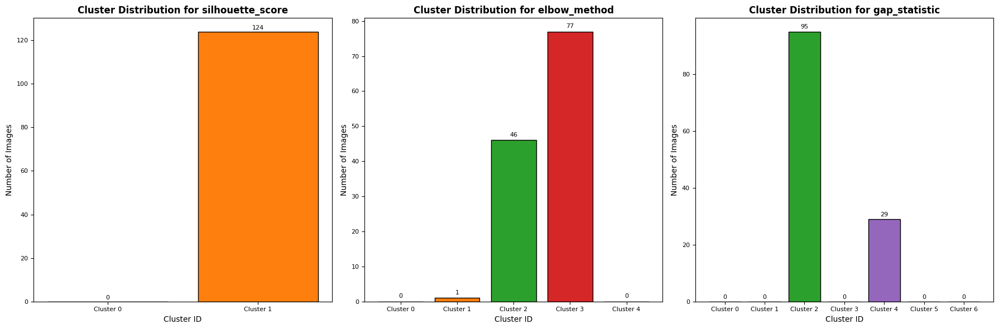

In [26]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns  # Import seaborn for the color palette

# Ensure that features_pca is of type float32
features_pca = features_pca.astype(np.float32)

# Function to plot cluster distribution (bar plot)
def plot_cluster_bar_plot(ax, method, labels, n_clusters):
    # Count the number of images per cluster
    cluster_counts = np.bincount(labels, minlength=n_clusters)

    # Get the colors from the 'tab10' color palette (maximum of 10 colors)
    colors = sns.color_palette("tab10", n_clusters)

    # Create a bar plot for the cluster distribution with different colors for each cluster
    bars = ax.bar(range(n_clusters), cluster_counts, color=colors, edgecolor='black')

    # Adding labels and title
    ax.set_title(f'Cluster Distribution for {method}', fontsize=12, fontweight='bold')
    ax.set_xlabel('Cluster ID', fontsize=10)
    ax.set_ylabel('Number of Images', fontsize=10)
    ax.set_xticks(range(n_clusters))
    ax.set_xticklabels([f'Cluster {i}' for i in range(n_clusters)], fontsize=8)
    ax.tick_params(axis='y', labelsize=8)

    # Add annotations on top of each bar to display the number of images per cluster
    for bar in bars:
        yval = bar.get_height()  # Get the height of the bar
        ax.text(bar.get_x() + bar.get_width() / 2, yval + 1, str(int(yval)), ha='center', fontsize=8)

# Apply the KMeans model to the PCA-reduced features
fig, axes = plt.subplots(1, 3, figsize=(18, 6))  # 1 row, 3 columns for subplots

for method, kmeans in kmeans_models.items():
    print(f"Clustering images using {method.replace('_', ' ').title()}...")

    # Ensure cluster_centers_ is of type float32 to match features_pca
    kmeans.cluster_centers_ = kmeans.cluster_centers_.astype(np.float32)

    # Predict using the correctly typed features
    labels = kmeans.predict(features_pca)  # Use transformed features for prediction

    # Print the cluster labels for the first 10 images
    print(f"Cluster labels for first 10 images: {labels[:10]}")

    # Create a dictionary to map image names to their cluster labels
    image_clusters = {image_names_athens[i]: labels[i] for i in range(len(image_names_athens))}
    print(f"Clustered {len(image_names_athens)} images using {method.replace('_', ' ').title()}.")

    # Directly use the n_clusters from the KMeans model
    n_clusters = kmeans.n_clusters  # Access n_clusters directly from the KMeans model

    # Plot the cluster bar plot for this method in the corresponding subplot
    ax = axes[list(kmeans_models.keys()).index(method)]  # Select the correct subplot axis
    plot_cluster_bar_plot(ax, method, labels, n_clusters)

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


Clustering images using Silhouette Score...

Displaying the closest images to each cluster center:


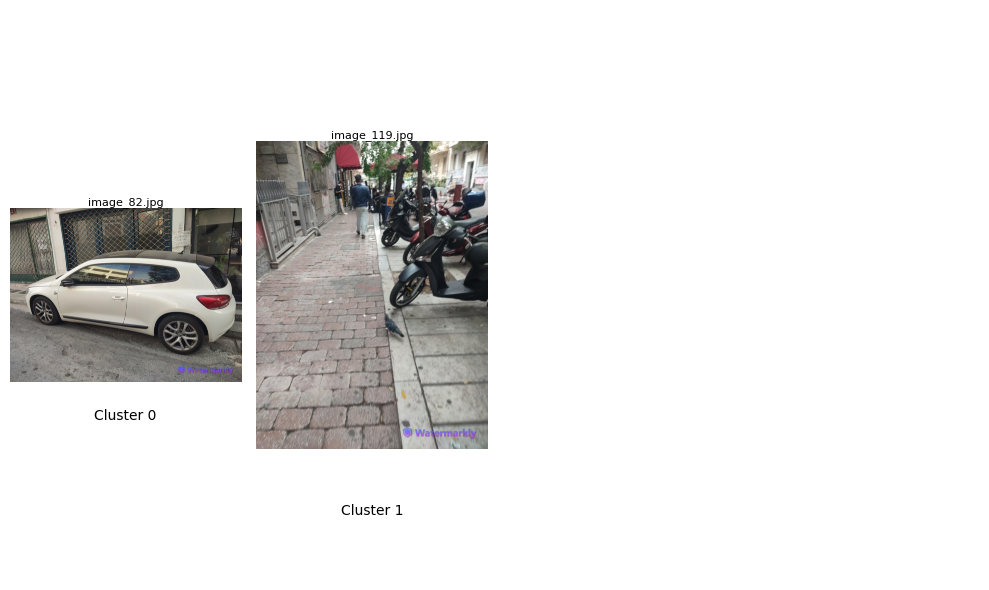

Clustering images using Elbow Method...

Displaying the closest images to each cluster center:


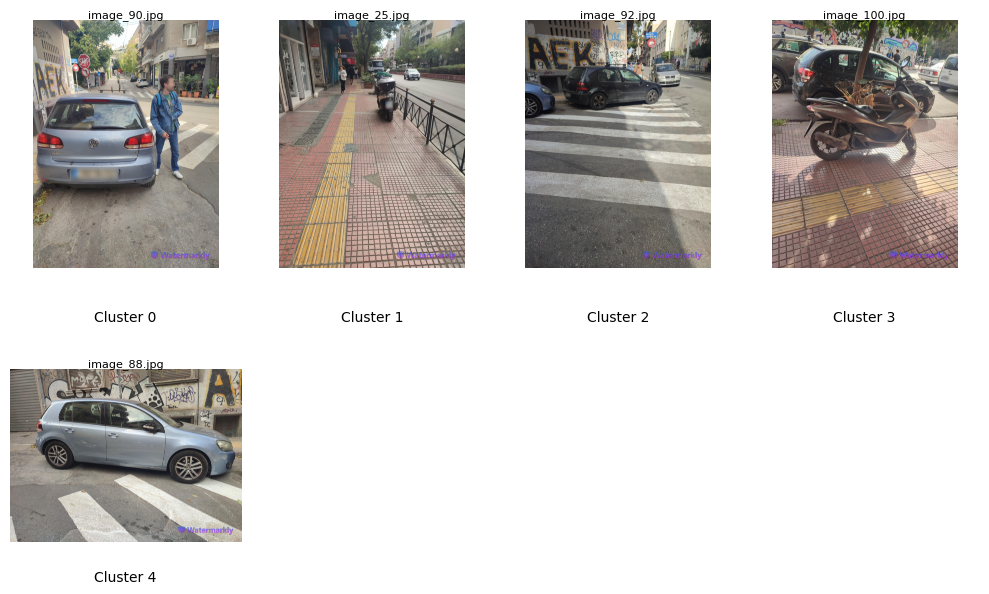

Clustering images using Gap Statistic...

Displaying the closest images to each cluster center:


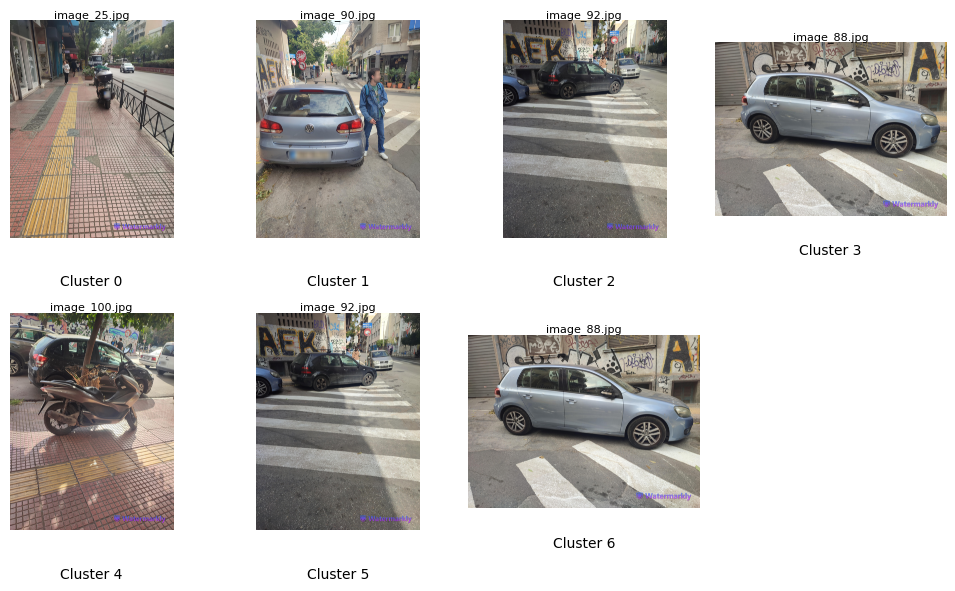

In [27]:
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns  # Import seaborn for the color palette
import textwrap
import math

# Function to get the closest images to each cluster center
def get_cluster_centers(kmeans, features, image_names):
    centers = kmeans.cluster_centers_
    closest_image_idx = []
    for center in centers:
        distances = np.linalg.norm(features - center, axis=1)
        closest_idx = np.argmin(distances)
        closest_image_idx.append(closest_idx)
    return [image_names[idx] for idx in closest_image_idx]

# Function to plot closest images to cluster centers with adaptive fig size and rows/columns
def plot_closest_images(closest_images_per_cluster, image_directory, n_clusters):
    print("\nDisplaying the closest images to each cluster center:")

    # Determine the number of rows needed for the images
    n_columns = 4  # You can change this to fit your layout preference
    n_rows = math.ceil(n_clusters / n_columns)  # Calculate the number of rows dynamically

    # Adjust figure size dynamically based on the number of clusters
    figsize_width = min(12, n_columns * 2.5)  # Width adapts based on n_columns
    figsize_height = max(6, n_rows * 3)  # Height adapts based on n_rows

    fig_images, axes_images = plt.subplots(n_rows, n_columns, figsize=(figsize_width, figsize_height))  # Adaptive size for images
    axes_images = axes_images.flatten()  # Flatten the axes for easier iteration over them

    # If there are more axes than clusters, turn off the extra axes
    for i in range(n_clusters, len(axes_images)):
        axes_images[i].axis('off')

    for i, closest_image in enumerate(closest_images_per_cluster):
        img_path = os.path.join(image_directory, closest_image)
        axes_images[i].imshow(plt.imread(img_path))
        axes_images[i].axis('off')  # Turn off axis
        # Wrap the name of the image to fit in the title
        wrapped_name = textwrap.fill(closest_image, width=25)  # Wrap the name into multiple lines
        axes_images[i].set_title(wrapped_name, fontsize=8, verticalalignment='top')

        # Display cluster information below the image
        axes_images[i].text(0.5, -0.2, f"Cluster {i}", ha='center', va='center', transform=axes_images[i].transAxes, fontsize=10)

    # Use tight_layout with smaller padding and adjust the space between subplots
    plt.tight_layout()  # Reduce the padding between elements
    plt.subplots_adjust()  # Reduce the space between subplots
    plt.show()

# Function to handle plotting for each method
def plot_method_results(method, kmeans, features_pca, image_names, image_directory):
    # Get the number of clusters for this method
    n_clusters = kmeans.n_clusters

    # Get the closest images to the cluster centers
    closest_images_per_cluster = get_cluster_centers(kmeans, features_pca, image_names)

    # Plot the closest image to each cluster center in this method
    plot_closest_images(closest_images_per_cluster, image_directory, n_clusters)

# Load image names from the text file
image_names_path = "/content/drive/My Drive/PDS_A3/Part_3/annotated_images/image_names_athens.txt"
with open(image_names_path, 'r') as file:
    image_names = file.read().splitlines()

# Directory containing the images
image_directory = "/content/drive/My Drive/PDS_A3/Part_3/annotated_images/"

# Assuming kmeans_models is already defined with models (contains KMeans for different methods)
for method, kmeans in kmeans_models.items():
    print(f"Clustering images using {method.replace('_', ' ').title()}...")

    # Ensure cluster_centers_ is of type float32 to match features_pca
    kmeans.cluster_centers_ = kmeans.cluster_centers_.astype(np.float32)

    # Call the function to handle plotting for each method
    plot_method_results(method, kmeans, features_pca, image_names, image_directory)


# Athens Cluster Distribution Insights
---
#### **Silhouette Score**
- Athens images are similar to **Cluster 1** images of cities:  Osaka, London, PRG (Prague), Los Angeles, and Oslo.
Urban, dense cities with higher population densities, commercial areas, and narrower streets. Less greenery and more compact infrastructure.
---

#### **Elbow Method**
- Athens images are similar mostly to **Cluster 3**: London,Brussels and **Cluster 2**: Barcelona,Buenos Aires.

Athens images are mostly clustered in **Cluster 3** and some in **Cluster 2** based on street-level features. **Cluster 3** includes images of busy urban streets with densely packed car lines, tree-lined sidewalks, and wide lanes, characteristic of a metropolitan environment with well-defined traffic infrastructure.

In **Cluster 2**, the images depict less crowded streets with fewer vehicles, some greenery, and sidewalks with more space, indicating a quieter, less congested area with a more relaxed street-level atmosphere.



---

#### **Gap Statistic Method**
- Athens images are similar to **Cluster 2**: Minneapolis, Brussels and **Cluster 4**: Barcelona, Buenos Aires.

Most of Athens images belong to **Cluster 2** and **Cluster 4**. **Cluster 2** features wide streets with active traffic, blending residential and urban areas, highlighting roadways, moving vehicles, and tree-lined sidewalks. **Cluster 4** captures residential and suburban streets with low-rise homes, green spaces, and trees. Although it seems unlikely, the clustering in **Cluster 4** might be due to the common presence of green spaces, parked cars, and typical city houses.



